<a href="https://colab.research.google.com/github/shubhe25p/wgan-with-gradient-penalty/blob/master/WGAN_GP.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Wasserstein GAN with Gradient Penalty (WGAN-GP)

### Goals
In this notebook, you're going to build a Wasserstein GAN with Gradient Penalty (WGAN-GP) that solves some of the stability issues with the GANs that you have been using up until this point. Specifically, you'll use a special kind of loss function known as the W-loss, where W stands for Wasserstein, and gradient penalties to prevent mode collapse.

*Fun Fact: Wasserstein is named after a mathematician at Penn State, Leonid Vaseršteĭn. You'll see it abbreviated to W (e.g. WGAN, W-loss, W-distance).*

### Learning Objectives
1.   Get hands-on experience building a more stable GAN: Wasserstein GAN with Gradient Penalty (WGAN-GP).
2.   Train the more advanced WGAN-GP model.



## Generator and Critic

You will begin by importing some useful packages, defining visualization functions, building the generator, and building the critic. Since the changes for WGAN-GP are done to the loss function during training, you can simply reuse your previous GAN code for the generator and critic class. Remember that in WGAN-GP, you no longer use a discriminator that classifies fake and real as 0 and 1 but rather a critic that scores images with real numbers.

#### Packages and Visualizations

In [ ]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

def make_grad_hook():
    '''
    Function to keep track of gradients for visualization purposes, 
    which fills the grads list when using model.apply(grad_hook).
    '''
    grads = []
    def grad_hook(m):
        if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
            grads.append(m.weight.grad)
    return grads, grad_hook

#### Generator and Noise

In [ ]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        x = noise.view(len(noise), self.z_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
      n_samples: the number of samples to generate, a scalar
      z_dim: the dimension of the noise vector, a scalar
      device: the device type
    '''
    return torch.randn(n_samples, z_dim, device=device)

#### Critic

In [ ]:
class Critic(nn.Module):
    '''
    Critic Class
    Values:
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Critic, self).__init__()
        self.crit = nn.Sequential(
            self.make_crit_block(im_chan, hidden_dim),
            self.make_crit_block(hidden_dim, hidden_dim * 2),
            self.make_crit_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_crit_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a critic block of DCGAN;
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the critic: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        crit_pred = self.crit(image)
        return crit_pred.view(len(crit_pred), -1)

## Training Initializations
Now you can start putting it all together.
As usual, you will start by setting the parameters:
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   beta_1, beta_2: the momentum terms
  *   c_lambda: weight of the gradient penalty
  *   crit_repeats: number of times to update the critic per generator update - there are more details about this in the *Putting It All Together* section
  *   device: the device type

You will also load and transform the MNIST dataset to tensors.




In [ ]:
n_epochs = 100
z_dim = 64
display_step = 50
batch_size = 128
lr = 0.0002
beta_1 = 0.5
beta_2 = 0.999
c_lambda = 10
crit_repeats = 5
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=True, transform=transform),
    batch_size=batch_size,
    shuffle=True)

  0%|          | 0/9912422 [00:00<?, ?it/s]

Extracting ./MNIST/raw/train-images-idx3-ubyte.gz to ./MNIST/raw



  0%|          | 0/28881 [00:00<?, ?it/s]

Extracting ./MNIST/raw/train-labels-idx1-ubyte.gz to ./MNIST/raw



  0%|          | 0/1648877 [00:00<?, ?it/s]

Extracting ./MNIST/raw/t10k-images-idx3-ubyte.gz to ./MNIST/raw



  0%|          | 0/4542 [00:00<?, ?it/s]

Extracting ./MNIST/raw/t10k-labels-idx1-ubyte.gz to ./MNIST/raw



/usr/local/lib/python3.7/dist-packages/torchvision/datasets/mnist.py:498: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:180.)
  return torch.from_numpy(parsed.astype(m[2], copy=False)).view(*s)


Then, you can initialize your generator, critic, and optimizers.

In [ ]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
crit = Critic().to(device) 
crit_opt = torch.optim.Adam(crit.parameters(), lr=lr, betas=(beta_1, beta_2))

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
crit = crit.apply(weights_init)


## Gradient Penalty
Calculating the gradient penalty can be broken into two functions: (1) compute the gradient with respect to the images and (2) compute the gradient penalty given the gradient.

You can start by getting the gradient. The gradient is computed by first creating a mixed image. This is done by weighing the fake and real image using epsilon and then adding them together. Once you have the intermediate image, you can get the critic's output on the image. Finally, you compute the gradient of the critic score's on the mixed images (output) with respect to the pixels of the mixed images (input). You will need to fill in the code to get the gradient wherever you see *None*. There is a test function in the next block for you to test your solution.

In [ ]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gradient
def get_gradient(crit, real, fake, epsilon):
    '''
    Return the gradient of the critic's scores with respect to mixes of real and fake images.
    Parameters:
        crit: the critic model
        real: a batch of real images
        fake: a batch of fake images
        epsilon: a vector of the uniformly random proportions of real/fake per mixed image
    Returns:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    '''
    # Mix the images together
    mixed_images = real * epsilon + fake * (1 - epsilon)

    # Calculate the critic's scores on the mixed images
    mixed_scores = crit(mixed_images)
    
    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        # Note: You need to take the gradient of outputs with respect to inputs.
        # This documentation may be useful, but it should not be necessary:
        # https://pytorch.org/docs/stable/autograd.html#torch.autograd.grad
        #### START CODE HERE ####
        inputs=mixed_images,
        outputs=mixed_scores,
        #### END CODE HERE ####
        # These other parameters have to do with the pytorch autograd engine works
        grad_outputs=torch.ones_like(mixed_scores), 
        create_graph=True,
        retain_graph=True,
    )[0]
    return gradient


In [ ]:
# UNIT TEST
# DO NOT MODIFY THIS
def test_get_gradient(image_shape):
    real = torch.randn(*image_shape, device=device) + 1
    fake = torch.randn(*image_shape, device=device) - 1
    epsilon_shape = [1 for _ in image_shape]
    epsilon_shape[0] = image_shape[0]
    epsilon = torch.rand(epsilon_shape, device=device).requires_grad_()
    gradient = get_gradient(crit, real, fake, epsilon)
    assert tuple(gradient.shape) == image_shape
    assert gradient.max() > 0
    assert gradient.min() < 0
    return gradient

gradient = test_get_gradient((256, 1, 28, 28))
print("Success!")

Success!


The second function you need to complete is to compute the gradient penalty given the gradient. First, you calculate the magnitude of each image's gradient. The magnitude of a gradient is also called the norm. Then, you calculate the penalty by squaring the distance between each magnitude and the ideal norm of 1 and taking the mean of all the squared distances.

Again, you will need to fill in the code wherever you see *None*. There are hints below that you can view if you need help and there is a test function in the next block for you to test your solution.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">gradient_penalty</font></code></b>
</font>
</summary>


1.   Make sure you take the mean at the end.
2.   Note that the magnitude of each gradient has already been calculated for you.

</details>


In [ ]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: gradient_penalty
def gradient_penalty(gradient):
    '''
    Return the gradient penalty, given a gradient.
    Given a batch of image gradients, you calculate the magnitude of each image's gradient
    and penalize the mean quadratic distance of each magnitude to 1.
    Parameters:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    Returns:
        penalty: the gradient penalty
    '''
    # Flatten the gradients so that each row captures one image
    gradient = gradient.view(len(gradient), -1)

    # Calculate the magnitude of every row
    gradient_norm = gradient.norm(2, dim=1)
    
    # Penalize the mean squared distance of the gradient norms from 1
    #### START CODE HERE ####
    penalty = torch.mean((gradient_norm - 1)**2)
    #### END CODE HERE ####
    return penalty

In [ ]:
# UNIT TEST
def test_gradient_penalty(image_shape):
    bad_gradient = torch.zeros(*image_shape)
    bad_gradient_penalty = gradient_penalty(bad_gradient)
    assert torch.isclose(bad_gradient_penalty, torch.tensor(1.))

    image_size = torch.prod(torch.Tensor(image_shape[1:]))
    good_gradient = torch.ones(*image_shape) / torch.sqrt(image_size)
    good_gradient_penalty = gradient_penalty(good_gradient)
    assert torch.isclose(good_gradient_penalty, torch.tensor(0.))

    random_gradient = test_get_gradient(image_shape)
    random_gradient_penalty = gradient_penalty(random_gradient)
    assert torch.abs(random_gradient_penalty - 1) < 0.1

test_gradient_penalty((256, 1, 28, 28))
print("Success!")

Success!


## Losses
Next, you need to calculate the loss for the generator and the critic.

For the generator, the loss is calculated by maximizing the critic's prediction on the generator's fake images. The argument has the scores for all fake images in the batch, but you will use the mean of them.

There are optional hints below and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_gen_loss</font></code></b></font></summary>

1. This can be written in one line.
2. This is the negative of the mean of the critic's scores.

</details>

In [ ]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gen_loss
def get_gen_loss(crit_fake_pred):
    '''
    Return the loss of a generator given the critic's scores of the generator's fake images.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
    Returns:
        gen_loss: a scalar loss value for the current batch of the generator
    '''
    #### START CODE HERE ####
    gen_loss = - torch.mean(crit_fake_pred)
    #### END CODE HERE ####
    return gen_loss

In [ ]:
# UNIT TEST
assert torch.isclose(
    get_gen_loss(torch.tensor(1.)), torch.tensor(-1.0)
)

assert torch.isclose(
    get_gen_loss(torch.rand(10000)), torch.tensor(-0.5), 0.05
)

print("Success!")

Success!


For the critic, the loss is calculated by maximizing the distance between the critic's predictions on the real images and the predictions on the fake images while also adding a gradient penalty. The gradient penalty is weighed according to lambda. The arguments are the scores for all the images in the batch, and you will use the mean of them.

There are hints below if you get stuck and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_crit_loss</font></code></b></font></summary>

1. The higher the mean fake score, the higher the critic's loss is.
2. What does this suggest about the mean real score?
3. The higher the gradient penalty, the higher the critic's loss is, proportional to lambda.


</details>


In [ ]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_crit_loss
def get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda):
    '''
    Return the loss of a critic given the critic's scores for fake and real images,
    the gradient penalty, and gradient penalty weight.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
        crit_real_pred: the critic's scores of the real images
        gp: the unweighted gradient penalty
        c_lambda: the current weight of the gradient penalty 
    Returns:
        crit_loss: a scalar for the critic's loss, accounting for the relevant factors
    '''
    #### START CODE HERE ####
    crit_loss = - torch.mean(crit_real_pred) + torch.mean(crit_fake_pred) + gp*c_lambda
    #### END CODE HERE ####
    return crit_loss

In [ ]:
# UNIT TEST
assert torch.isclose(
    get_crit_loss(torch.tensor(1.), torch.tensor(2.), torch.tensor(3.), 0.1),
    torch.tensor(-0.7)
)
assert torch.isclose(
    get_crit_loss(torch.tensor(20.), torch.tensor(-20.), torch.tensor(2.), 10),
    torch.tensor(60.)
)

print("Success!")

Success!


## Putting It All Together
Before you put everything together, there are a few things to note.
1.   Even on GPU, the **training will run more slowly** than previous labs because the gradient penalty requires you to compute the gradient of a gradient -- this means potentially a few minutes per epoch! For best results, run this for as long as you can while on GPU.
2.   One important difference from earlier versions is that you will **update the critic multiple times** every time you update the generator This helps prevent the generator from overpowering the critic. Sometimes, you might see the reverse, with the generator updated more times than the critic. This depends on architectural (e.g. the depth and width of the network) and algorithmic choices (e.g. which loss you're using). 
3.   WGAN-GP isn't necessarily meant to improve overall performance of a GAN, but just **increases stability** and avoids mode collapse. In general, a WGAN will be able to train in a much more stable way than the vanilla DCGAN from last assignment, though it will generally run a bit slower. You should also be able to train your model for more epochs without it collapsing.


<!-- Once again, be warned that this runs very slowly on a CPU. One way to run this more quickly is to download the .ipynb and upload it to Google Drive, then open it with Google Colab and make the runtime type GPU and replace
`device = "cpu"`
with
`device = "cuda"`
and make sure that your `get_noise` function uses the right device.  -->

Here is a snapshot of what your WGAN-GP outputs should resemble:
![MNIST Digits Progression](MNIST_WGAN_Progression.png)

  0%|          | 0/469 [00:00<?, ?it/s]

Step 50: Generator loss: -0.18091418175958096, critic loss: 2.436237062513828


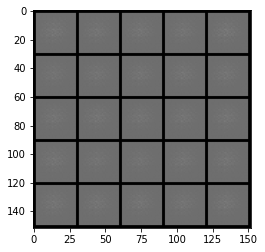

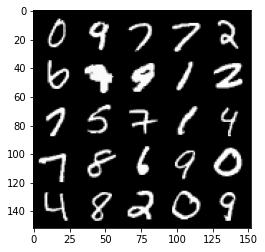

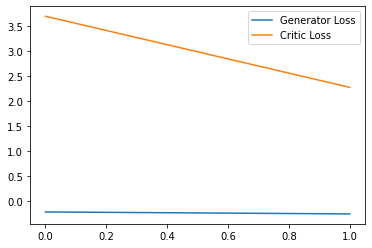

Step 100: Generator loss: 0.5110262261331081, critic loss: -0.7882333256006241


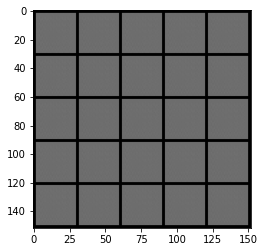

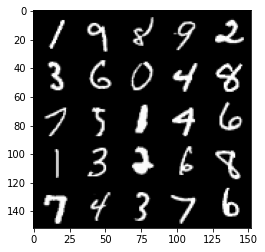

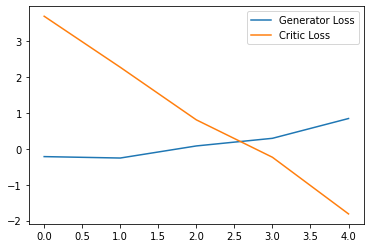

Step 150: Generator loss: 2.9404994797706605, critic loss: -7.986135128021241


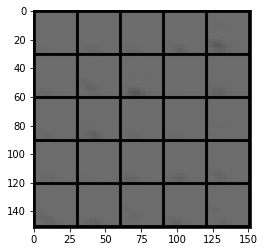

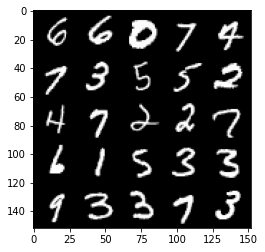

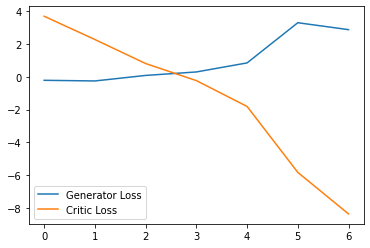

Step 200: Generator loss: 1.2838077565282584, critic loss: -20.69222562789917


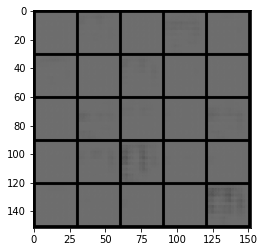

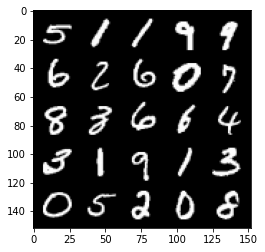

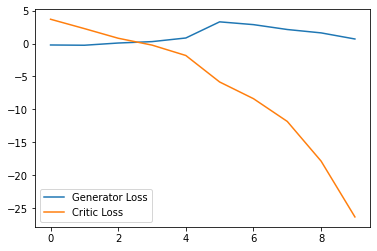

Step 250: Generator loss: -1.13094245955348, critic loss: -45.681935867309576


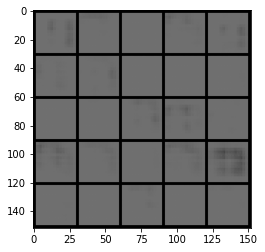

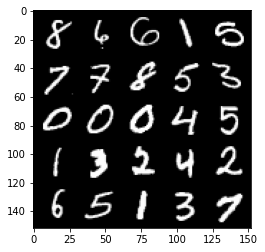

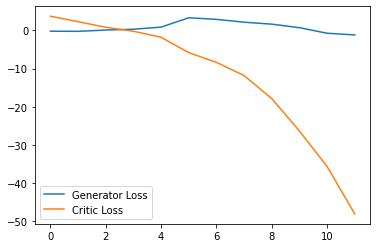

Step 300: Generator loss: -0.5495722261071205, critic loss: -80.9363873901367


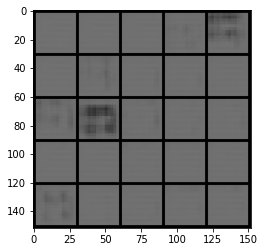

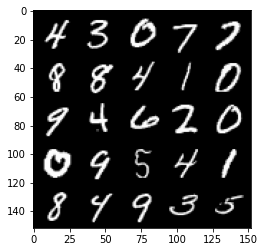

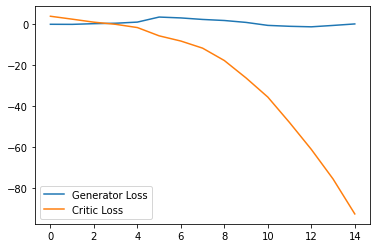

Step 350: Generator loss: 1.1707129925489426, critic loss: -120.07969400024416


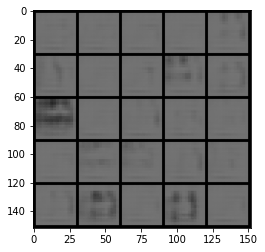

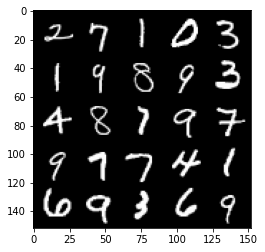

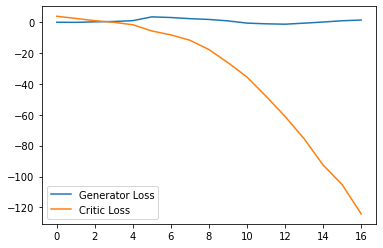

Step 400: Generator loss: 2.417303194999695, critic loss: -161.45124188232424


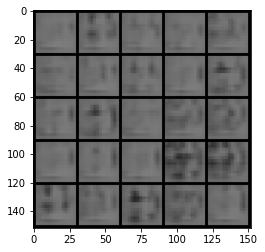

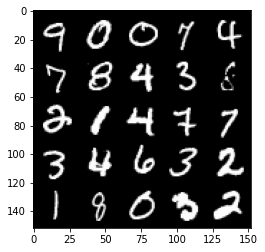

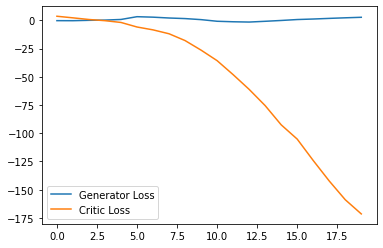

Step 450: Generator loss: 4.836787567138672, critic loss: -203.0144805297852


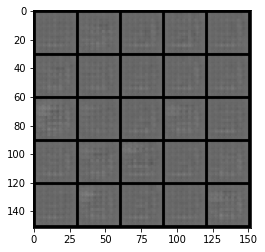

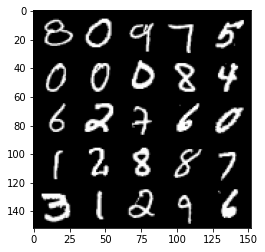

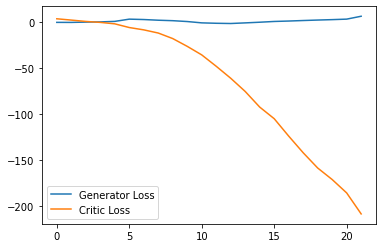

  0%|          | 0/469 [00:00<?, ?it/s]

Step 500: Generator loss: 6.671334238052368, critic loss: -246.0842307434082


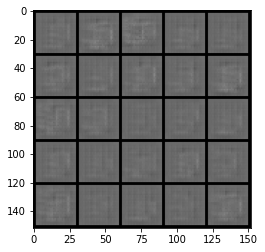

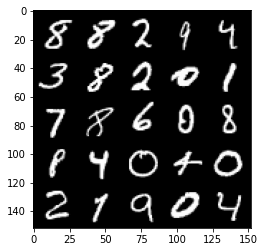

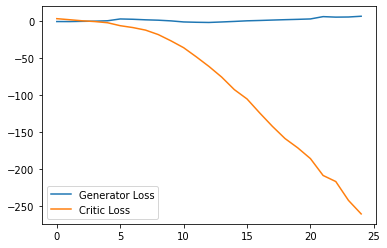

Step 550: Generator loss: 8.585433902740478, critic loss: -296.32810559082037


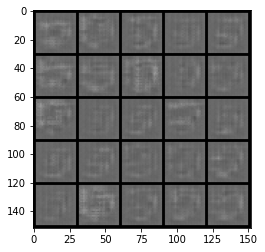

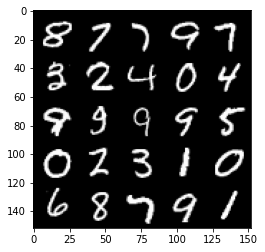

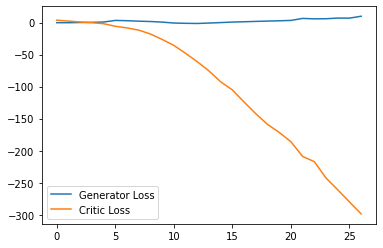

Step 600: Generator loss: 11.158464555740357, critic loss: -336.08143365478514


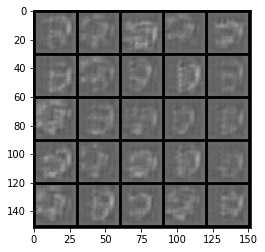

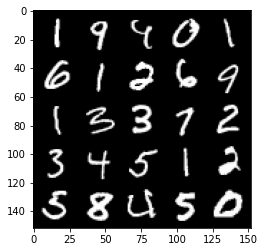

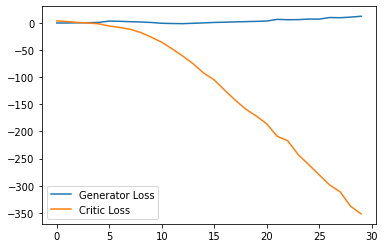

Step 650: Generator loss: -2.242208490371704, critic loss: -349.6319714050294


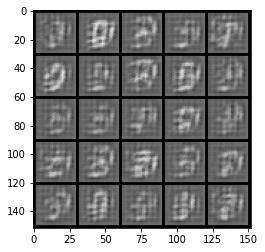

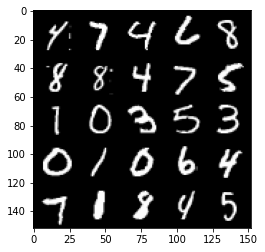

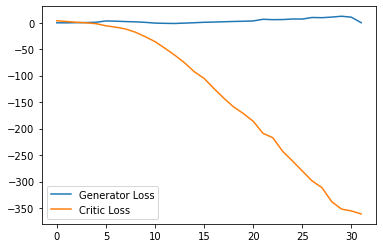

Step 700: Generator loss: -40.38841924786568, critic loss: -276.1775518798828


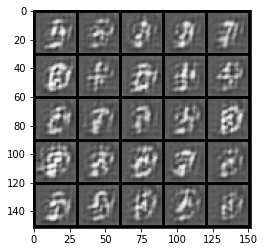

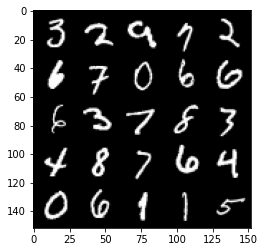

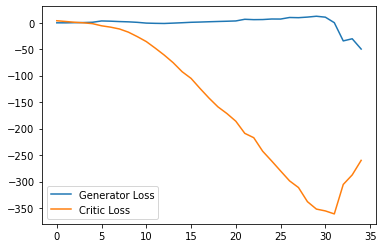

Step 750: Generator loss: -23.93245501637459, critic loss: -239.73597459411624


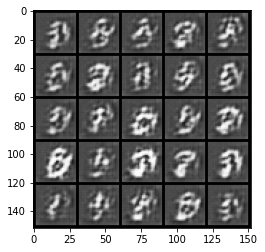

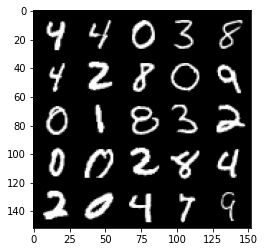

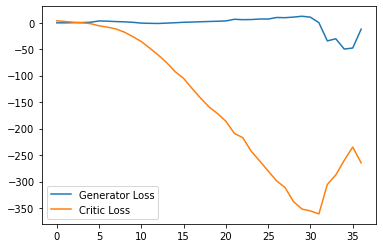

Step 800: Generator loss: -37.44702327728272, critic loss: -177.63810299682623


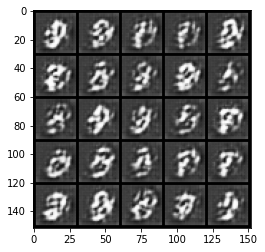

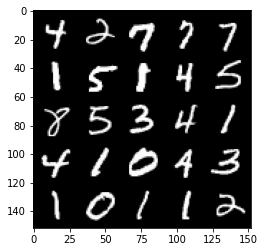

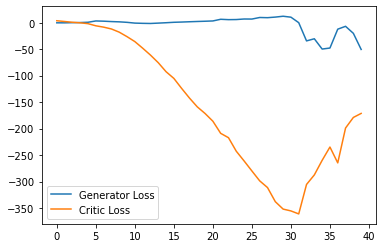

Step 850: Generator loss: 1.9011215096712113, critic loss: 58.92177561187743


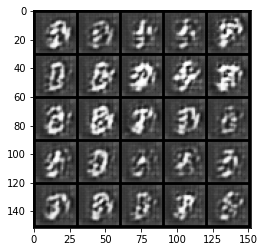

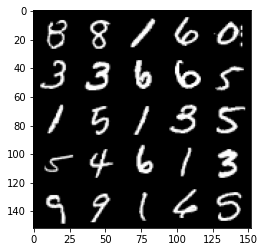

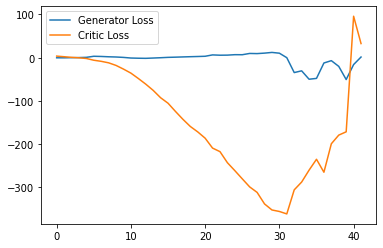

Step 900: Generator loss: 2.974431645870209, critic loss: 19.35076218032837


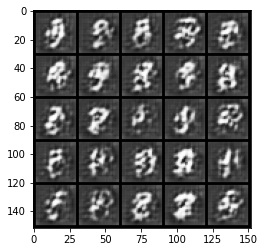

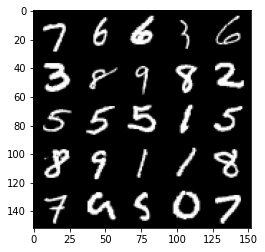

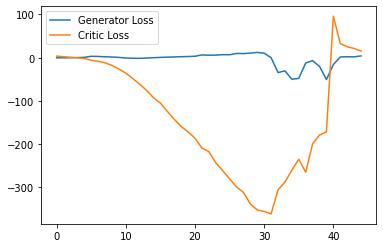

  0%|          | 0/469 [00:00<?, ?it/s]

Step 950: Generator loss: 7.806719665527344, critic loss: 12.872835060119629


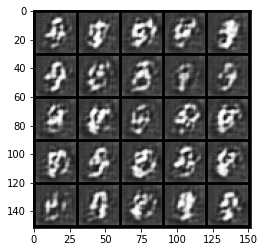

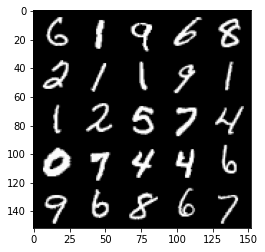

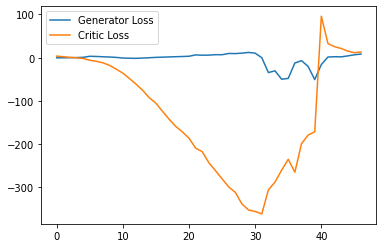

Step 1000: Generator loss: 5.949548804312944, critic loss: 5.85128295135498


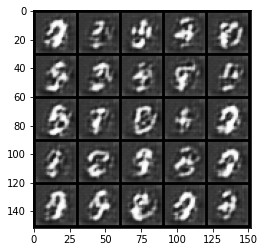

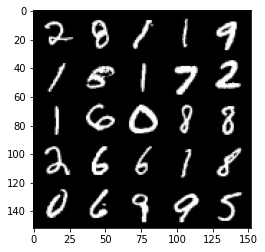

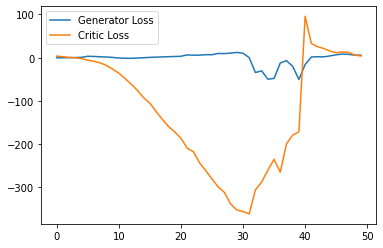

Step 1050: Generator loss: -0.6261559841036797, critic loss: 1.4845651245117188


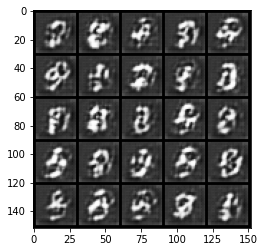

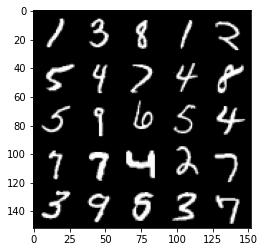

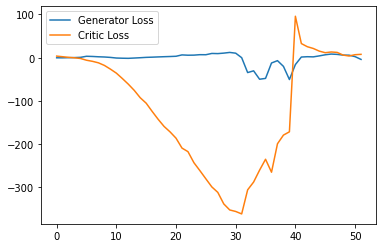

Step 1100: Generator loss: -9.173450613021851, critic loss: -18.527031936645507


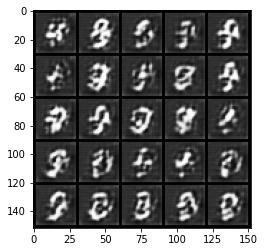

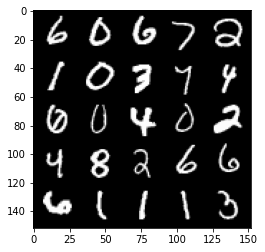

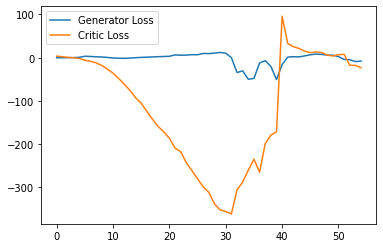

Step 1150: Generator loss: 16.87197759628296, critic loss: 20.831366680145255


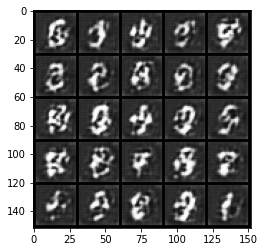

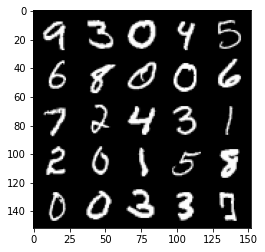

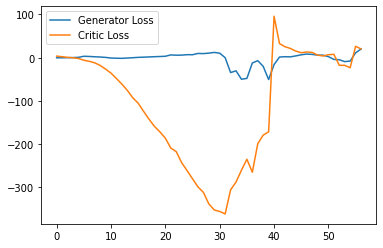

Step 1200: Generator loss: -3.163211877346039, critic loss: -12.802716232299806


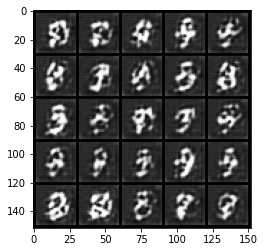

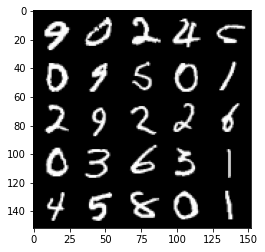

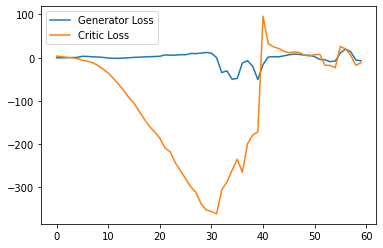

Step 1250: Generator loss: -3.0185318040847777, critic loss: -15.165889953613283


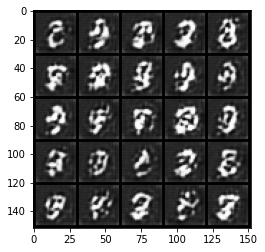

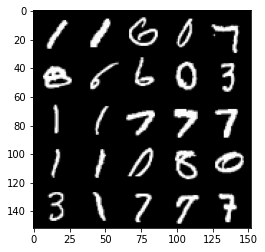

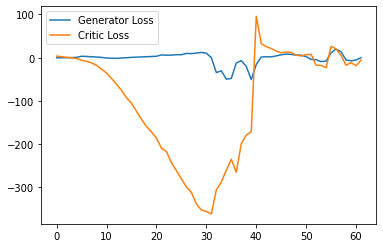

Step 1300: Generator loss: 14.373062251806259, critic loss: 3.831567432403565


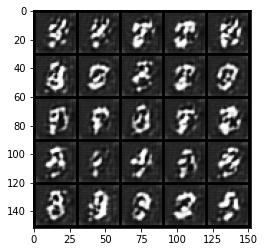

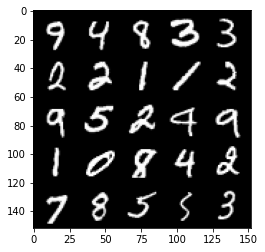

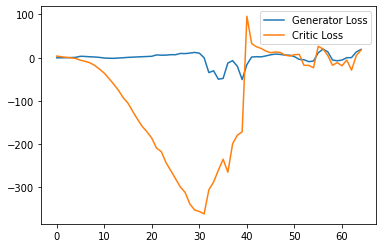

Step 1350: Generator loss: 27.868549156188966, critic loss: 5.502909202575685


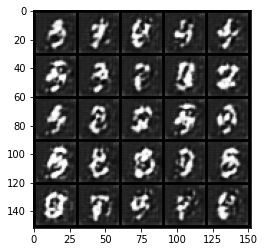

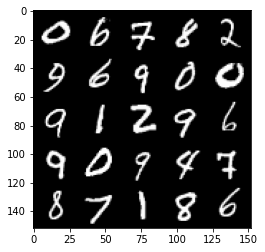

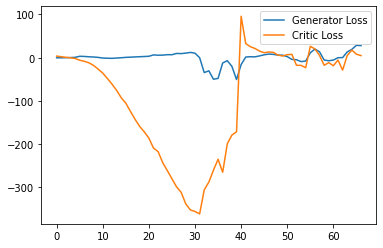

Step 1400: Generator loss: 25.439190139770506, critic loss: 7.701351264953615


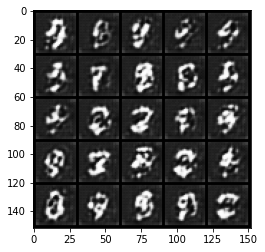

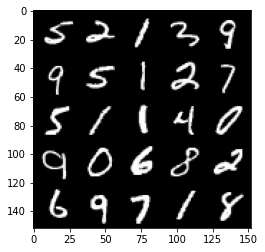

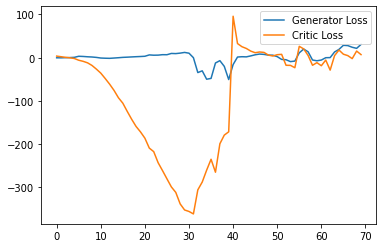

  0%|          | 0/469 [00:00<?, ?it/s]

Step 1450: Generator loss: 30.851360054016112, critic loss: 3.833347393035888


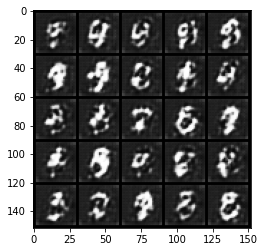

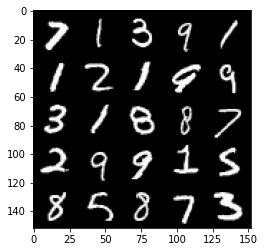

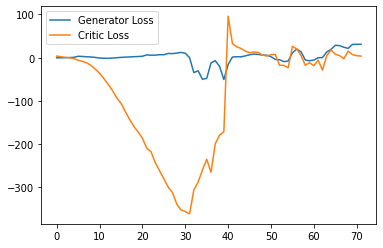

Step 1500: Generator loss: 27.555081939697267, critic loss: -4.7045728225708


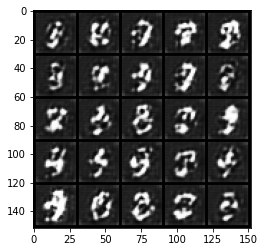

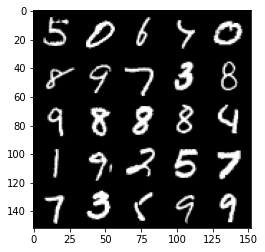

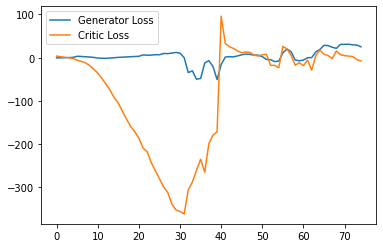

Step 1550: Generator loss: 30.521324043273925, critic loss: -3.1949753131866445


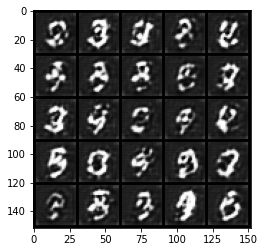

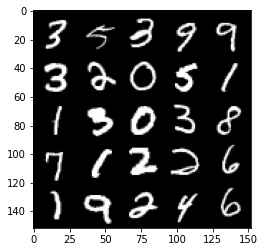

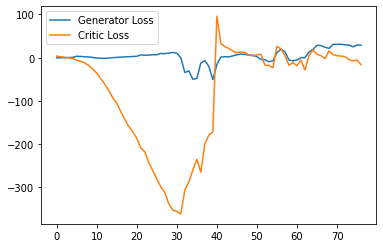

Step 1600: Generator loss: 37.171689682006836, critic loss: 5.133032114028931


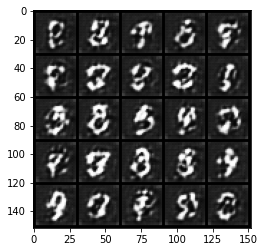

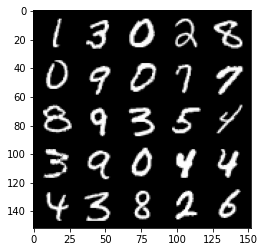

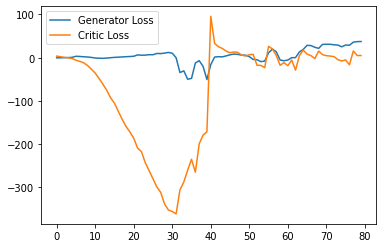

Step 1650: Generator loss: 37.360998992919924, critic loss: 3.023637094497681


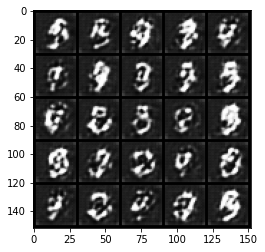

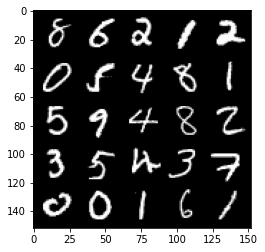

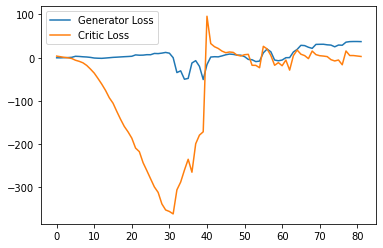

Step 1700: Generator loss: 38.16451629638672, critic loss: 0.23649503326416016


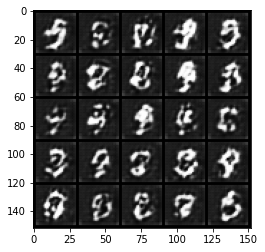

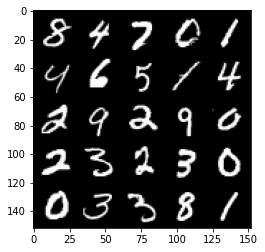

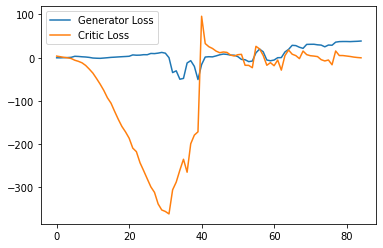

Step 1750: Generator loss: 39.880411529541014, critic loss: -1.2001298017501831


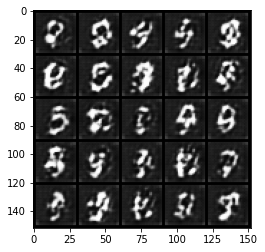

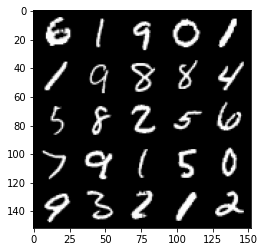

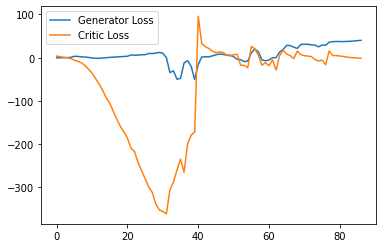

Step 1800: Generator loss: 40.88478820800781, critic loss: -3.3634785842895503


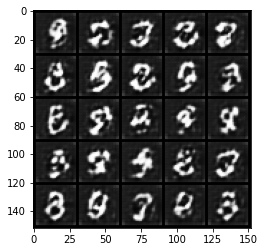

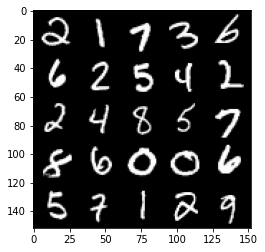

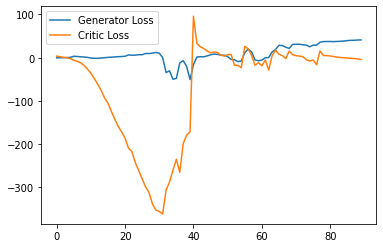

Step 1850: Generator loss: 40.884007949829105, critic loss: -7.800220008850097


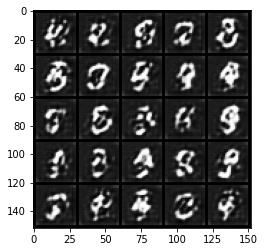

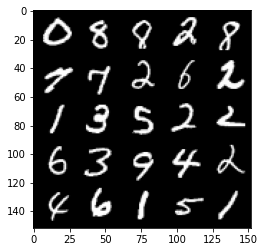

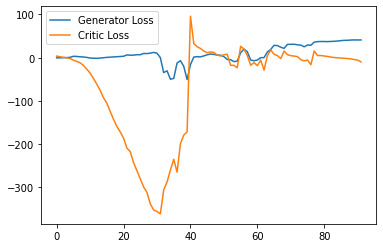

  0%|          | 0/469 [00:00<?, ?it/s]

Step 1900: Generator loss: 43.97067276000976, critic loss: -4.156888439178467


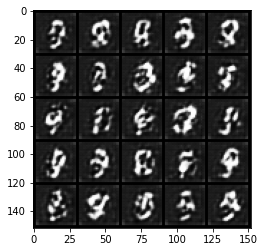

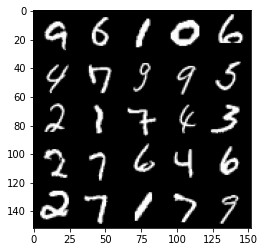

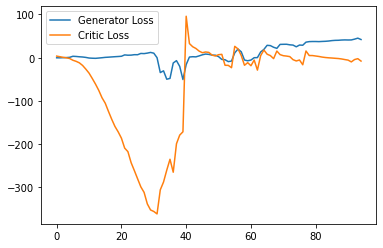

Step 1950: Generator loss: 40.95997215270996, critic loss: -9.88846198749542


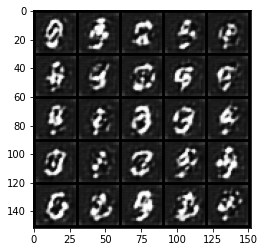

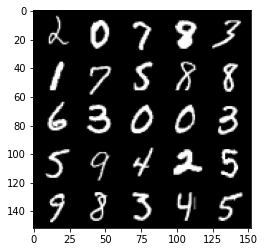

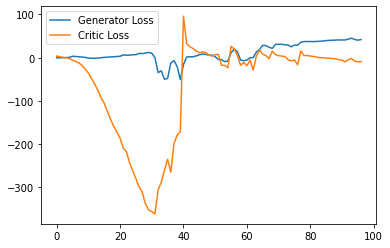

Step 2000: Generator loss: 43.833058471679685, critic loss: -10.543538296699523


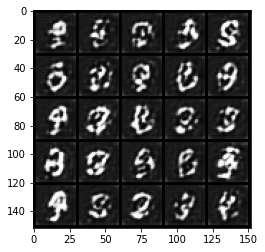

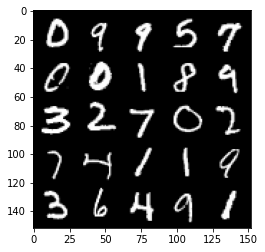

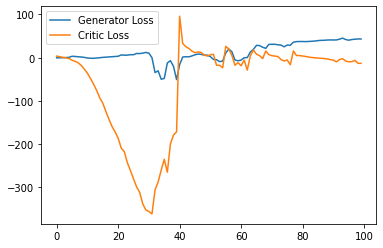

Step 2050: Generator loss: 43.82721885681153, critic loss: -12.374183821201324


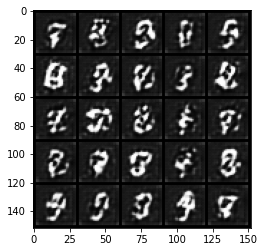

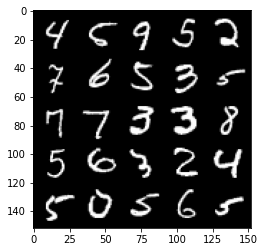

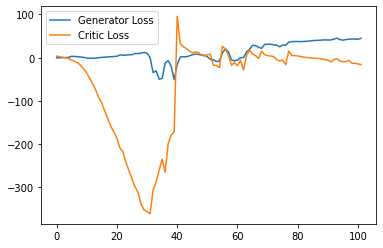

Step 2100: Generator loss: 50.48559707641601, critic loss: -1.8684067587852473


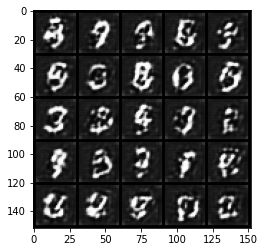

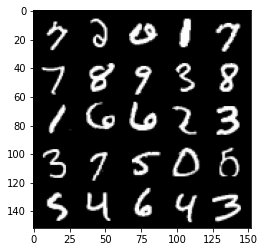

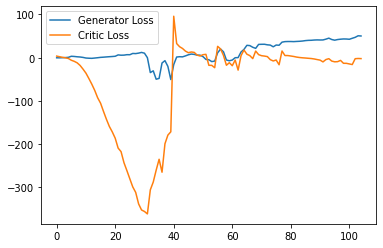

Step 2150: Generator loss: 49.450937271118164, critic loss: -2.536004152297973


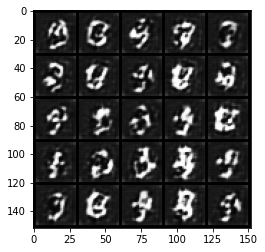

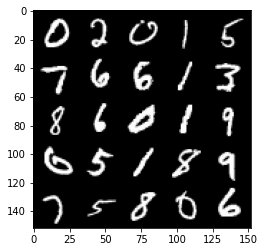

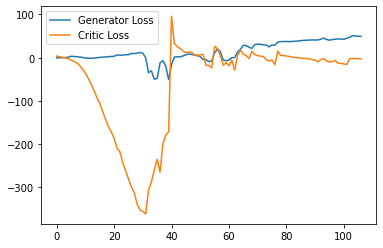

Step 2200: Generator loss: 47.435178146362304, critic loss: -5.454258784294129


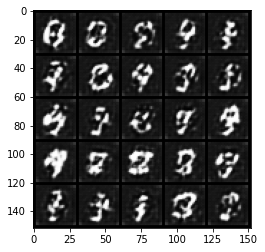

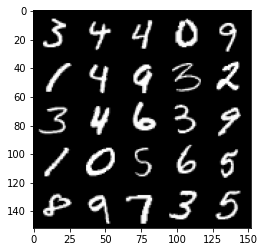

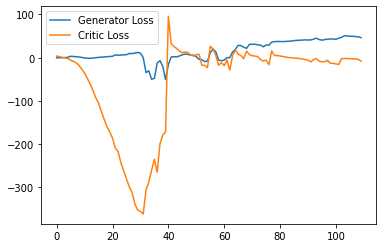

Step 2250: Generator loss: 44.13394515991211, critic loss: -14.506308153152466


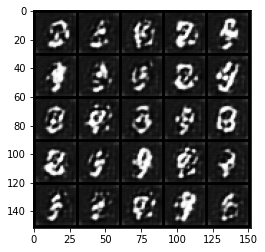

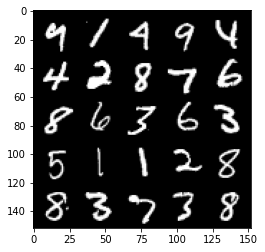

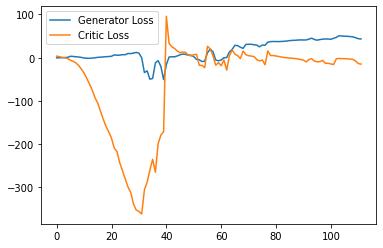

Step 2300: Generator loss: 47.98572563171387, critic loss: -11.95333221626282


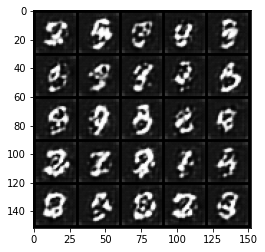

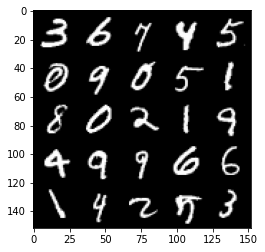

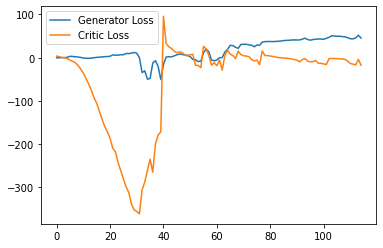

  0%|          | 0/469 [00:00<?, ?it/s]

Step 2350: Generator loss: 49.40731010437012, critic loss: -12.637671855926515


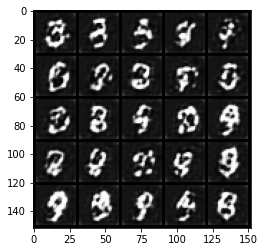

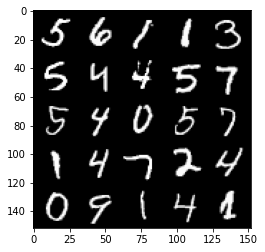

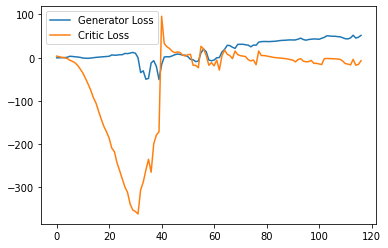

Step 2400: Generator loss: 49.03843223571777, critic loss: -17.379457263946527


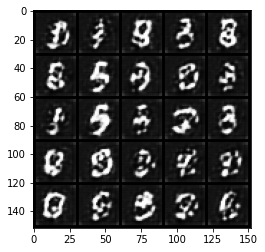

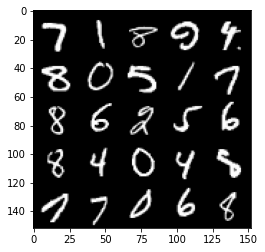

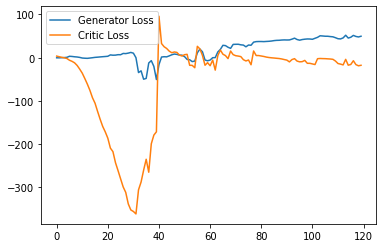

Step 2450: Generator loss: 55.60724800109863, critic loss: -2.7395391998291014


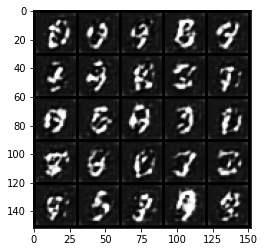

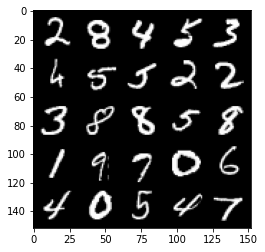

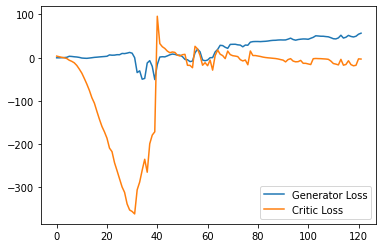

Step 2500: Generator loss: 49.662562713623046, critic loss: -15.576172843933112


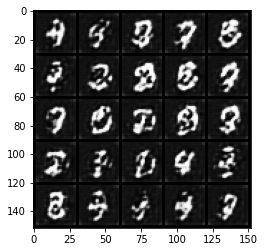

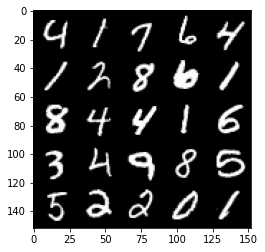

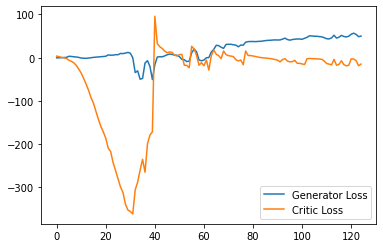

Step 2550: Generator loss: 52.316888427734376, critic loss: -17.040013805389407


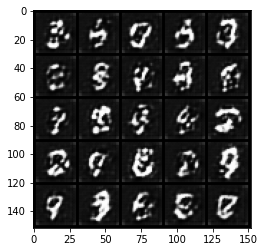

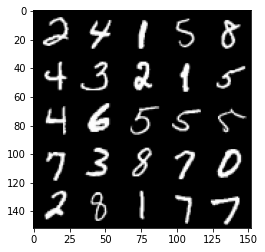

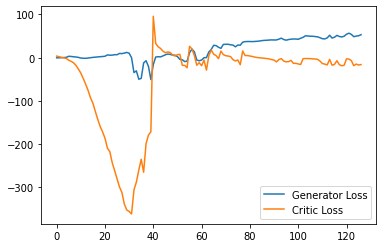

Step 2600: Generator loss: 53.46943141937256, critic loss: -14.590811795234679


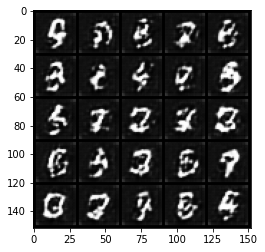

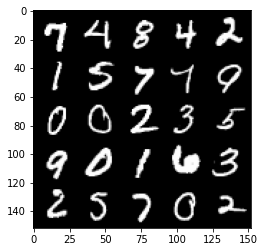

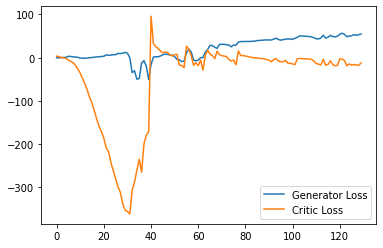

Step 2650: Generator loss: 59.05849342346191, critic loss: -9.08378063774109


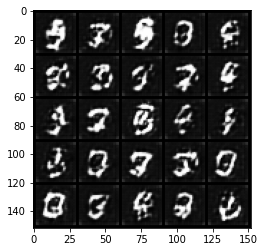

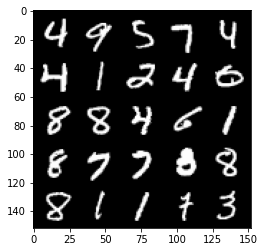

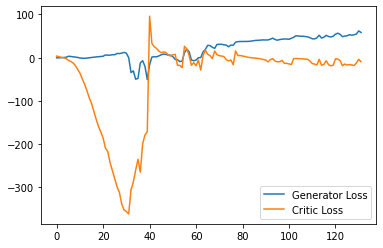

Step 2700: Generator loss: 56.978982009887694, critic loss: -12.961259551048277


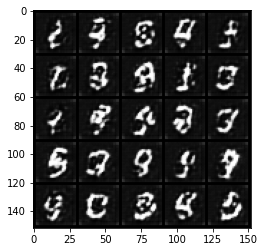

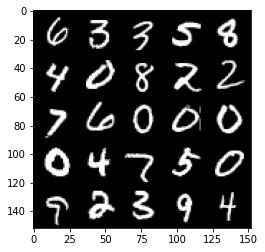

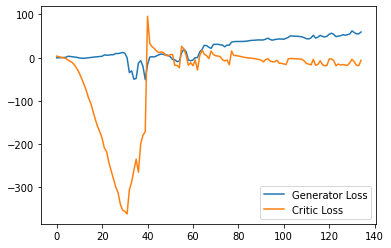

Step 2750: Generator loss: 61.021030807495116, critic loss: -7.582873943328858


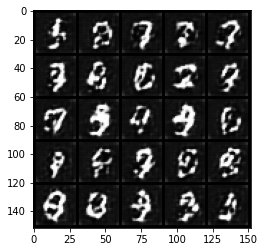

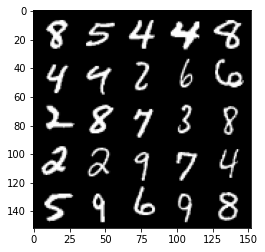

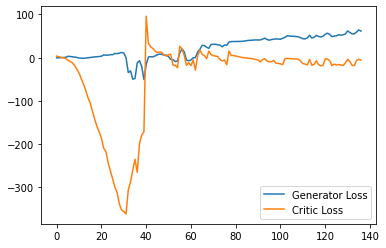

Step 2800: Generator loss: 60.17041687011719, critic loss: -8.687995699882508


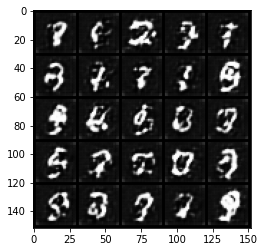

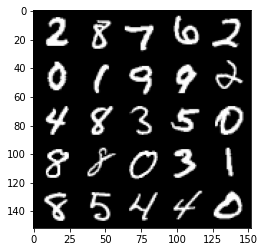

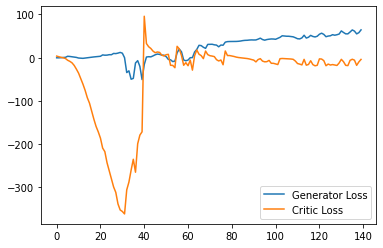

  0%|          | 0/469 [00:00<?, ?it/s]

Step 2850: Generator loss: 58.46769561767578, critic loss: -14.785967773437498


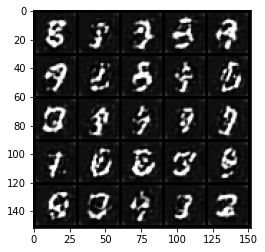

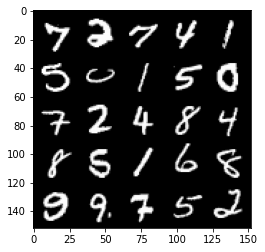

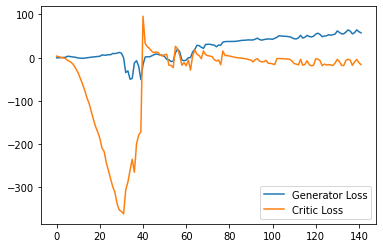

Step 2900: Generator loss: 58.27143783569336, critic loss: -17.290312512397765


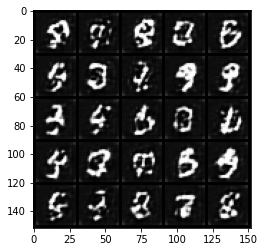

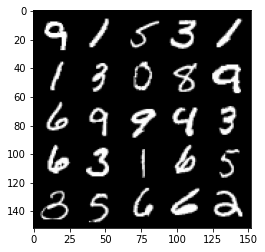

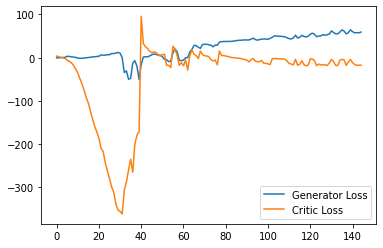

Step 2950: Generator loss: 61.96184684753418, critic loss: -12.899474847793574


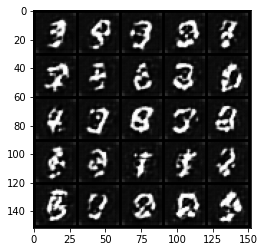

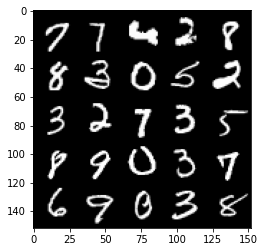

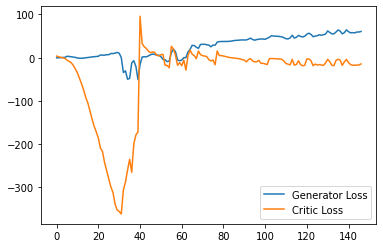

Step 3000: Generator loss: 63.04919662475586, critic loss: -9.847848571777343


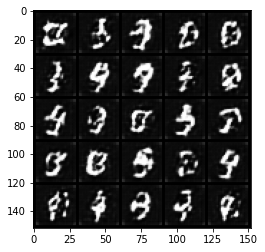

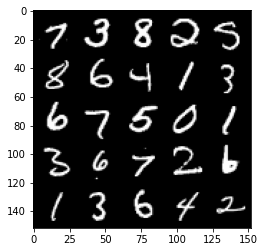

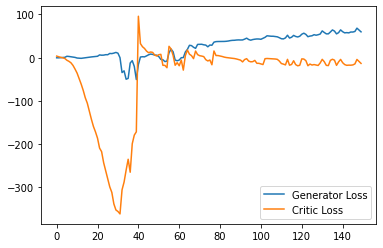

Step 3050: Generator loss: 59.960292434692384, critic loss: -17.35520957279205


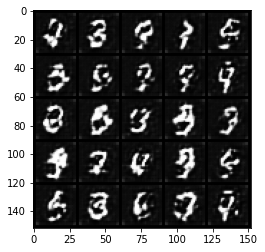

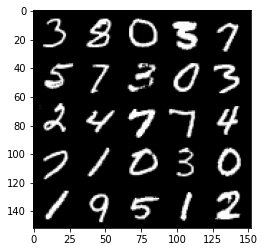

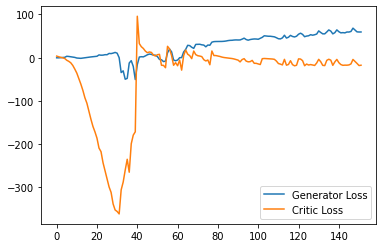

Step 3100: Generator loss: 62.17970588684082, critic loss: -9.55210227870941


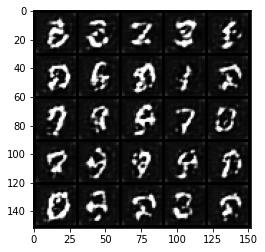

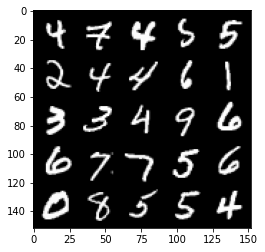

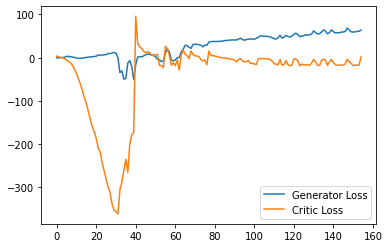

Step 3150: Generator loss: 66.6886457824707, critic loss: -3.234906575202942


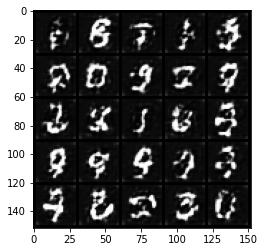

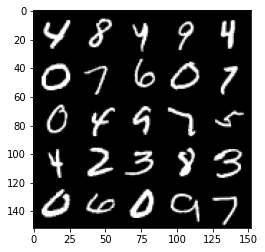

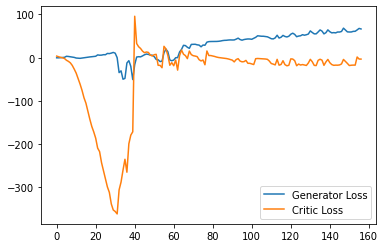

Step 3200: Generator loss: 62.96151962280273, critic loss: -4.244710515022278


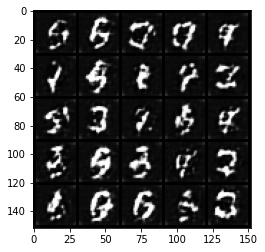

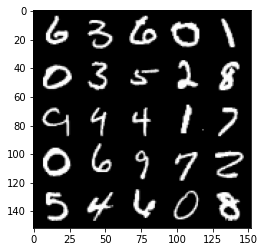

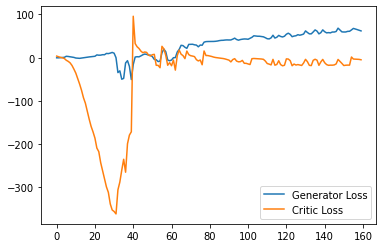

Step 3250: Generator loss: 58.30208641052246, critic loss: -14.935544123172761


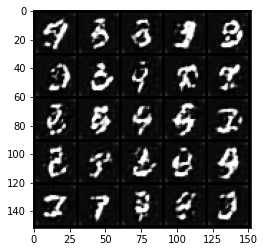

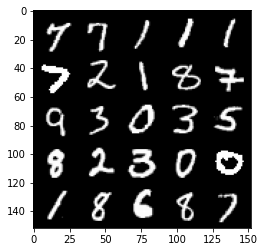

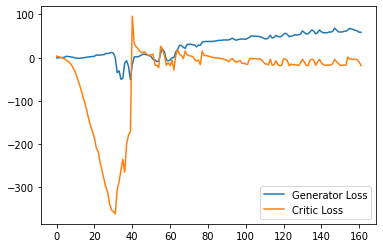

  0%|          | 0/469 [00:00<?, ?it/s]

Step 3300: Generator loss: 59.497541732788086, critic loss: -13.369610828876498


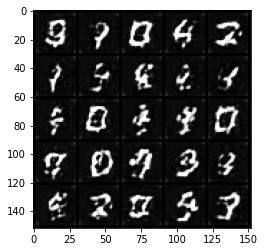

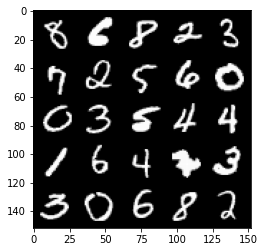

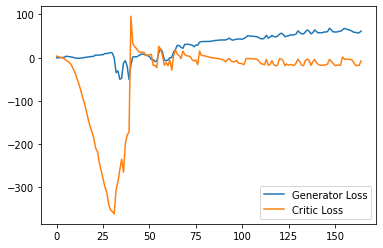

Step 3350: Generator loss: 68.4255842590332, critic loss: -3.1367327470779425


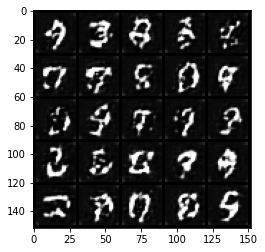

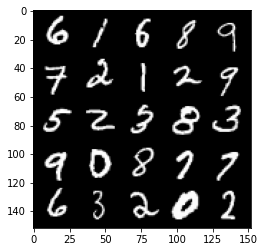

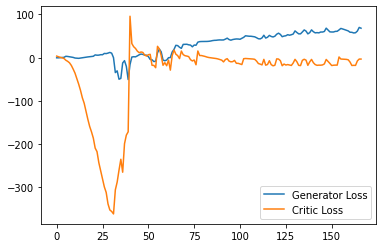

Step 3400: Generator loss: 64.83256340026855, critic loss: -3.5273725309371953


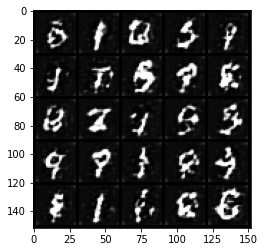

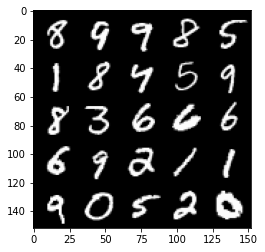

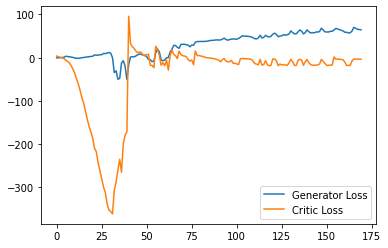

Step 3450: Generator loss: 59.89731063842773, critic loss: -11.96548695373535


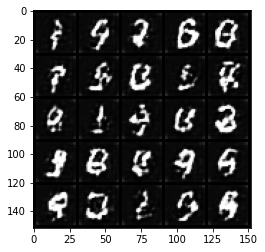

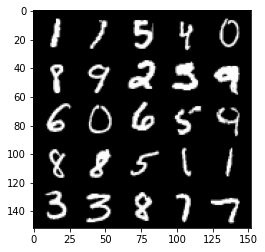

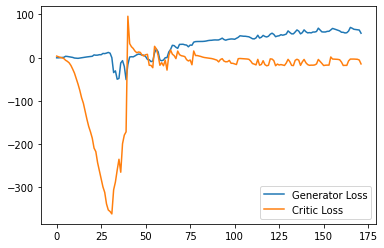

Step 3500: Generator loss: 61.647863159179686, critic loss: -12.718351321697233


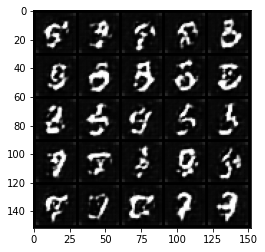

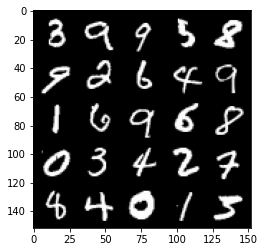

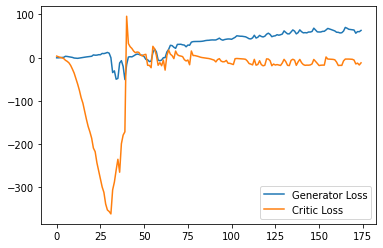

Step 3550: Generator loss: 61.931729583740236, critic loss: -15.043460297584538


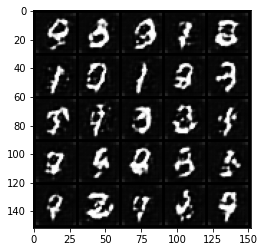

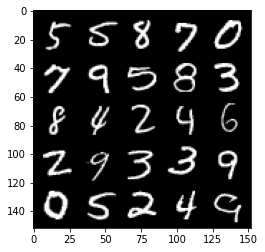

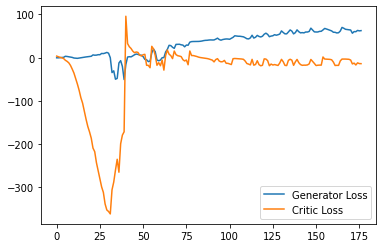

Step 3600: Generator loss: 68.91298568725585, critic loss: -1.3307038035392755


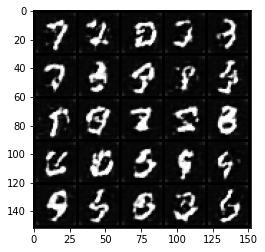

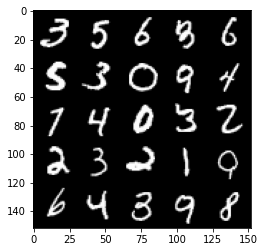

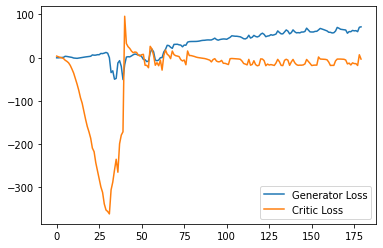

Step 3650: Generator loss: 67.53646606445312, critic loss: -2.9488745193481454


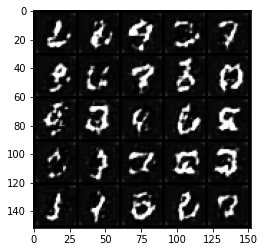

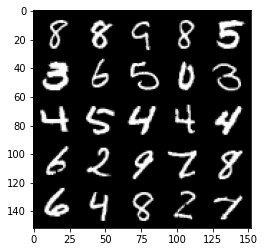

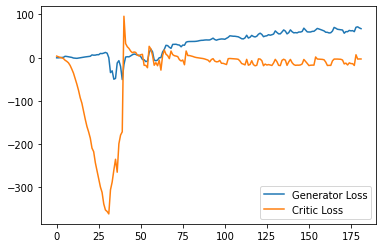

Step 3700: Generator loss: 66.10722518920899, critic loss: -3.095199255943299


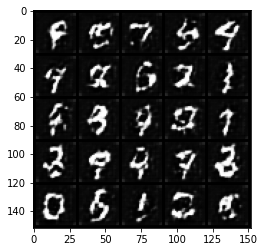

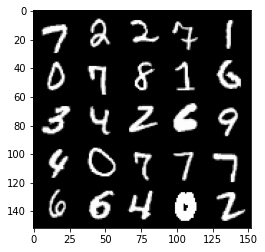

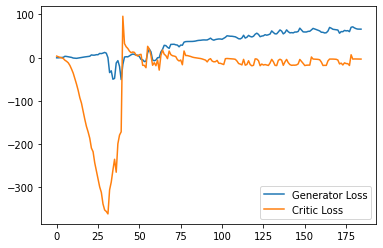

Step 3750: Generator loss: 66.26636459350586, critic loss: -3.503575948715211


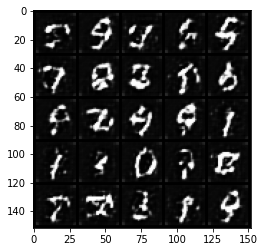

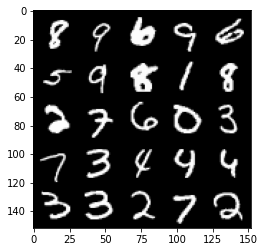

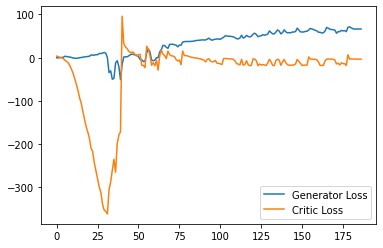

  0%|          | 0/469 [00:00<?, ?it/s]

Step 3800: Generator loss: 66.2914714050293, critic loss: -2.9583874711990363


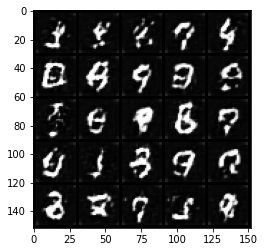

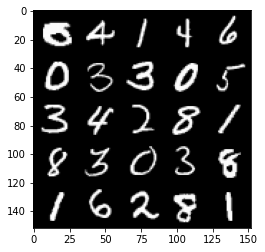

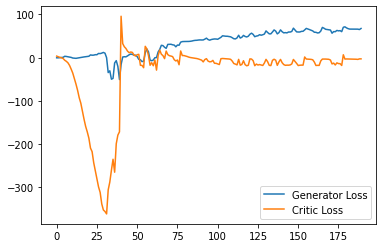

Step 3850: Generator loss: 63.8326025390625, critic loss: -9.032128079414367


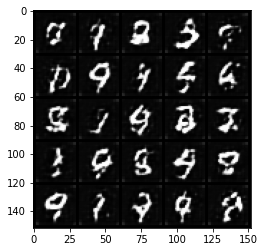

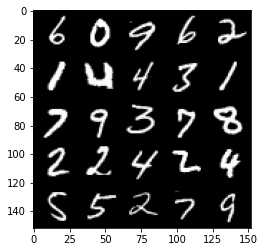

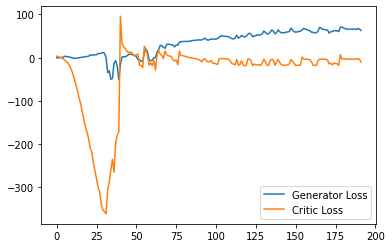

Step 3900: Generator loss: 62.5987939453125, critic loss: -17.187189858913424


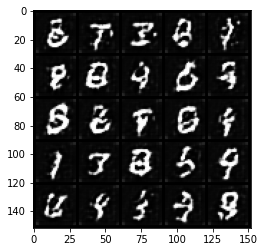

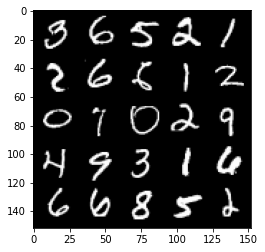

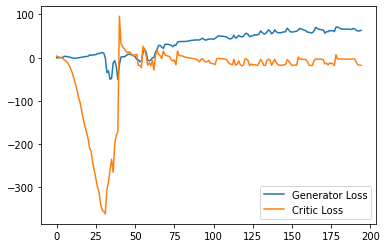

Step 3950: Generator loss: 63.70636268615723, critic loss: -13.936524888038635


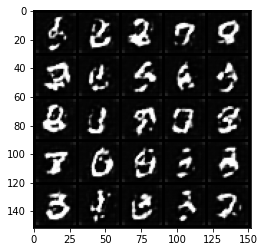

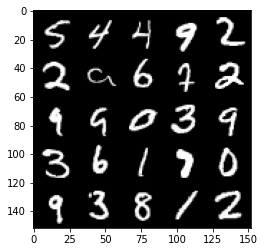

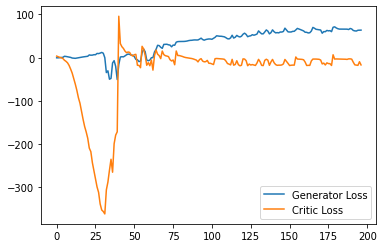

Step 4000: Generator loss: 64.4029866027832, critic loss: -16.970089921951285


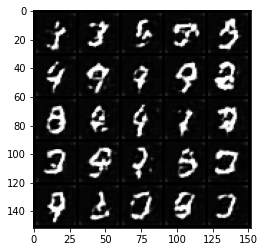

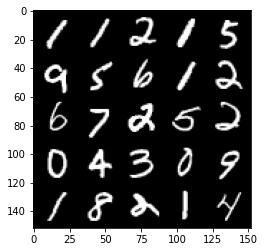

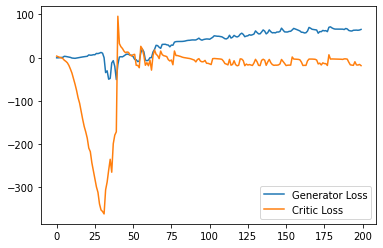

Step 4050: Generator loss: 65.69789505004883, critic loss: -13.222018075942993


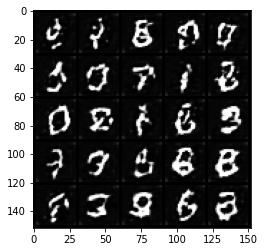

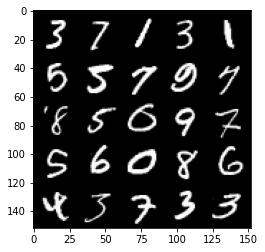

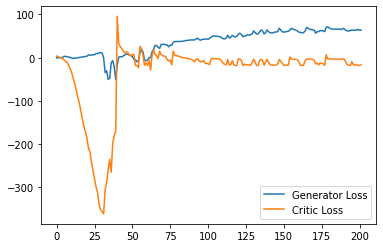

Step 4100: Generator loss: 68.0758723449707, critic loss: -14.596376667976381


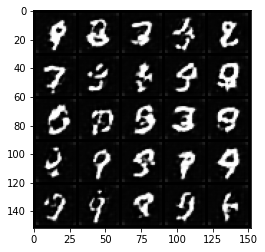

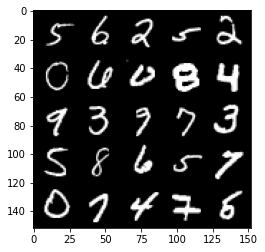

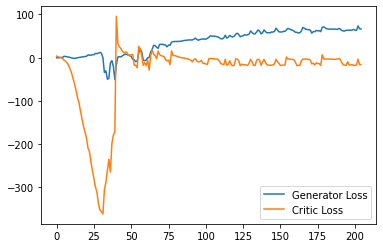

Step 4150: Generator loss: 68.63964874267577, critic loss: -15.378747288227082


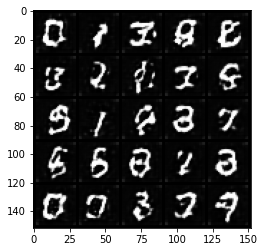

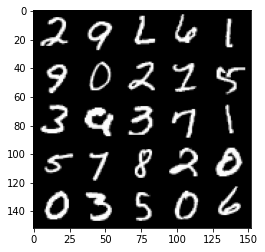

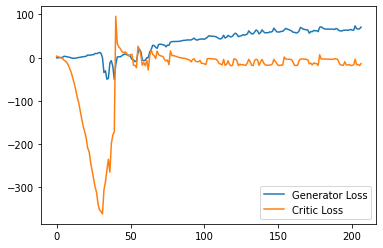

Step 4200: Generator loss: 71.49780906677246, critic loss: -6.397310253620149


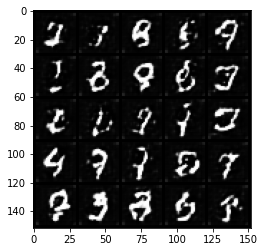

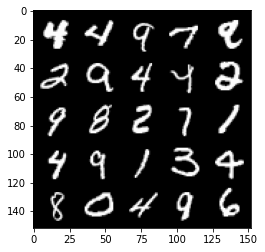

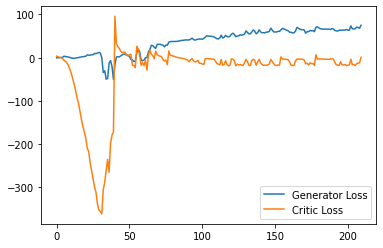

  0%|          | 0/469 [00:00<?, ?it/s]

Step 4250: Generator loss: 74.10513778686523, critic loss: -2.8083970766067505


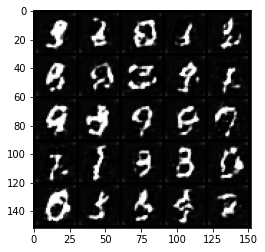

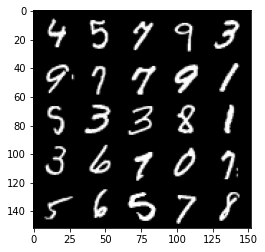

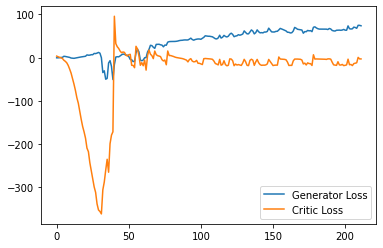

Step 4300: Generator loss: 70.73507598876954, critic loss: -2.9262377586364736


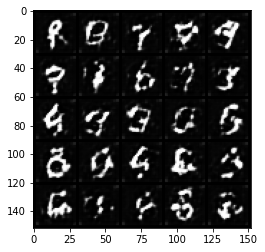

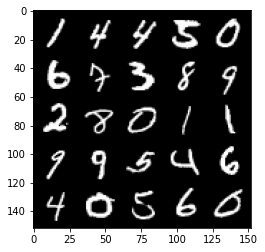

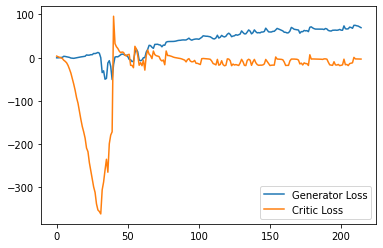

Step 4350: Generator loss: 66.26938148498535, critic loss: -10.506346422195437


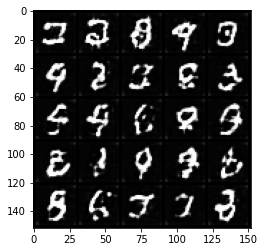

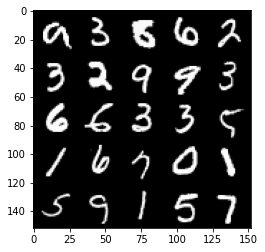

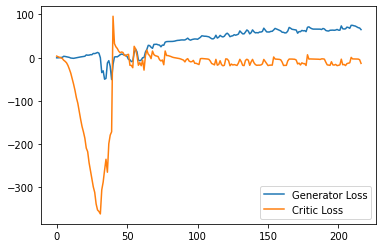

Step 4400: Generator loss: 67.83490669250489, critic loss: -11.222229044914243


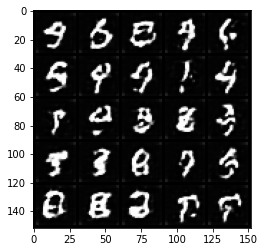

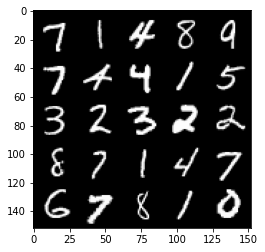

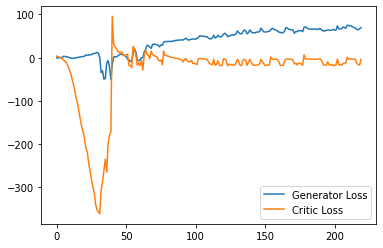

Step 4450: Generator loss: 75.60076293945312, critic loss: -3.0086595716476445


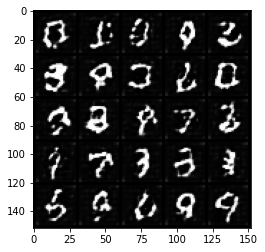

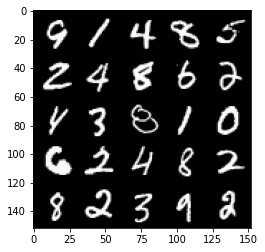

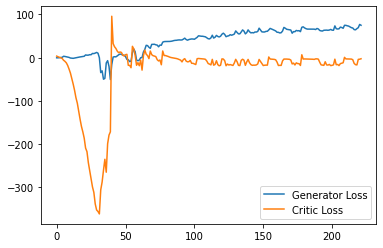

Step 4500: Generator loss: 75.17791442871093, critic loss: -3.4160111007690444


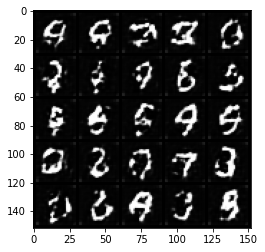

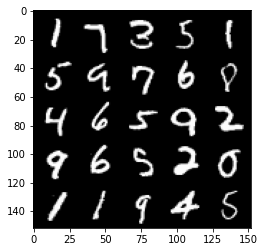

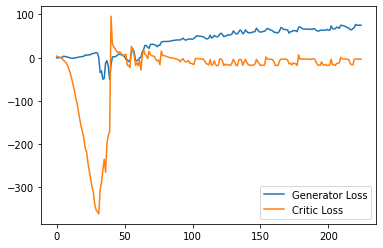

Step 4550: Generator loss: 72.84158584594726, critic loss: -3.862453314781189


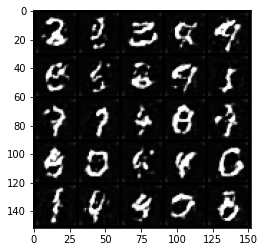

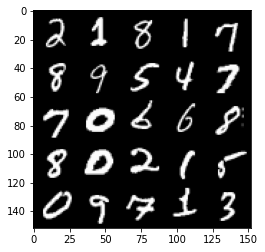

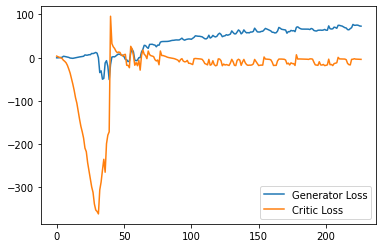

Step 4600: Generator loss: 67.94141967773437, critic loss: -10.068478866577147


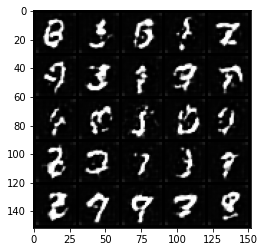

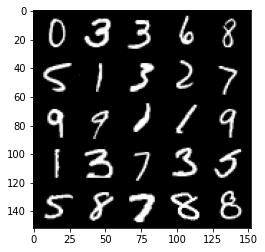

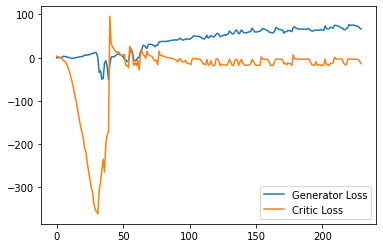

Step 4650: Generator loss: 69.85899791717529, critic loss: -6.986299807071685


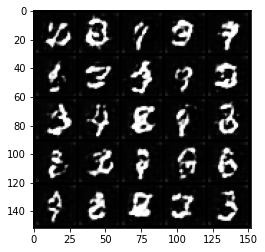

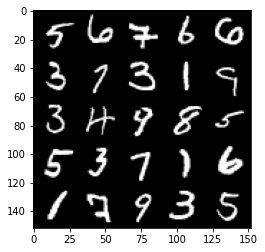

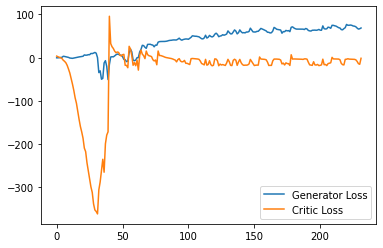

  0%|          | 0/469 [00:00<?, ?it/s]

Step 4700: Generator loss: 69.6998599243164, critic loss: -2.8047480411529544


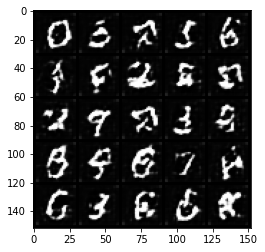

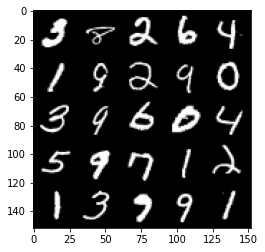

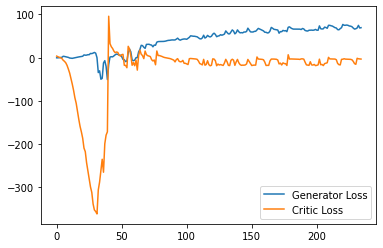

Step 4750: Generator loss: 69.4854522705078, critic loss: -4.890532081604005


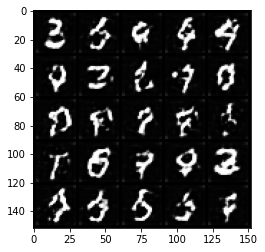

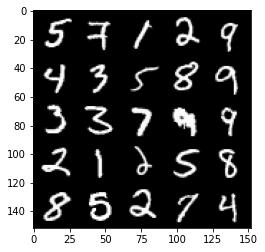

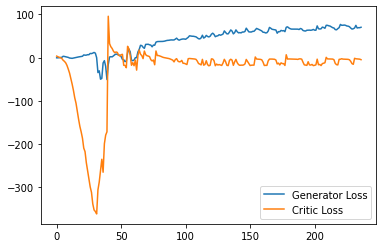

Step 4800: Generator loss: 64.70694358825683, critic loss: -14.456912851095193


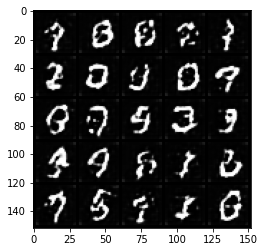

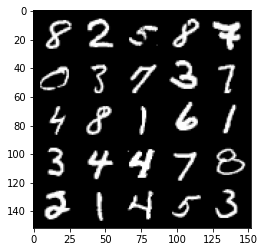

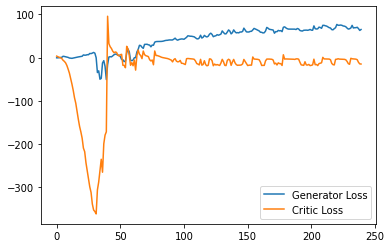

Step 4850: Generator loss: 68.08253555297851, critic loss: -14.477270639419554


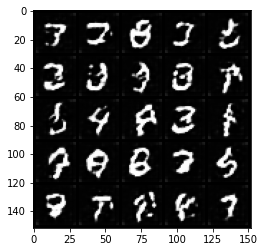

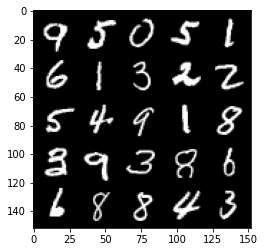

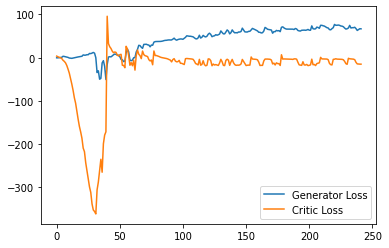

Step 4900: Generator loss: 70.05817817687988, critic loss: -15.0753256521225


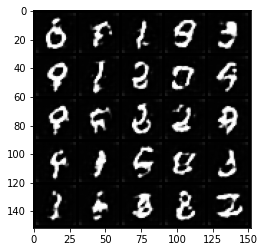

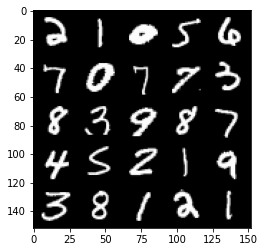

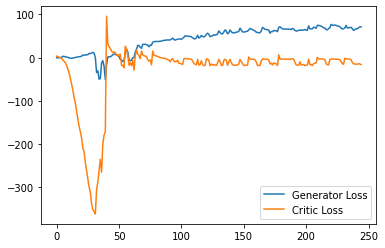

Step 4950: Generator loss: 70.49983749389648, critic loss: -14.859755801200865


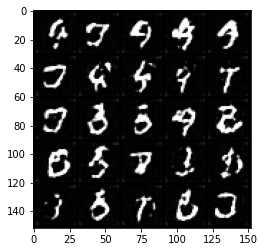

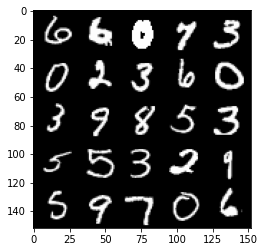

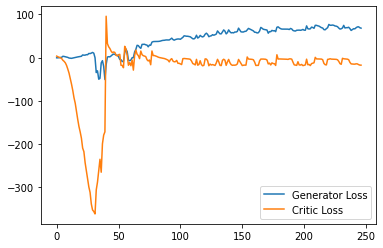

Step 5000: Generator loss: 71.63132446289063, critic loss: -14.268302882194519


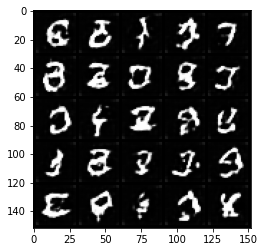

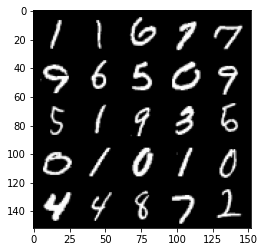

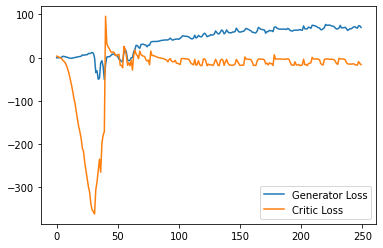

Step 5050: Generator loss: 73.4499234008789, critic loss: -9.205243478536605


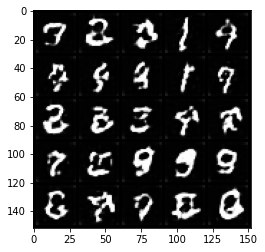

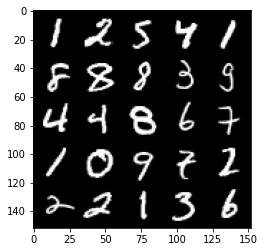

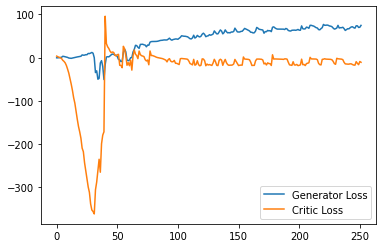

Step 5100: Generator loss: 74.30515113830566, critic loss: -10.50685383415222


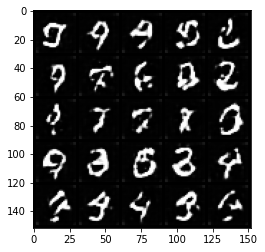

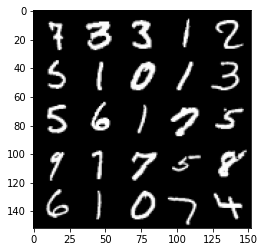

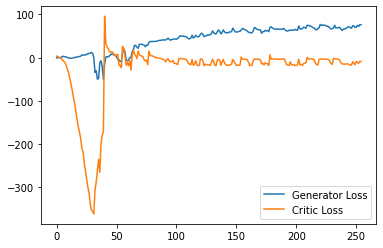

Step 5150: Generator loss: 71.08283477783203, critic loss: -14.016272188186647


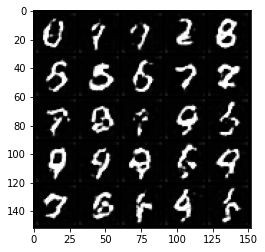

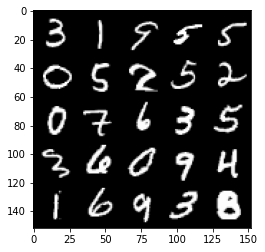

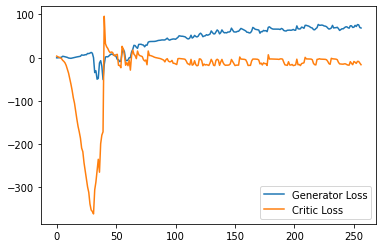

  0%|          | 0/469 [00:00<?, ?it/s]

Step 5200: Generator loss: 73.618232421875, critic loss: -13.613131542205807


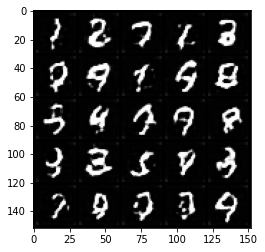

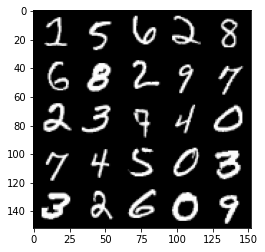

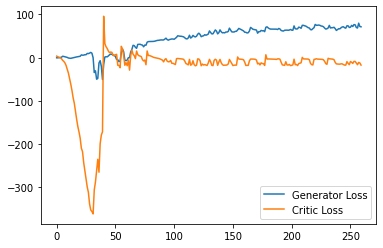

Step 5250: Generator loss: 72.73107147216797, critic loss: -15.487148505210877


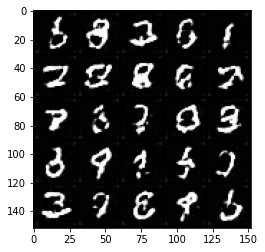

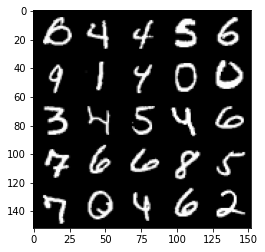

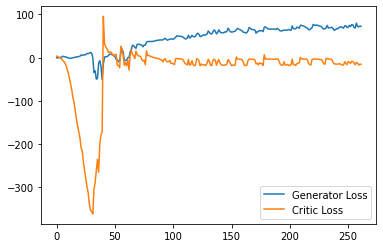

Step 5300: Generator loss: 71.7528897857666, critic loss: -16.63296284198761


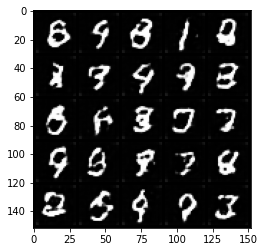

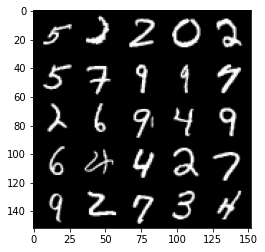

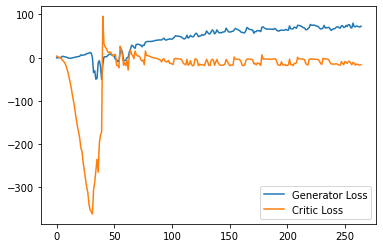

Step 5350: Generator loss: 76.18869728088379, critic loss: -3.7845777621269248


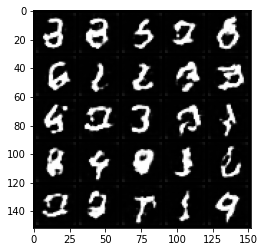

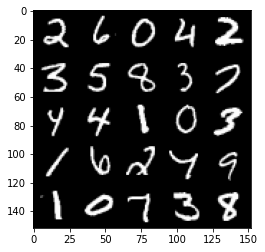

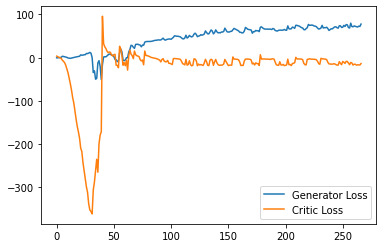

Step 5400: Generator loss: 82.49282745361329, critic loss: -3.8890177822113032


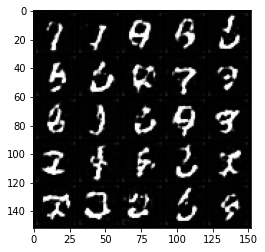

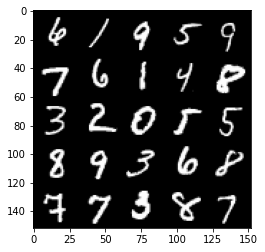

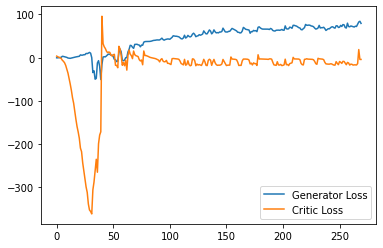

Step 5450: Generator loss: 78.26835189819336, critic loss: -3.5583958684206016


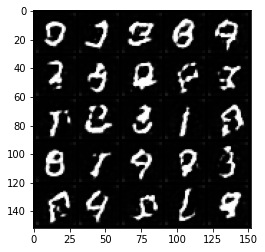

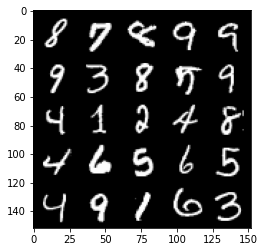

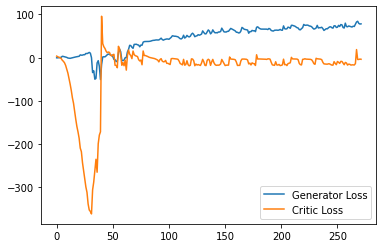

Step 5500: Generator loss: 78.29535034179688, critic loss: -5.436233395576477


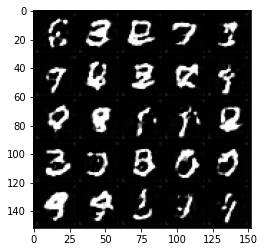

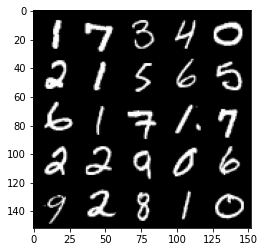

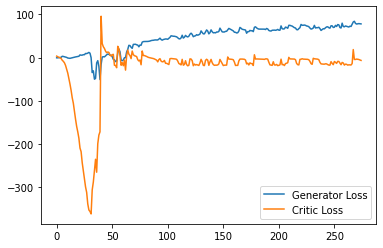

Step 5550: Generator loss: 77.42190948486328, critic loss: -6.389331462383268


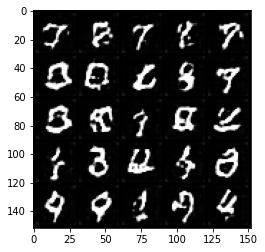

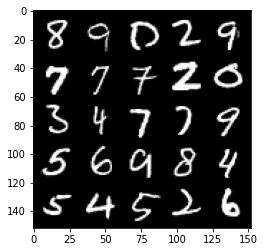

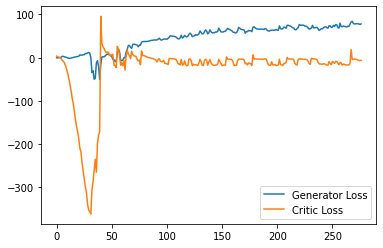

Step 5600: Generator loss: 76.60424468994141, critic loss: -9.398613590240478


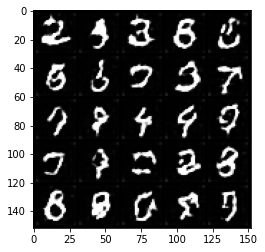

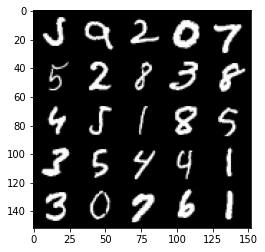

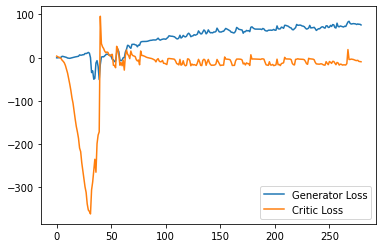

  0%|          | 0/469 [00:00<?, ?it/s]

Step 5650: Generator loss: 77.19683746337891, critic loss: -10.21196334052086


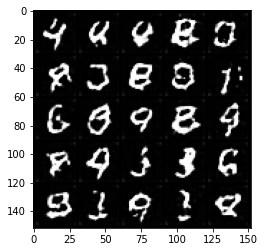

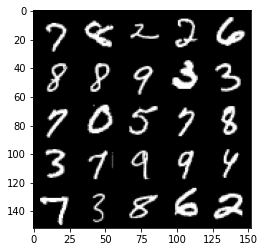

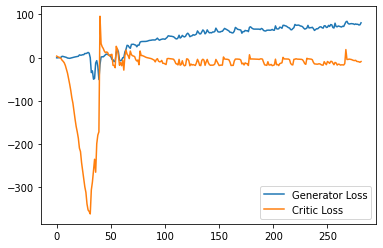

Step 5700: Generator loss: 75.98222312927246, critic loss: -9.889695189237594


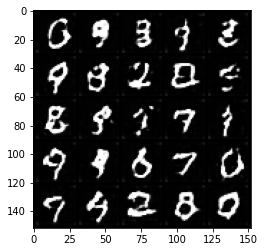

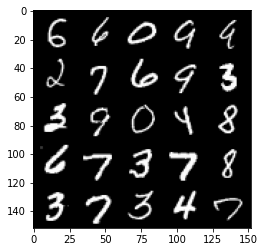

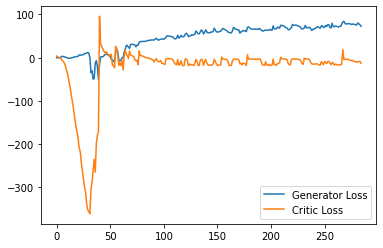

Step 5750: Generator loss: 76.27805419921874, critic loss: -10.075036221027373


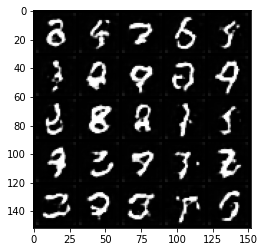

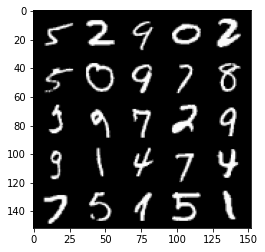

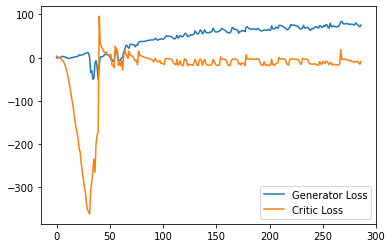

Step 5800: Generator loss: 76.64790252685548, critic loss: -12.418809056282038


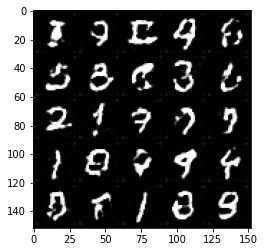

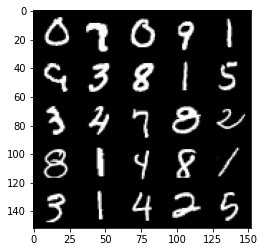

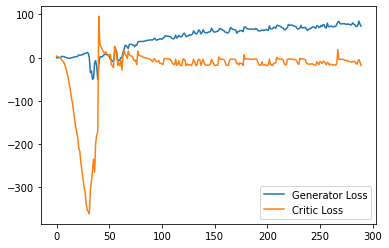

Step 5850: Generator loss: 74.77645317077636, critic loss: -15.933988426208492


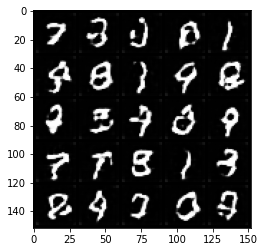

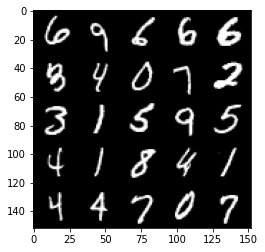

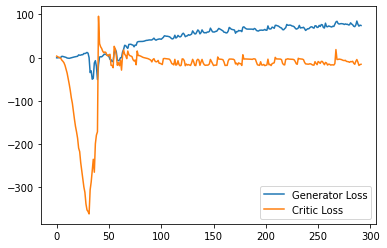

Step 5900: Generator loss: 76.34213668823242, critic loss: -14.693370755195618


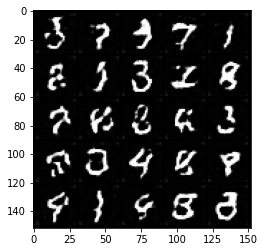

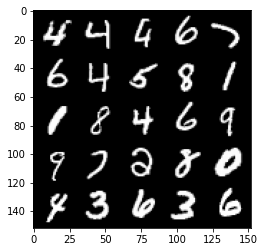

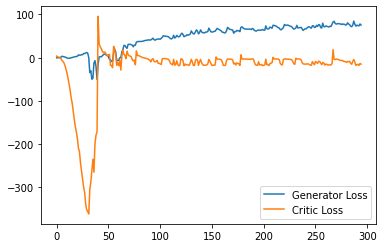

Step 5950: Generator loss: 79.15226806640625, critic loss: -12.448272006511683


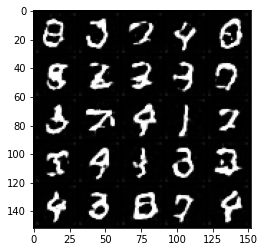

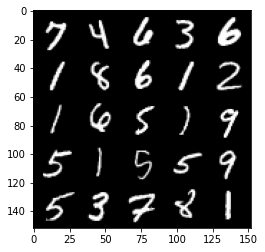

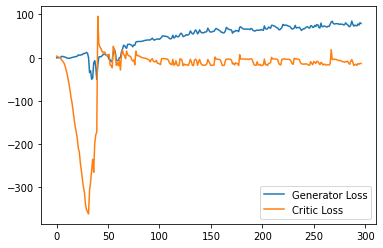

Step 6000: Generator loss: 82.72903259277344, critic loss: -2.617293610572815


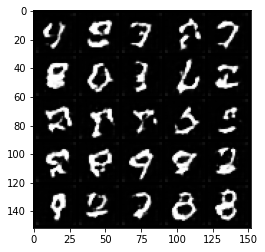

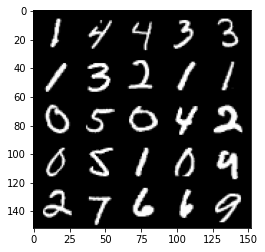

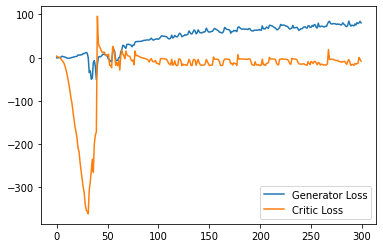

Step 6050: Generator loss: 75.1819075012207, critic loss: -14.299999355316164


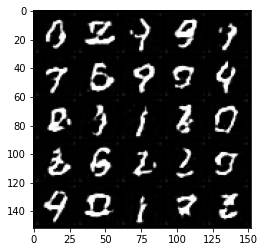

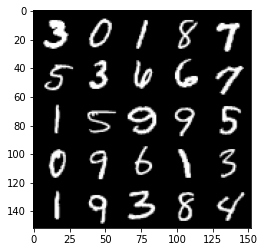

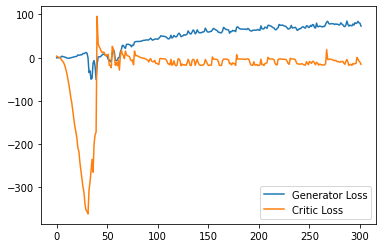

  0%|          | 0/469 [00:00<?, ?it/s]

Step 6100: Generator loss: 77.97845565795899, critic loss: -11.227795674324039


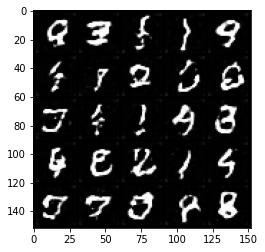

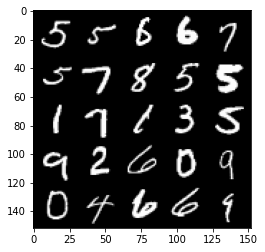

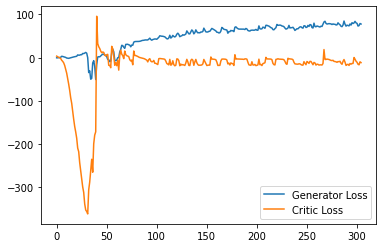

Step 6150: Generator loss: 76.55562438964844, critic loss: -14.49760759019852


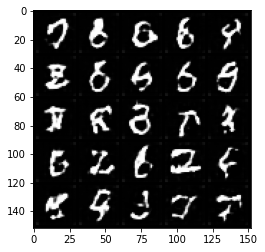

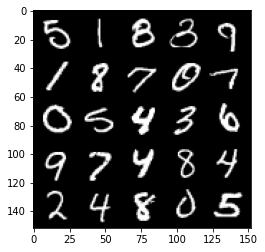

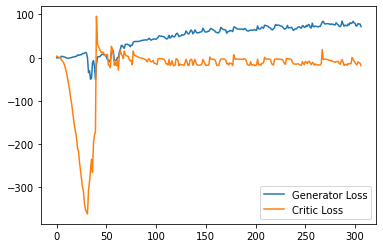

Step 6200: Generator loss: 76.82711486816406, critic loss: -15.010119311332701


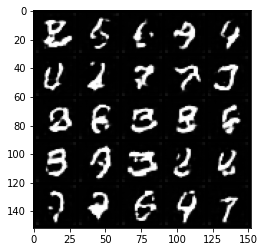

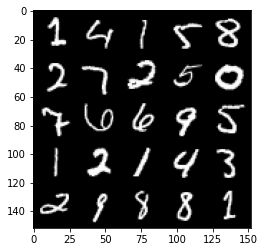

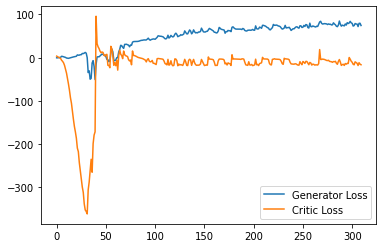

Step 6250: Generator loss: 77.39239791870118, critic loss: -14.119359062671661


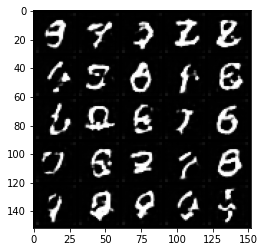

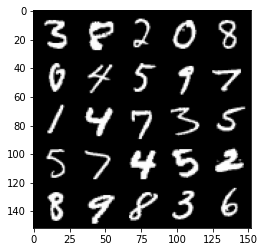

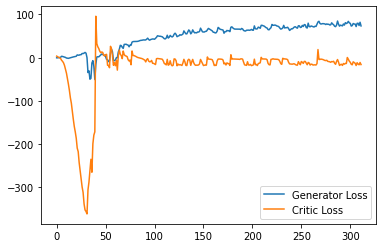

Step 6300: Generator loss: 81.57936897277833, critic loss: -8.894683947563172


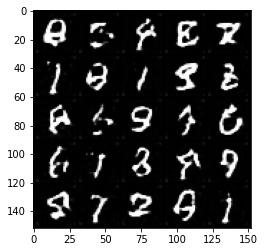

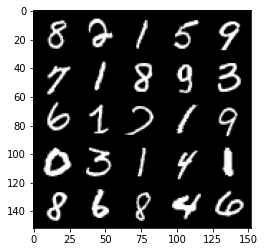

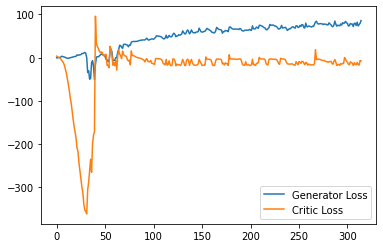

Step 6350: Generator loss: 76.31383499145508, critic loss: -14.96987423563004


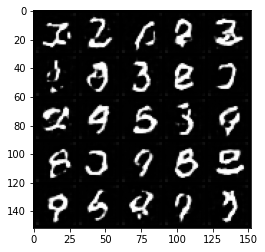

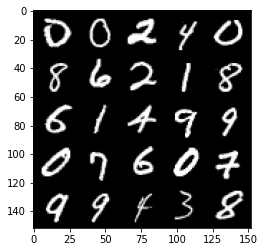

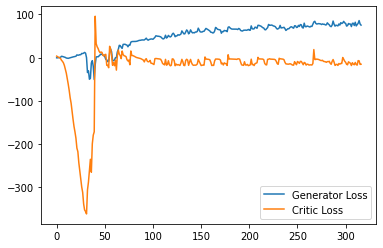

Step 6400: Generator loss: 79.50000228881837, critic loss: -14.861727840423582


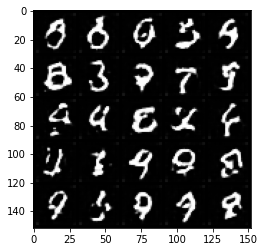

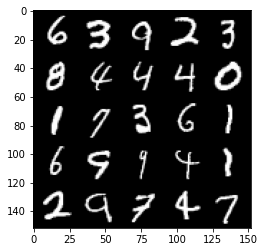

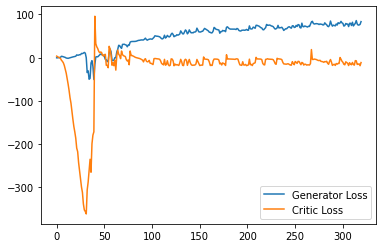

Step 6450: Generator loss: 76.11850532531739, critic loss: -8.849313921809195


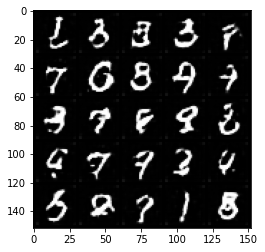

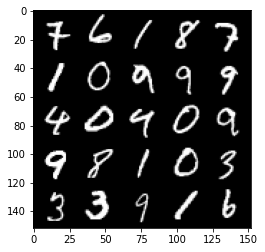

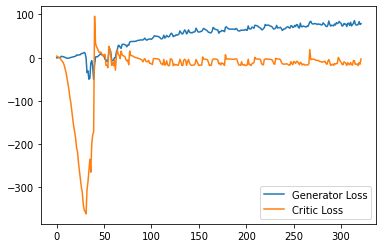

Step 6500: Generator loss: 77.2622819519043, critic loss: -14.557747029304503


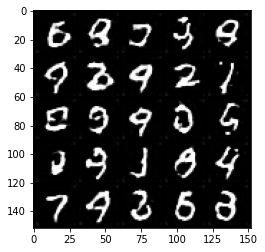

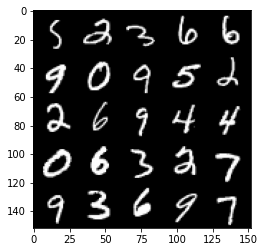

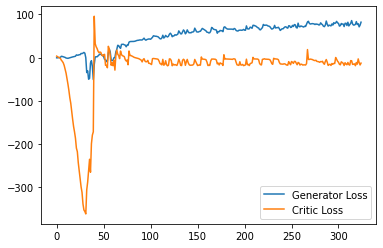

Step 6550: Generator loss: 75.67065910339356, critic loss: -17.77014817929268


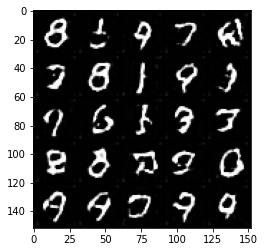

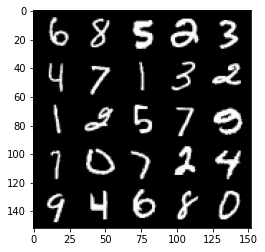

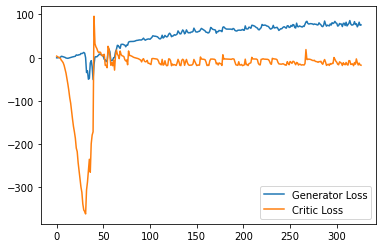

  0%|          | 0/469 [00:00<?, ?it/s]

Step 6600: Generator loss: 82.89056625366212, critic loss: -11.435172498941421


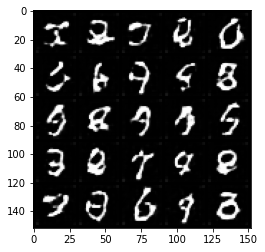

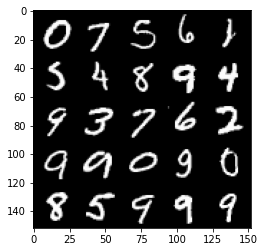

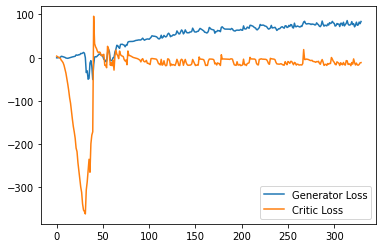

Step 6650: Generator loss: 81.42557205200195, critic loss: -14.427060323238374


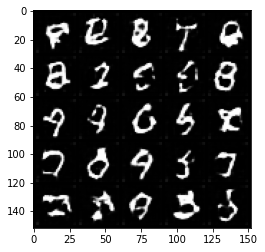

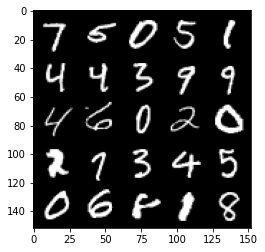

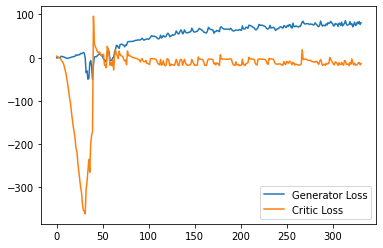

Step 6700: Generator loss: 77.78207046508788, critic loss: -15.667251455783841


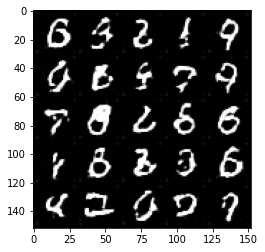

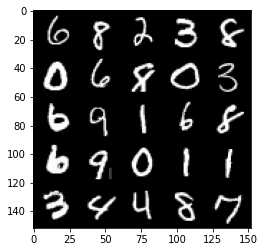

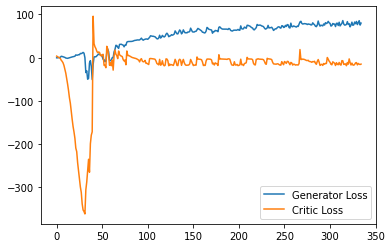

Step 6750: Generator loss: 79.90814544677734, critic loss: -11.08749936294556


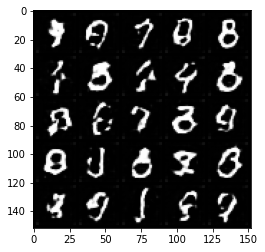

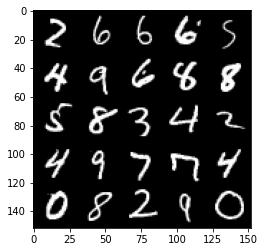

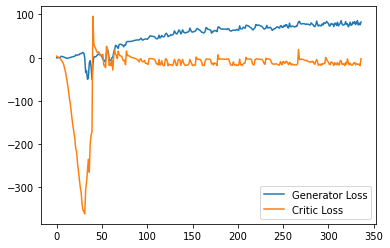

Step 6800: Generator loss: 82.56080368041992, critic loss: -13.329577946424486


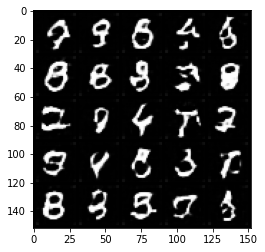

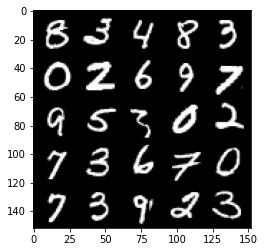

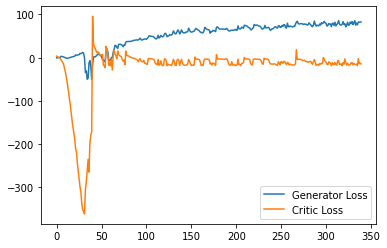

Step 6850: Generator loss: 81.5326284790039, critic loss: -14.118318690776823


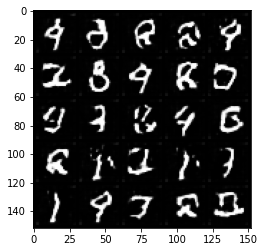

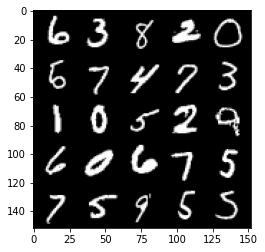

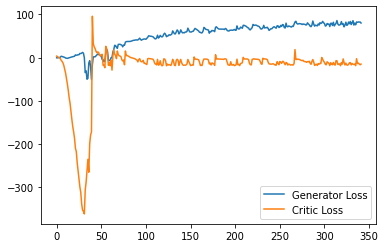

Step 6900: Generator loss: 80.00776229858398, critic loss: -15.980250238895417


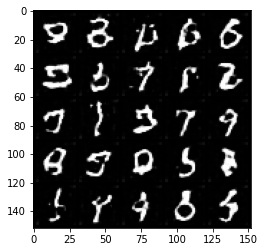

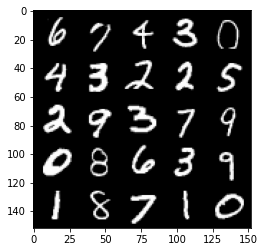

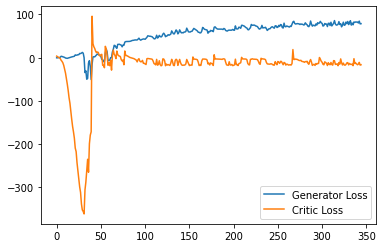

Step 6950: Generator loss: 80.7085563659668, critic loss: -15.20656757688522


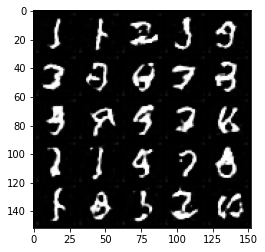

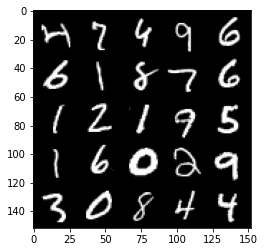

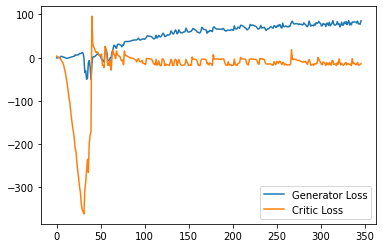

Step 7000: Generator loss: 81.1037158203125, critic loss: -16.115978493213657


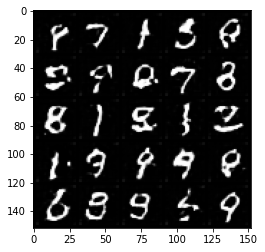

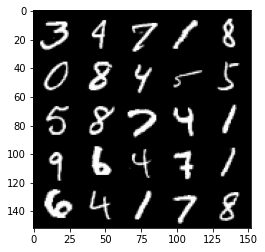

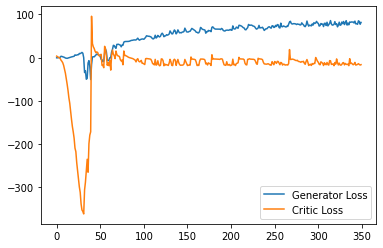

  0%|          | 0/469 [00:00<?, ?it/s]

Step 7050: Generator loss: 89.4796646118164, critic loss: 0.5256993842124926


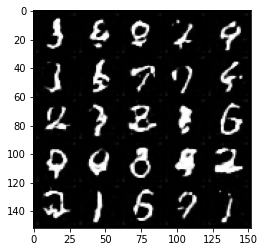

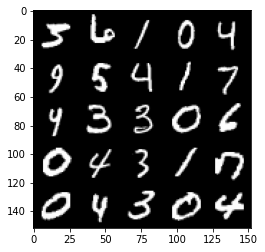

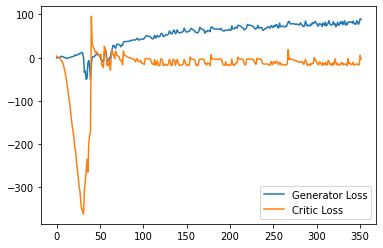

Step 7100: Generator loss: 83.8900225830078, critic loss: -8.909934819221496


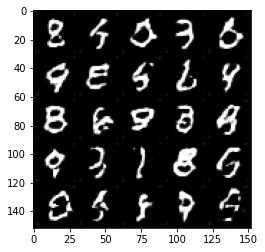

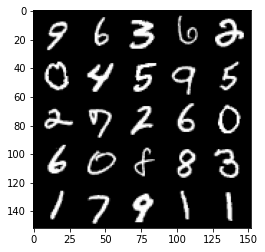

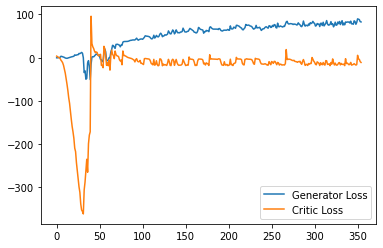

Step 7150: Generator loss: 81.0451414489746, critic loss: -14.147453589439394


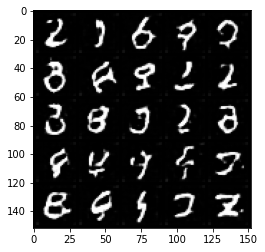

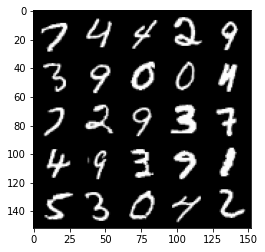

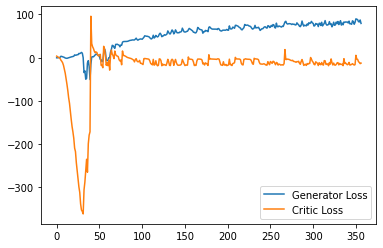

Step 7200: Generator loss: 76.19925132751465, critic loss: -17.683103661537174


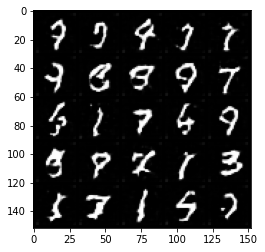

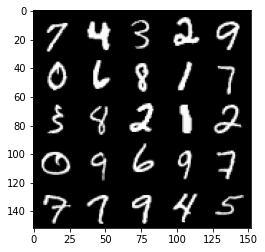

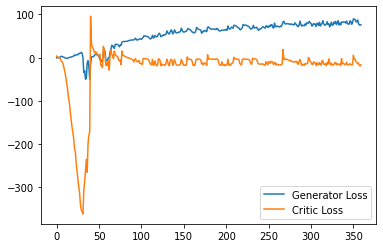

Step 7250: Generator loss: 81.57334869384766, critic loss: -18.181490671634677


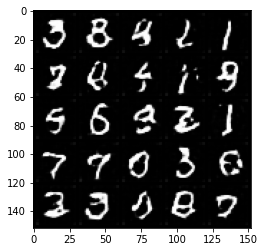

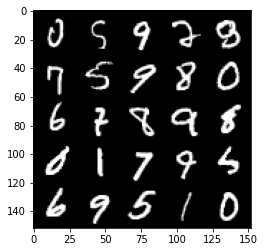

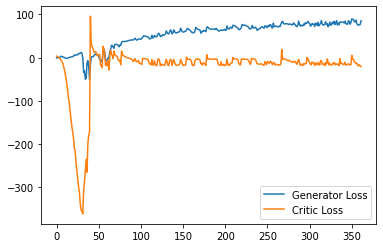

Step 7300: Generator loss: 78.43749603271485, critic loss: -16.807301532268525


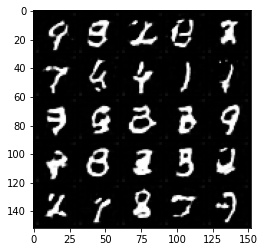

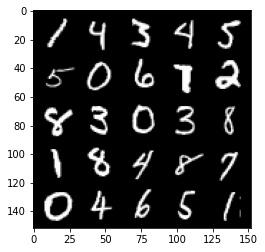

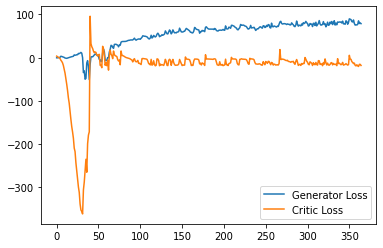

Step 7350: Generator loss: 84.42335266113281, critic loss: -13.751203549861911


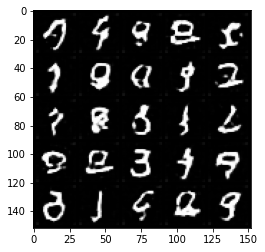

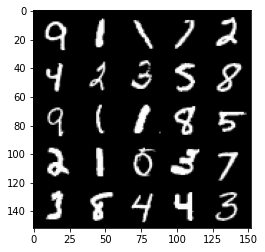

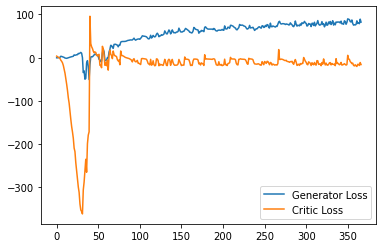

Step 7400: Generator loss: 80.62371200561523, critic loss: -15.587770136117932


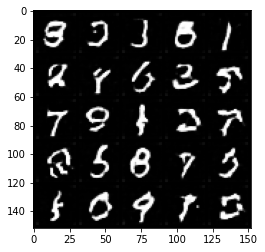

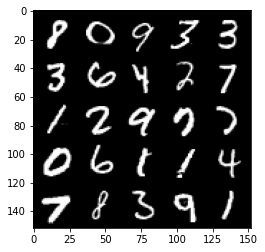

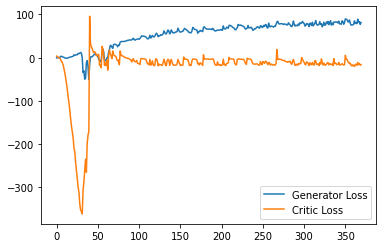

Step 7450: Generator loss: 88.68315948486328, critic loss: -7.873708971381189


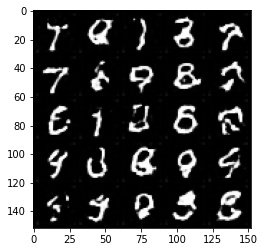

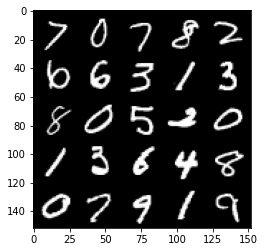

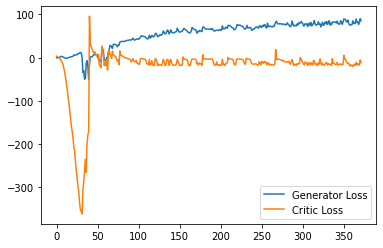

Step 7500: Generator loss: 85.94466537475586, critic loss: -6.607404522895811


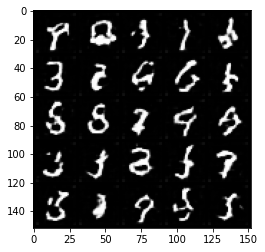

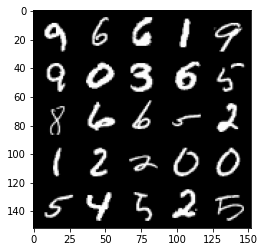

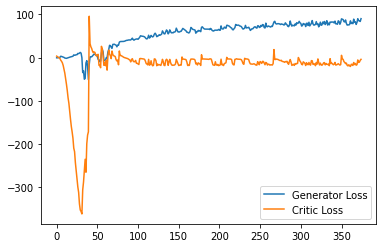

  0%|          | 0/469 [00:00<?, ?it/s]

Step 7550: Generator loss: 81.34519821166992, critic loss: -12.952422002792355


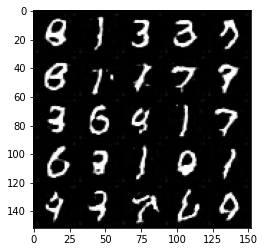

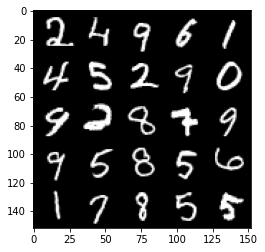

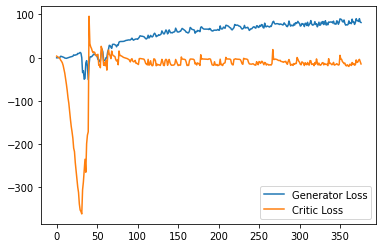

Step 7600: Generator loss: 80.89835601806641, critic loss: -16.267547596573824


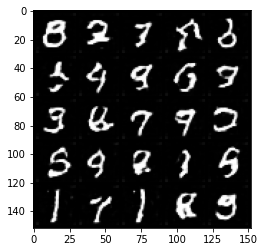

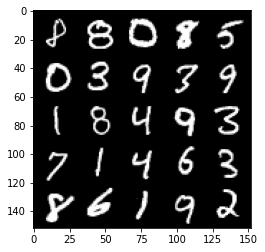

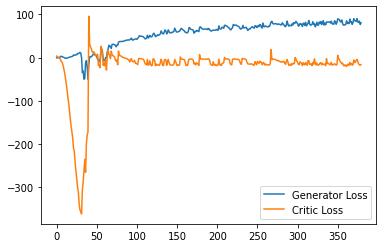

Step 7650: Generator loss: 83.41378234863281, critic loss: -12.436313104629512


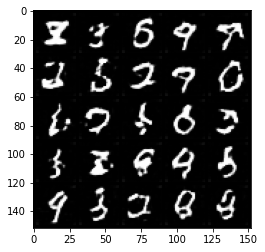

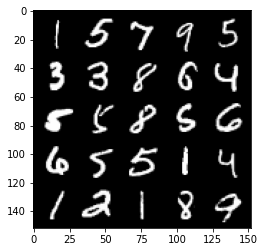

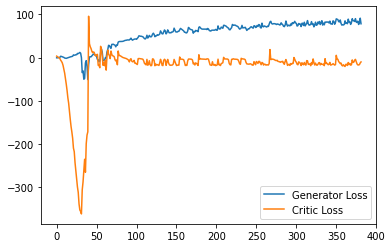

Step 7700: Generator loss: 84.50120620727539, critic loss: -16.492612131595607


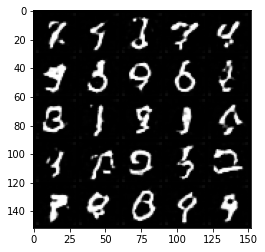

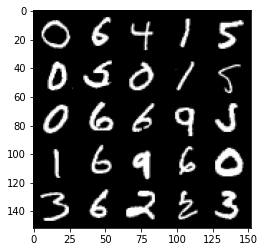

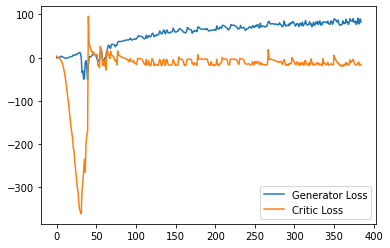

Step 7750: Generator loss: 80.72681243896484, critic loss: -18.796000375270843


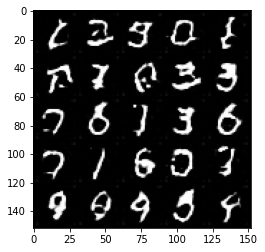

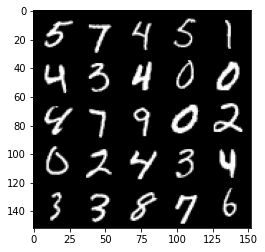

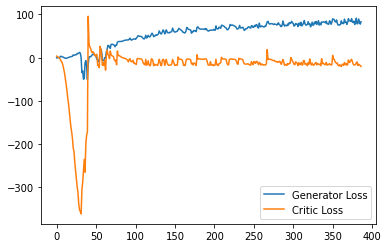

Step 7800: Generator loss: 81.80528305053711, critic loss: -13.18025840306282


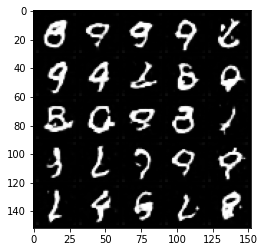

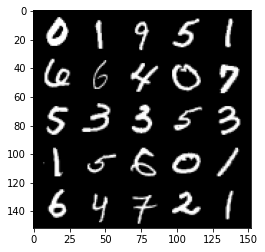

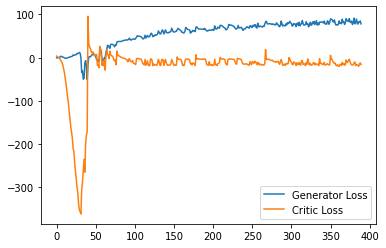

Step 7850: Generator loss: 86.10966339111329, critic loss: -7.991447256088259


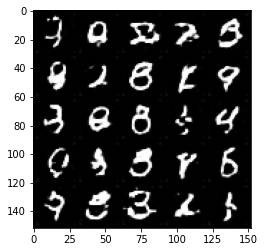

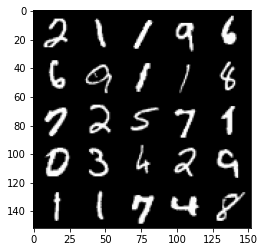

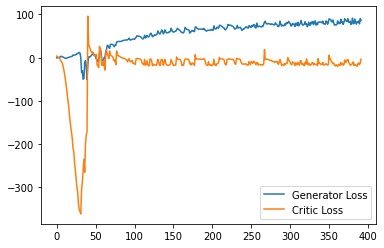

Step 7900: Generator loss: 82.22293823242188, critic loss: -13.917183060169226


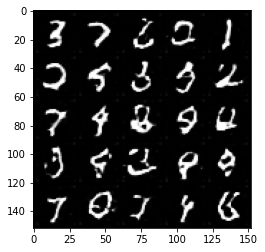

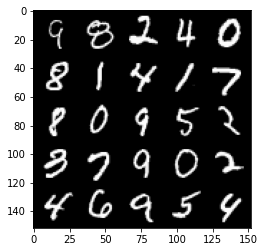

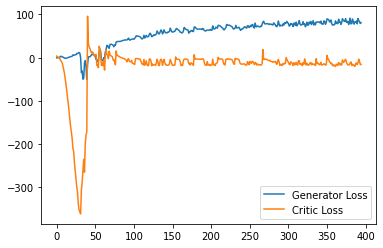

Step 7950: Generator loss: 81.58279586791993, critic loss: -15.057686863899235


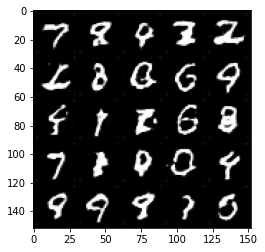

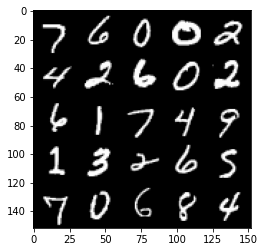

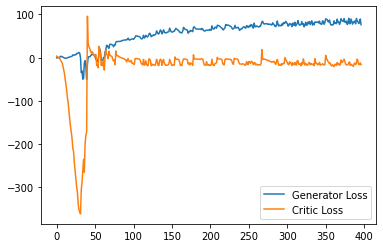

  0%|          | 0/469 [00:00<?, ?it/s]

Step 8000: Generator loss: 79.90156936645508, critic loss: -16.602787825346


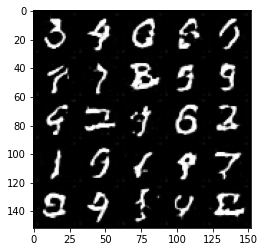

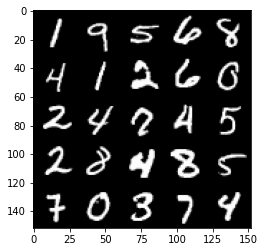

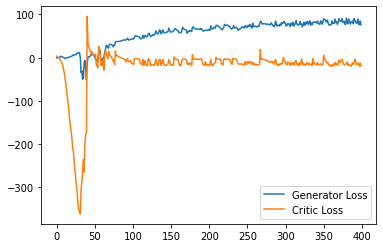

Step 8050: Generator loss: 84.51922157287598, critic loss: -16.75159913349152


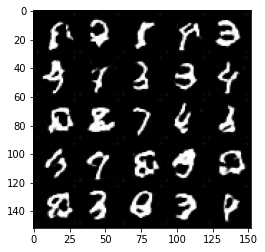

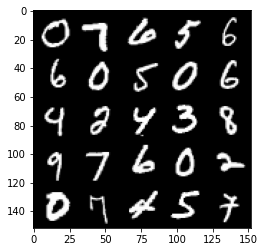

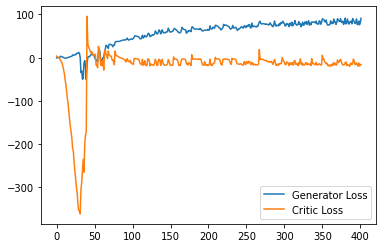

Step 8100: Generator loss: 80.43468070983887, critic loss: -14.310012831687928


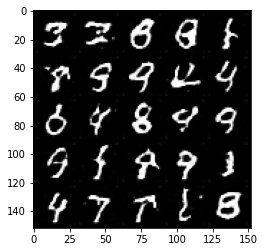

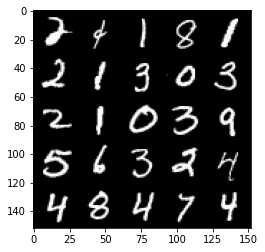

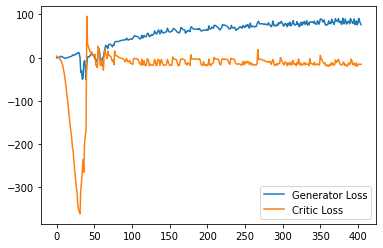

Step 8150: Generator loss: 89.28711502075195, critic loss: -12.469297451019289


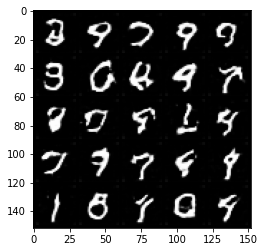

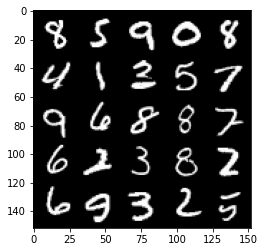

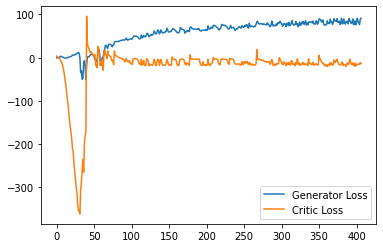

Step 8200: Generator loss: 80.84469497680664, critic loss: -16.746213716983796


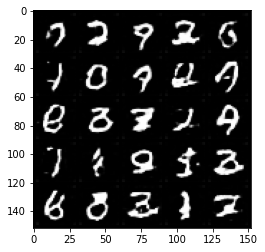

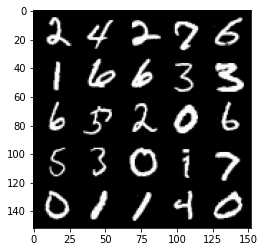

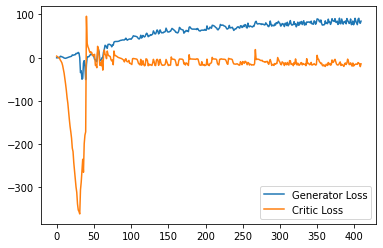

Step 8250: Generator loss: 82.27377464294433, critic loss: -14.454825608730314


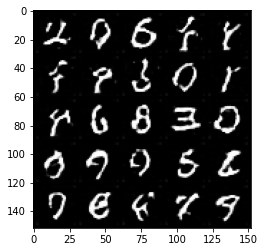

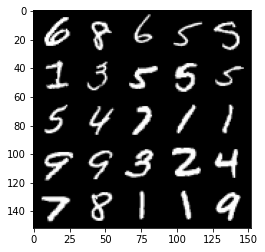

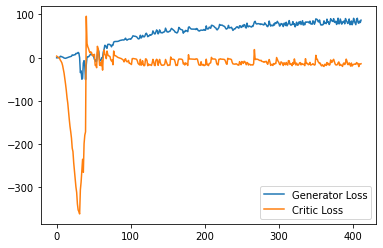

Step 8300: Generator loss: 84.8537321472168, critic loss: -4.910798562049866


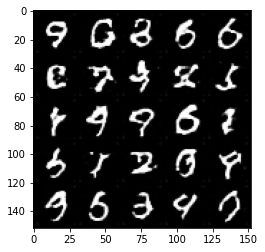

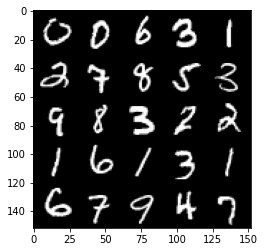

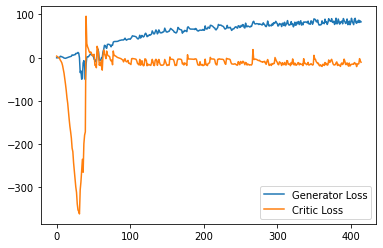

Step 8350: Generator loss: 81.52566909790039, critic loss: -14.68893616771698


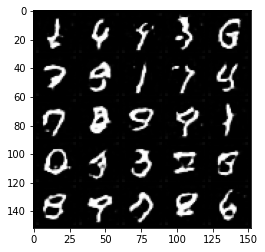

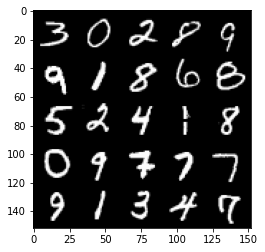

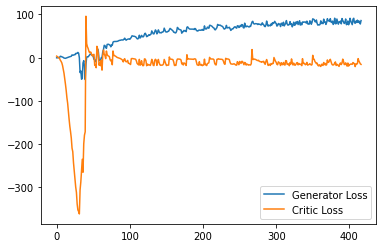

Step 8400: Generator loss: 79.58278099060058, critic loss: -15.066653432846072


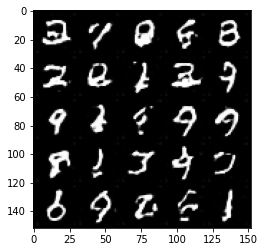

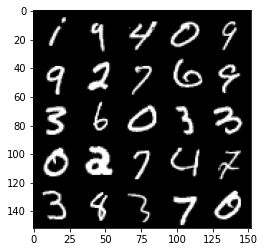

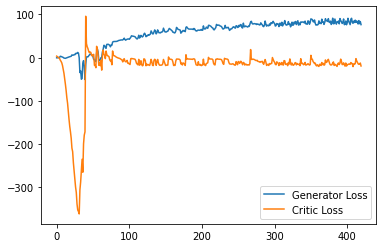

  0%|          | 0/469 [00:00<?, ?it/s]

Step 8450: Generator loss: 85.93405197143555, critic loss: -11.513556141853336


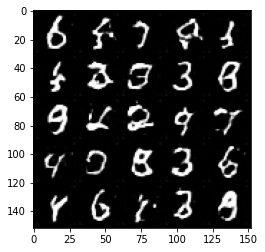

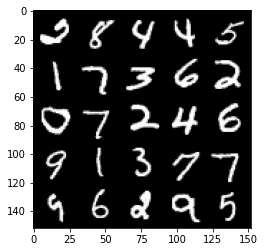

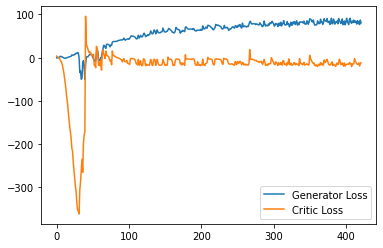

Step 8500: Generator loss: 85.27686462402343, critic loss: -14.560079391241072


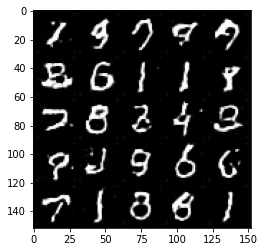

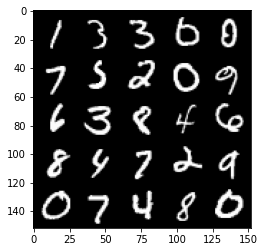

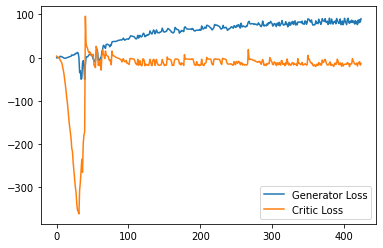

Step 8550: Generator loss: 82.73038772583008, critic loss: -11.282932803273205


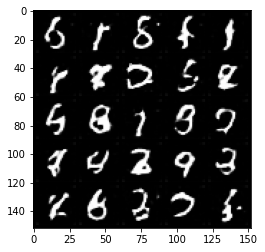

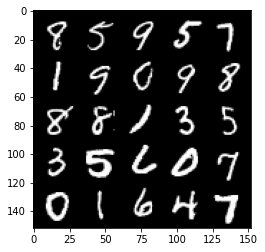

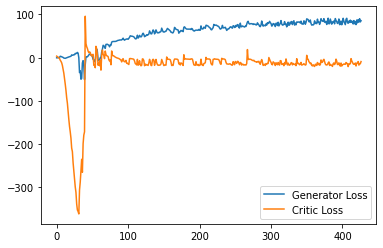

Step 8600: Generator loss: 83.52128005981446, critic loss: -13.85268033266067


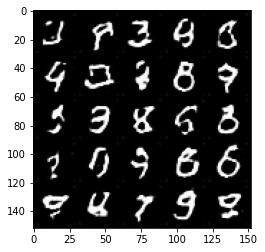

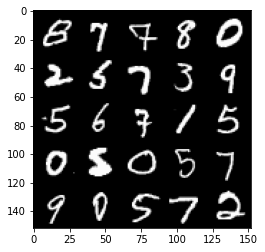

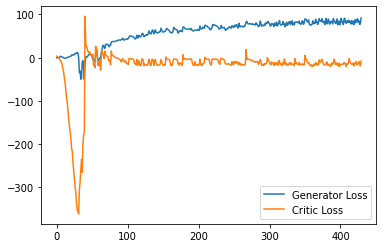

Step 8650: Generator loss: 84.64575103759766, critic loss: -11.430026237249379


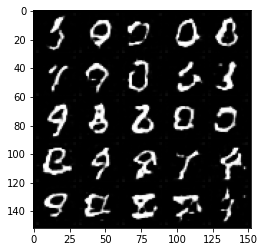

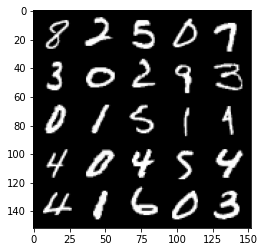

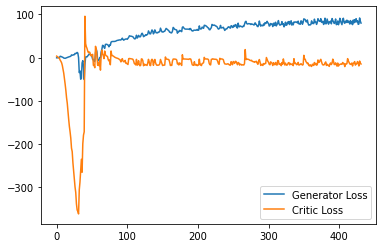

Step 8700: Generator loss: 79.87779846191407, critic loss: -16.999241468191148


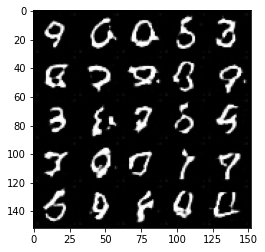

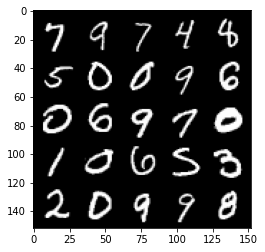

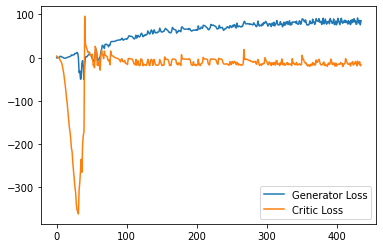

Step 8750: Generator loss: 85.73086395263672, critic loss: -7.250497142791748


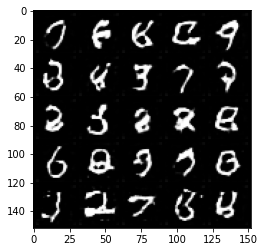

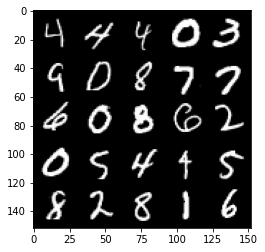

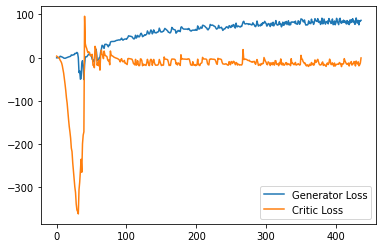

Step 8800: Generator loss: 82.8996795654297, critic loss: -14.326981858968734


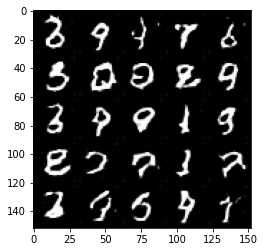

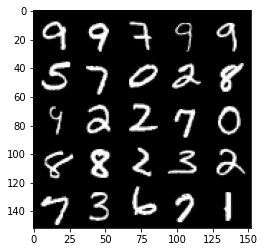

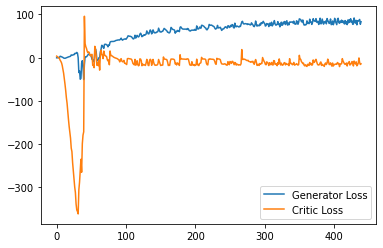

Step 8850: Generator loss: 80.01955657958985, critic loss: -15.865974777460096


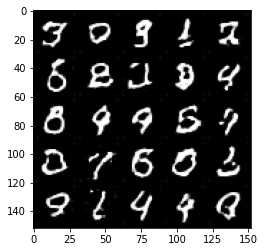

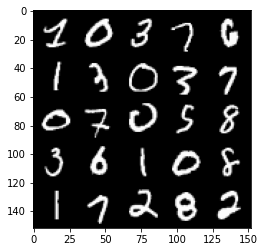

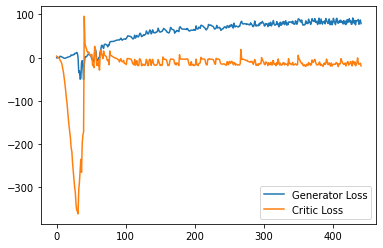

Step 8900: Generator loss: 78.7379256439209, critic loss: -19.662998933076857


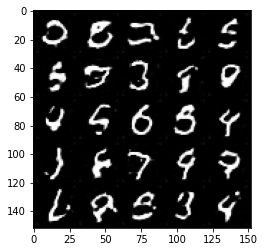

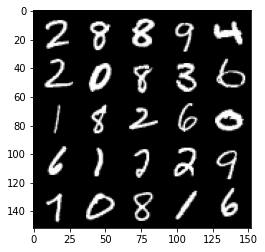

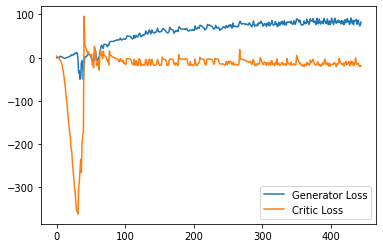

  0%|          | 0/469 [00:00<?, ?it/s]

Step 8950: Generator loss: 89.0202407836914, critic loss: -5.35752658700943


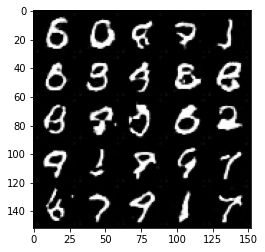

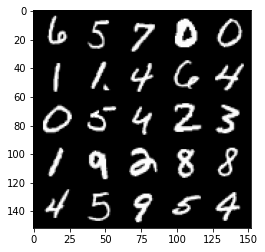

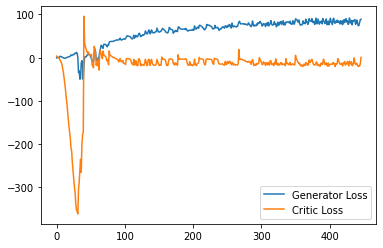

Step 9000: Generator loss: 85.02385475158691, critic loss: -8.677231955289841


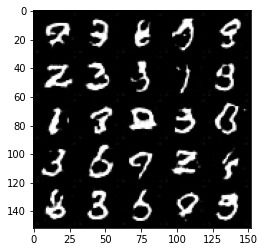

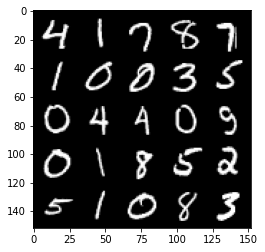

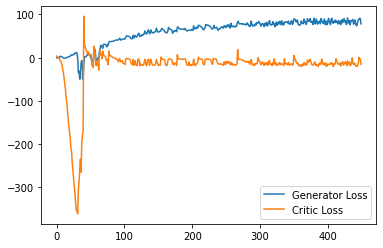

Step 9050: Generator loss: 81.4140990447998, critic loss: -13.52373768281937


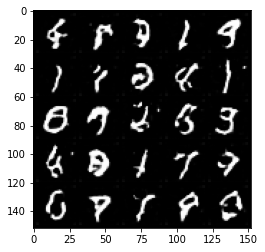

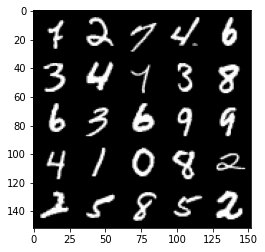

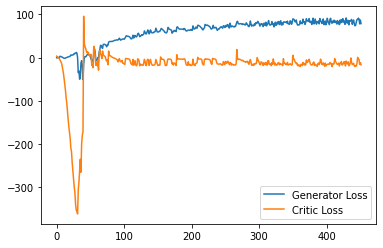

Step 9100: Generator loss: 85.87776779174804, critic loss: -12.60092538547516


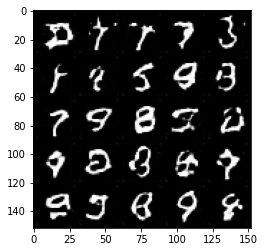

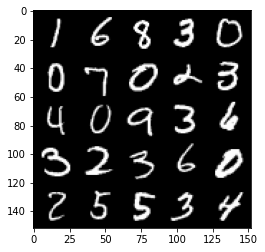

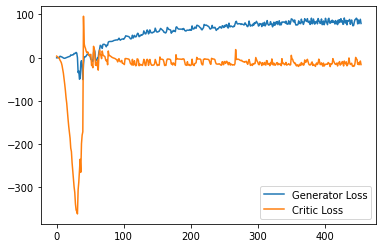

Step 9150: Generator loss: 87.37354598999023, critic loss: -13.82631593847275


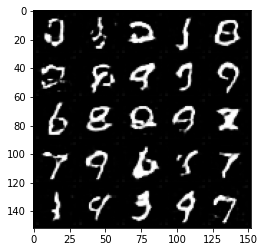

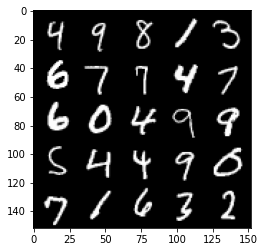

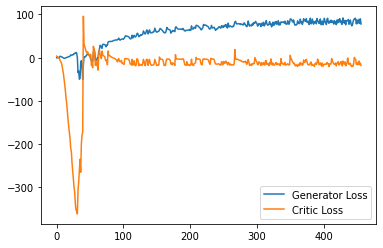

Step 9200: Generator loss: 86.2344320678711, critic loss: -16.95105173754692


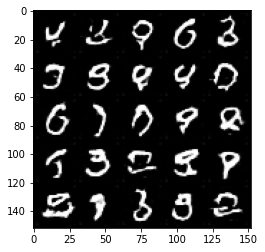

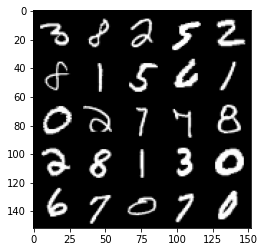

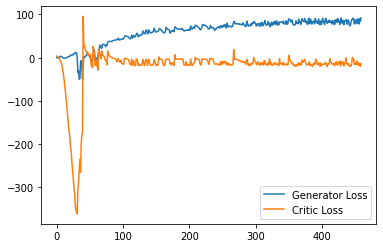

Step 9250: Generator loss: 83.35391479492188, critic loss: -13.55162330508232


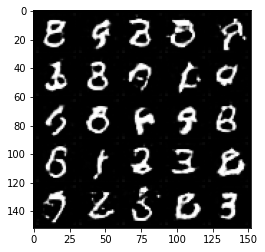

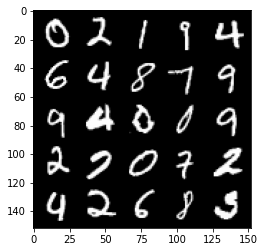

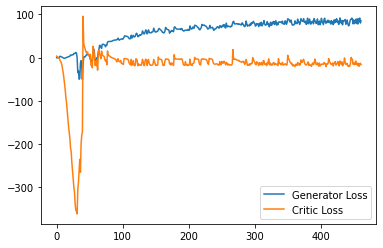

Step 9300: Generator loss: 82.08235092163086, critic loss: -17.278870078563685


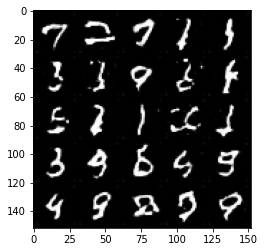

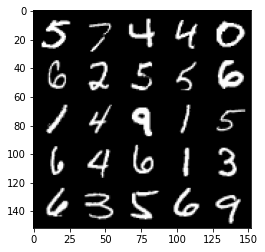

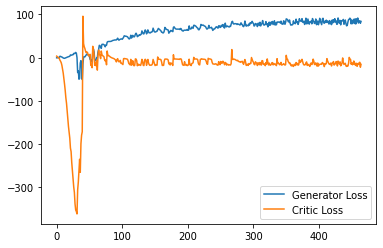

Step 9350: Generator loss: 82.38491500854492, critic loss: -16.061835651397708


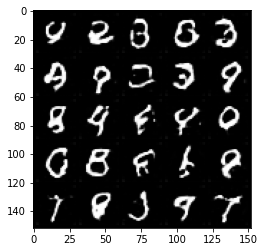

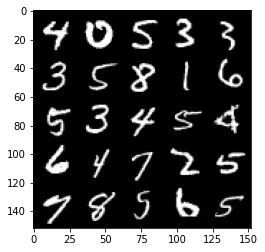

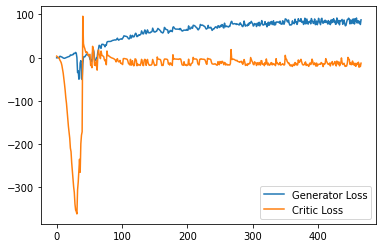

  0%|          | 0/469 [00:00<?, ?it/s]

Step 9400: Generator loss: 78.59733383178711, critic loss: -17.00228621339798


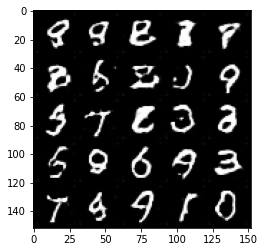

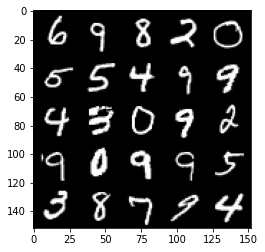

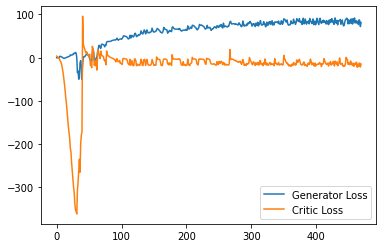

Step 9450: Generator loss: 88.18923019409179, critic loss: -13.316662588119504


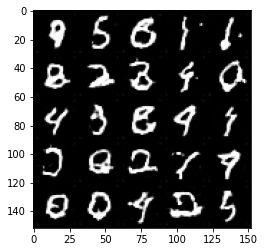

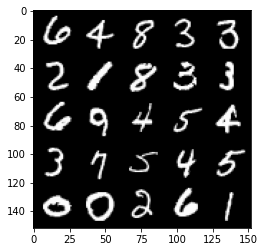

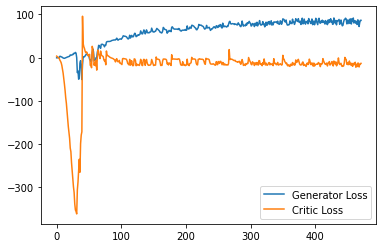

Step 9500: Generator loss: 84.3381356048584, critic loss: -14.565009701490402


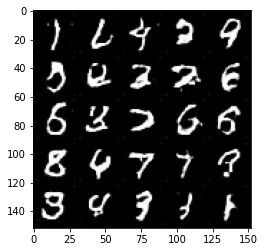

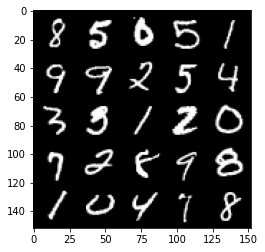

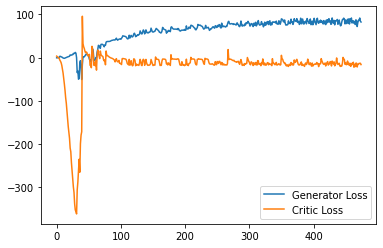

Step 9550: Generator loss: 90.5938289642334, critic loss: -14.513190935611725


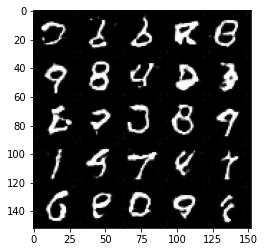

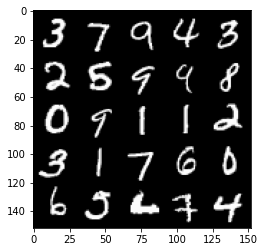

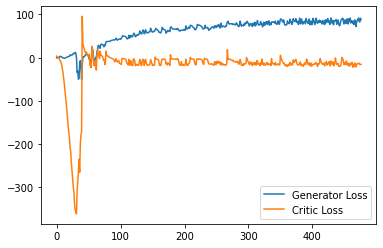

Step 9600: Generator loss: 86.21478660583496, critic loss: -6.285829125404357


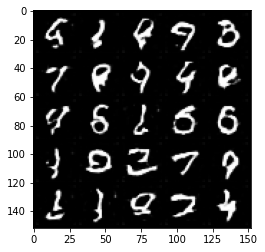

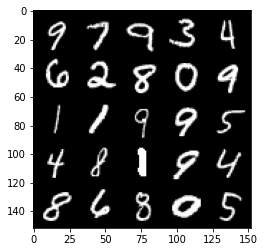

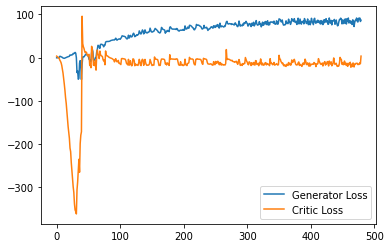

Step 9650: Generator loss: 84.51197860717774, critic loss: -12.121880907535559


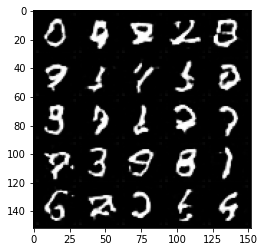

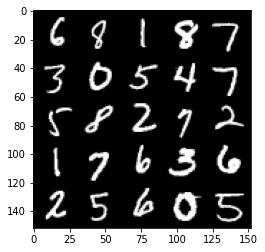

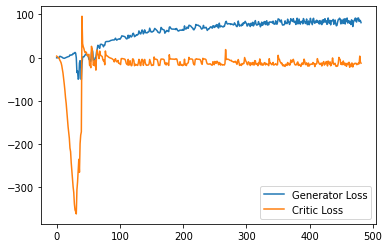

Step 9700: Generator loss: 81.51023193359374, critic loss: -15.59906055307388


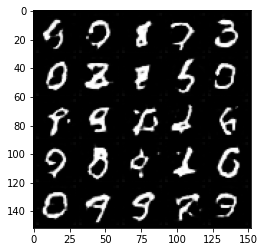

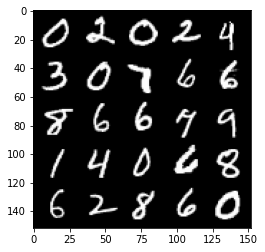

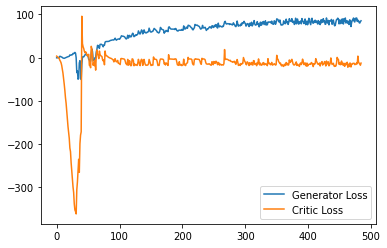

Step 9750: Generator loss: 81.82222480773926, critic loss: -15.591192399024962


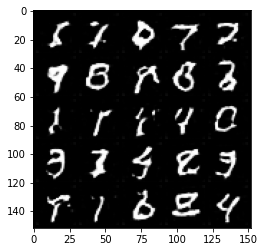

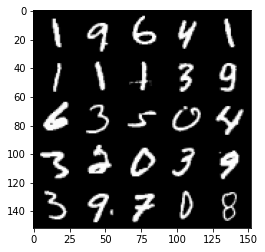

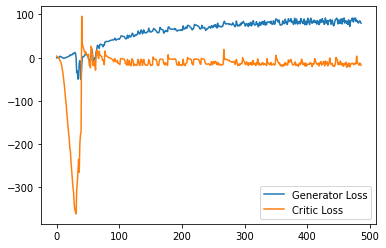

Step 9800: Generator loss: 84.08455184936524, critic loss: -13.85617671108246


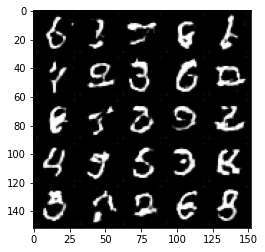

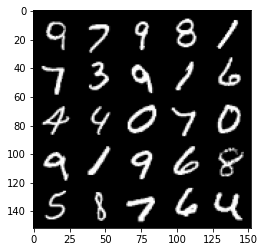

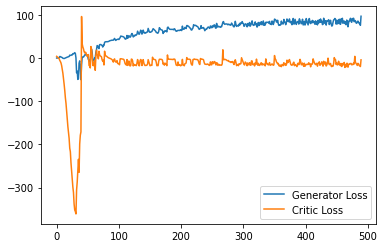

  0%|          | 0/469 [00:00<?, ?it/s]

Step 9850: Generator loss: 81.55797653198242, critic loss: -14.296546519279481


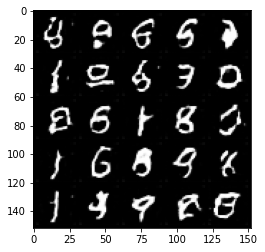

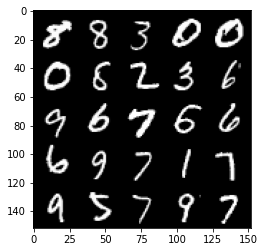

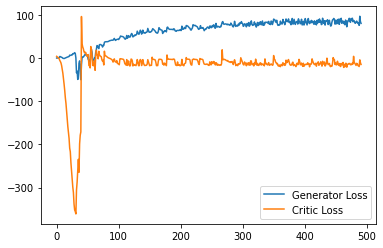

Step 9900: Generator loss: 85.81806732177735, critic loss: -19.754778393983838


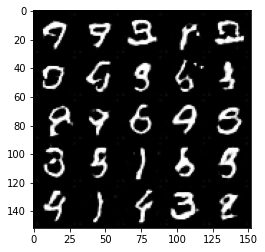

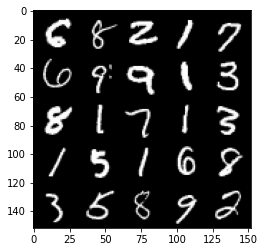

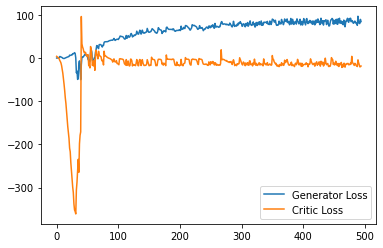

Step 9950: Generator loss: 91.19412536621094, critic loss: -6.884310644388201


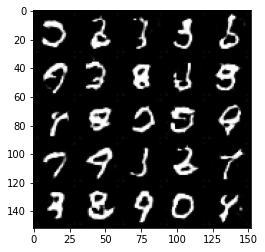

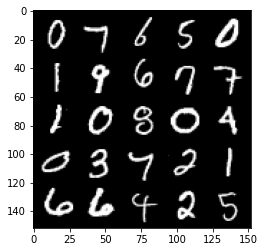

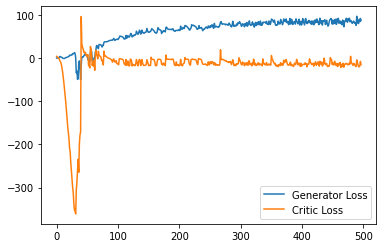

Step 10000: Generator loss: 84.82775253295898, critic loss: -14.227132202625276


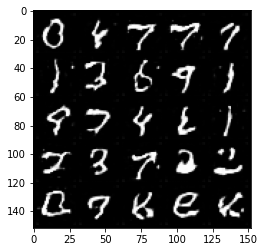

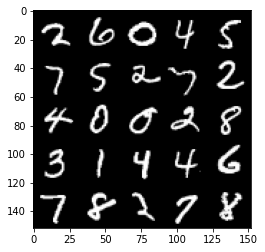

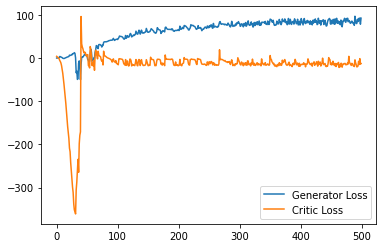

Step 10050: Generator loss: 80.78734939575196, critic loss: -17.70952909135819


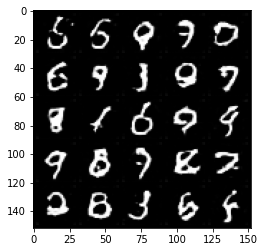

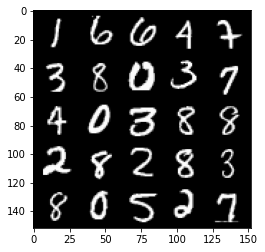

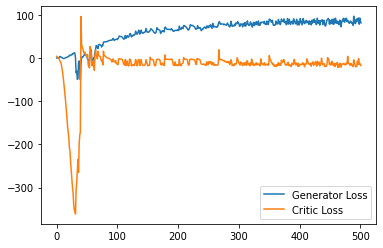

Step 10100: Generator loss: 82.55947677612305, critic loss: -16.726588052749634


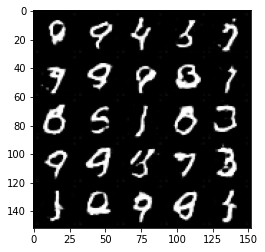

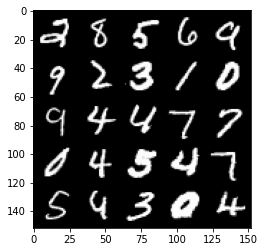

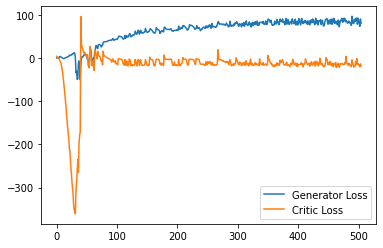

Step 10150: Generator loss: 86.89294357299805, critic loss: -13.598711373806003


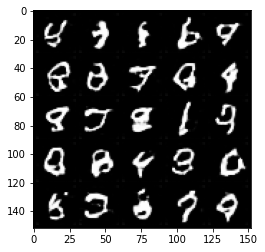

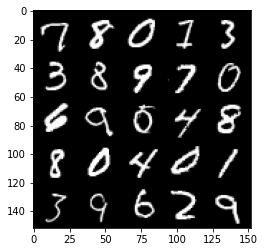

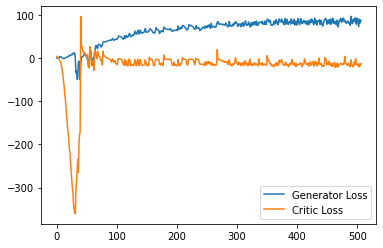

Step 10200: Generator loss: 77.39964347839356, critic loss: -19.804318583488456


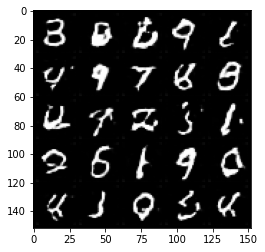

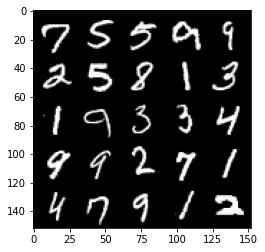

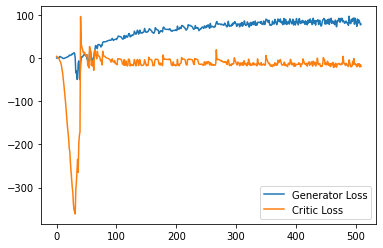

Step 10250: Generator loss: 86.59260856628418, critic loss: -18.645563004732125


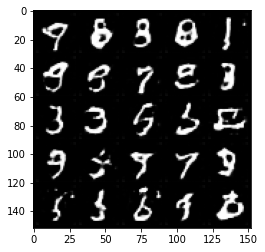

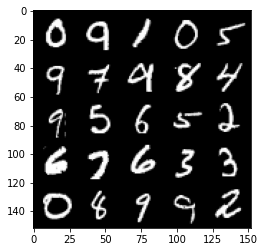

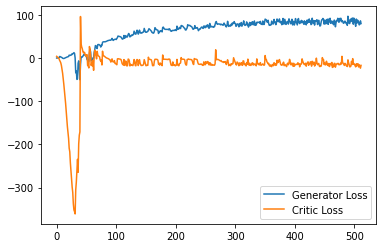

Step 10300: Generator loss: 86.73645286560058, critic loss: -15.287041012287139


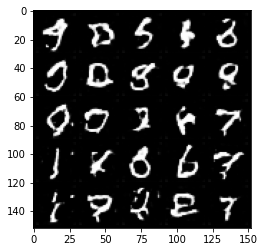

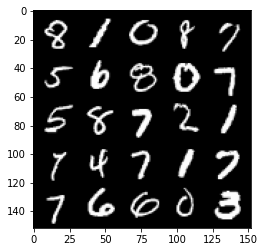

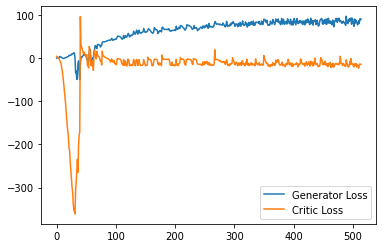

  0%|          | 0/469 [00:00<?, ?it/s]

Step 10350: Generator loss: 85.52331512451173, critic loss: -6.659478792667389


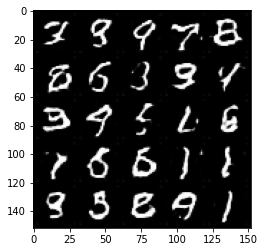

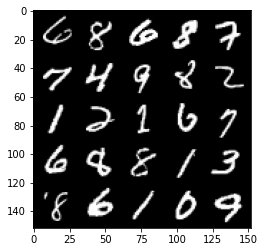

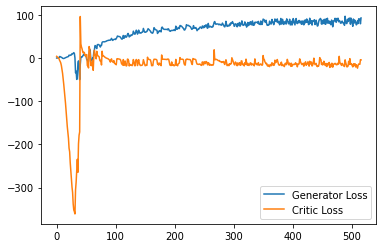

Step 10400: Generator loss: 90.89222396850586, critic loss: -11.324683835029603


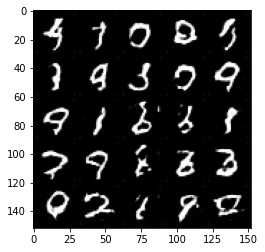

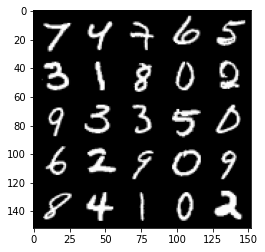

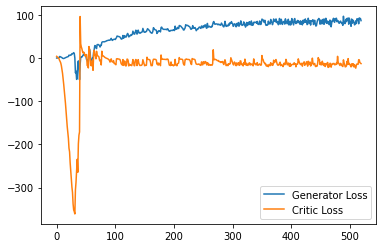

Step 10450: Generator loss: 78.11471710205078, critic loss: -19.996082606554033


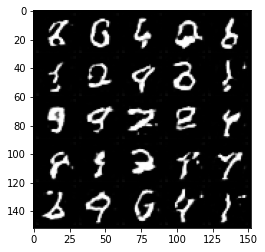

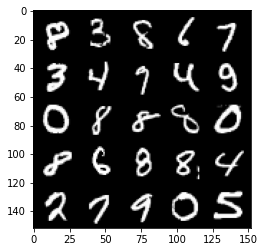

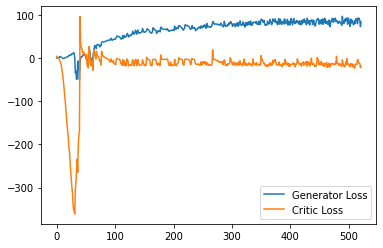

Step 10500: Generator loss: 85.07212532043457, critic loss: -17.331569672584536


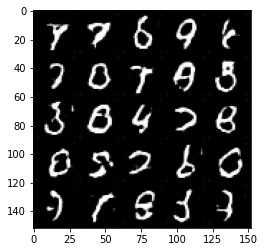

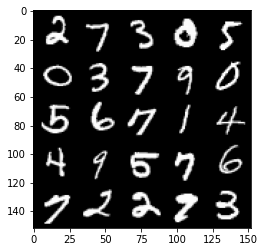

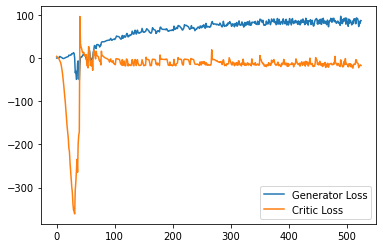

Step 10550: Generator loss: 92.37396606445313, critic loss: -12.677196895599364


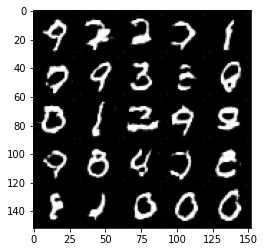

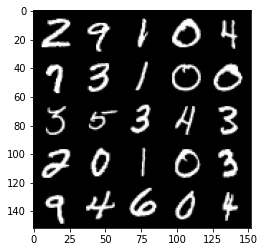

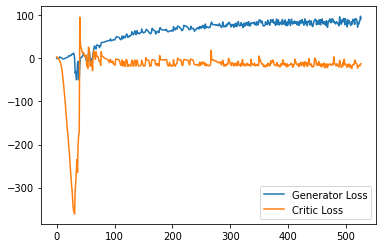

Step 10600: Generator loss: 86.44327575683593, critic loss: -15.421898282051089


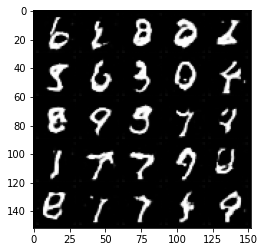

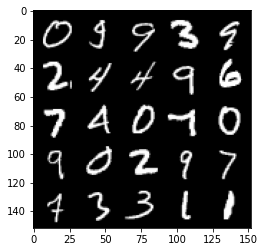

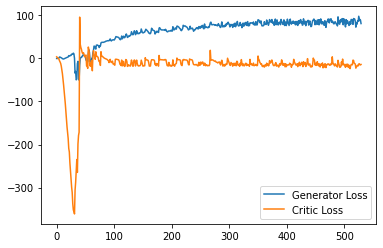

Step 10650: Generator loss: 94.25747871398926, critic loss: -19.23118495130539


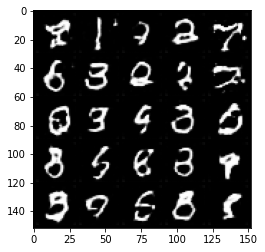

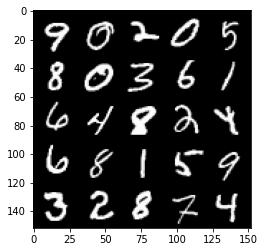

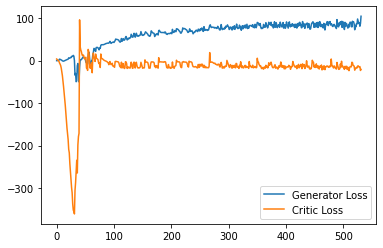

Step 10700: Generator loss: 81.76803787231445, critic loss: -10.272763919591904


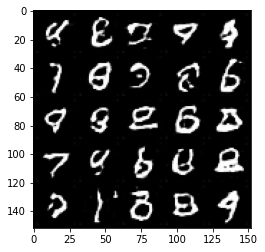

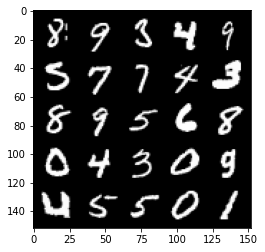

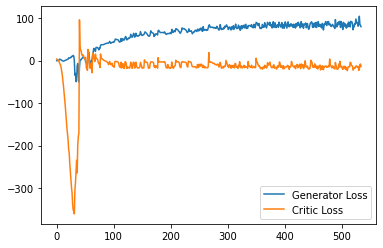

Step 10750: Generator loss: 87.72563713073731, critic loss: -13.775907005310057


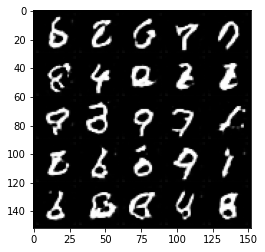

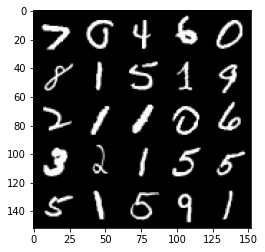

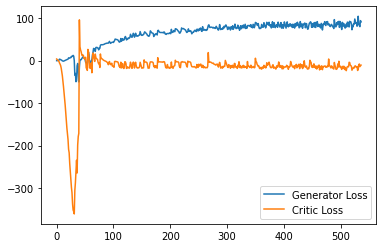

  0%|          | 0/469 [00:00<?, ?it/s]

Step 10800: Generator loss: 87.62351287841797, critic loss: -12.140193211793898


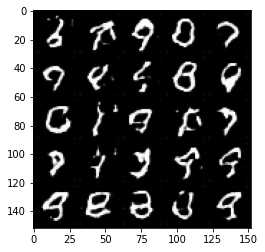

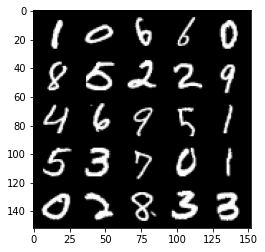

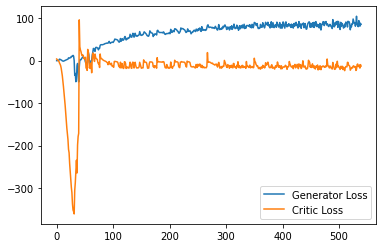

Step 10850: Generator loss: 84.92985725402832, critic loss: -12.485880707263945


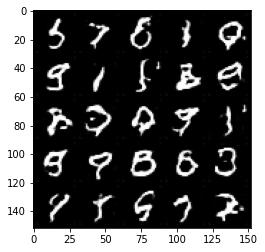

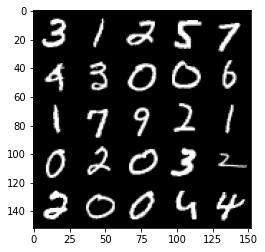

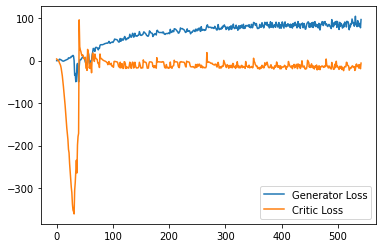

Step 10900: Generator loss: 87.9040463256836, critic loss: -5.111242488384245


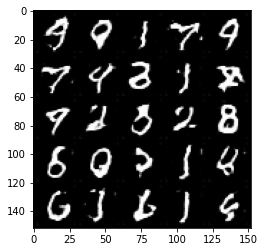

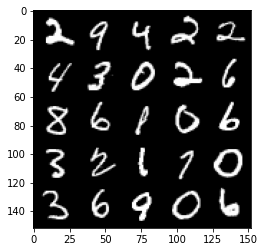

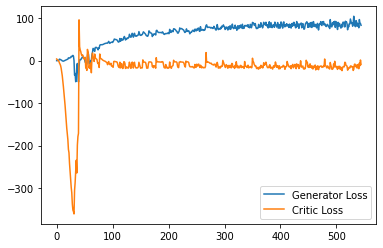

Step 10950: Generator loss: 89.82392982482911, critic loss: -12.373164799690251


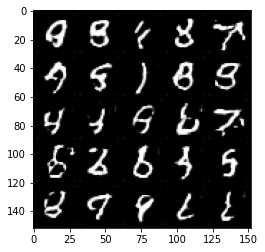

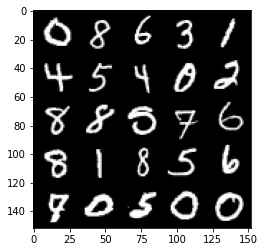

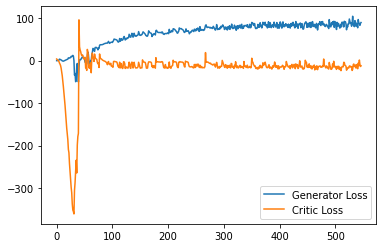

Step 11000: Generator loss: 87.38374160766601, critic loss: -16.585709737777712


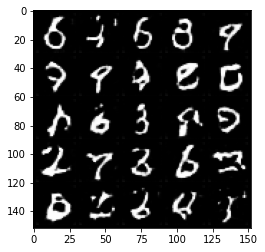

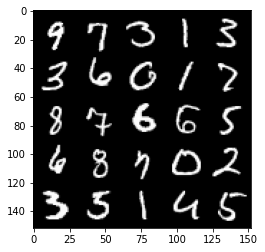

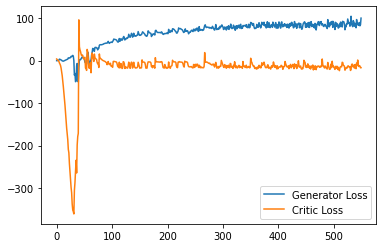

Step 11050: Generator loss: 78.75062316894531, critic loss: -15.959545326709753


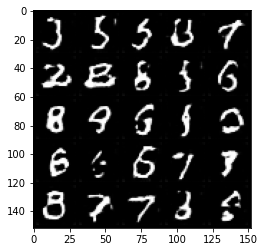

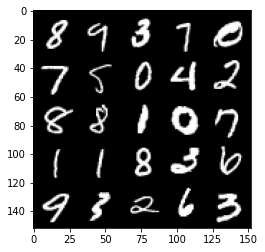

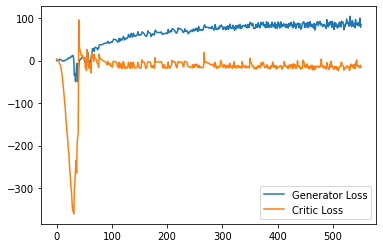

Step 11100: Generator loss: 71.81013954162597, critic loss: -19.669122655391693


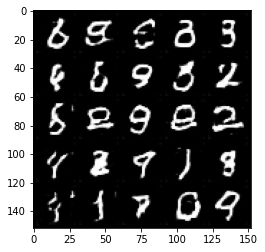

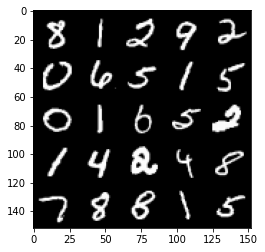

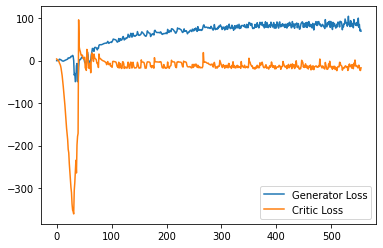

Step 11150: Generator loss: 91.3357405090332, critic loss: -14.21248824357987


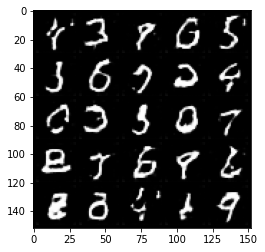

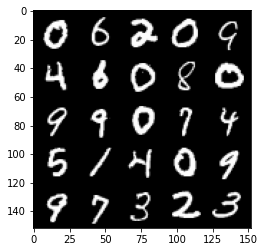

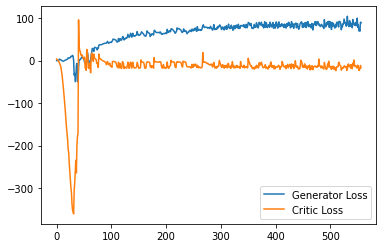

Step 11200: Generator loss: 88.99611198425293, critic loss: -2.8109043383598338


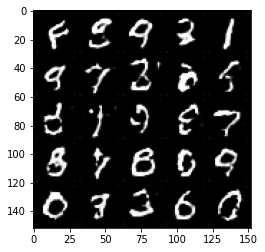

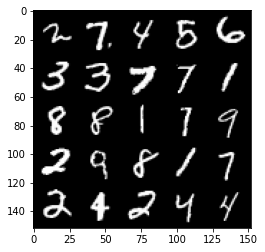

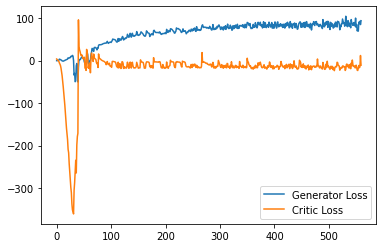

Step 11250: Generator loss: 86.96727546691895, critic loss: -10.755711288213728


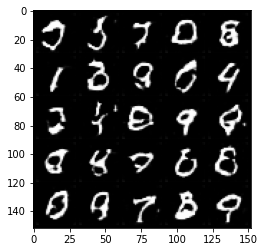

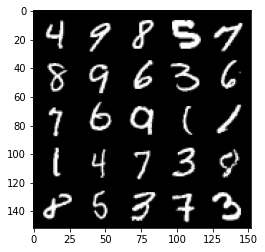

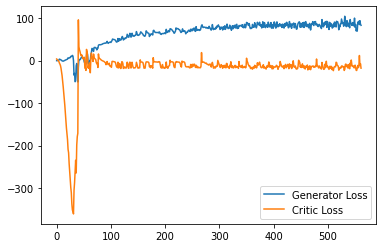

  0%|          | 0/469 [00:00<?, ?it/s]

Step 11300: Generator loss: 88.34613235473633, critic loss: -11.220148880004883


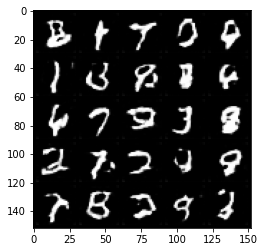

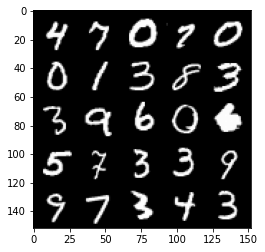

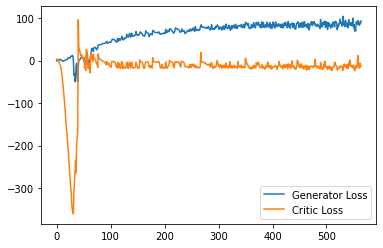

Step 11350: Generator loss: 83.02208450317383, critic loss: -13.630205444812777


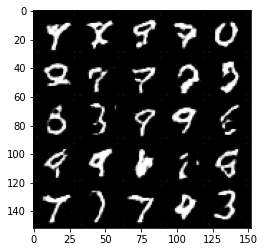

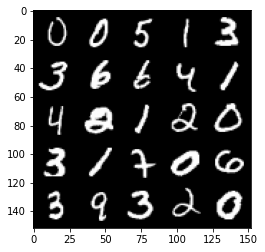

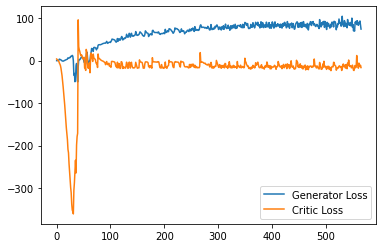

Step 11400: Generator loss: 82.82954566955567, critic loss: -16.472786200523377


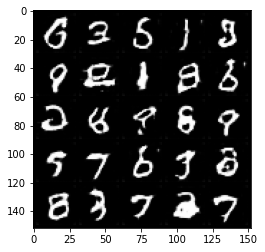

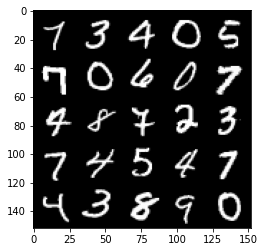

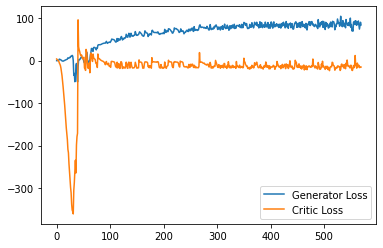

Step 11450: Generator loss: 77.55432167053223, critic loss: -15.237182753562923


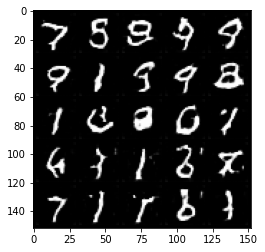

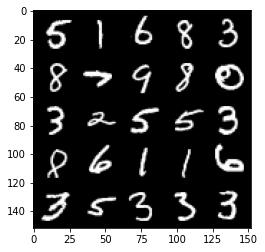

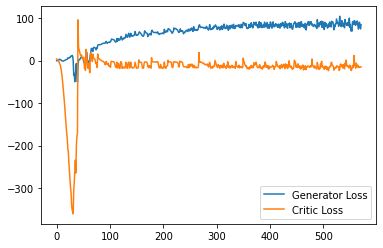

Step 11500: Generator loss: 84.3394930267334, critic loss: -8.415959456443787


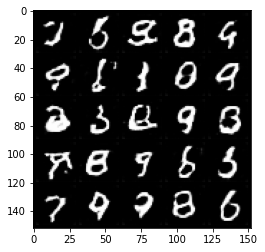

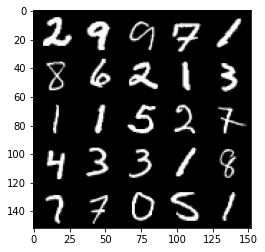

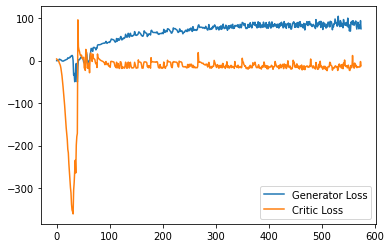

Step 11550: Generator loss: 82.88217102050781, critic loss: -15.977274652957915


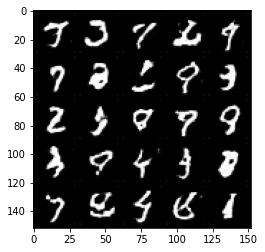

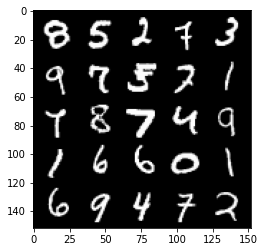

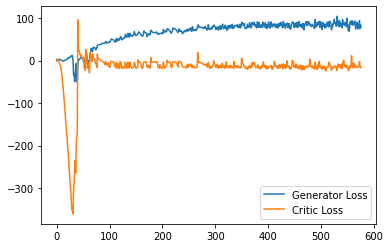

Step 11600: Generator loss: 86.14585754394531, critic loss: -12.119187786102295


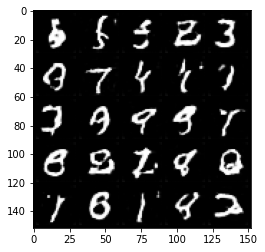

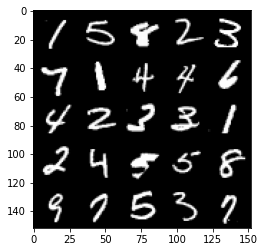

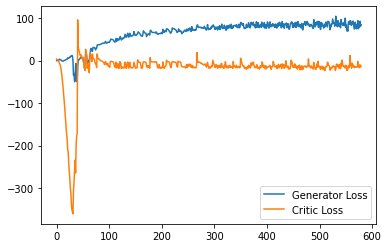

Step 11650: Generator loss: 88.19647254943848, critic loss: -14.211657977104185


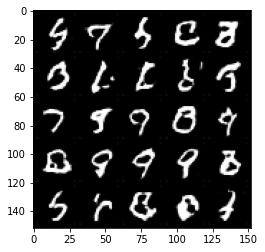

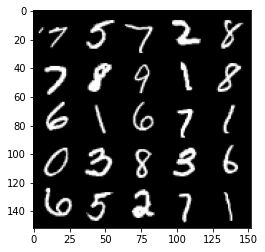

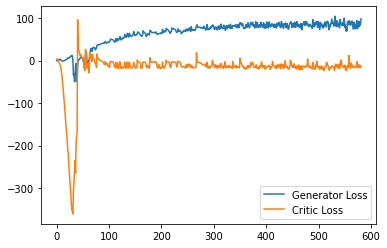

Step 11700: Generator loss: 84.46724472045898, critic loss: -15.774532567262643


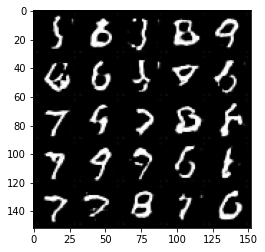

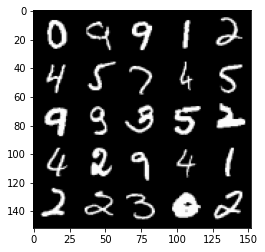

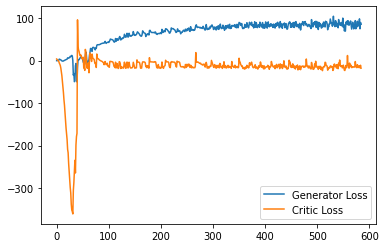

  0%|          | 0/469 [00:00<?, ?it/s]

Step 11750: Generator loss: 87.53478294372559, critic loss: -14.460695033788683


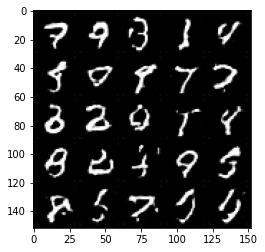

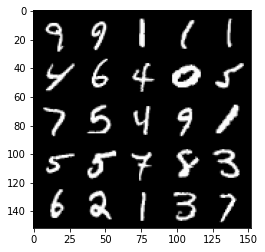

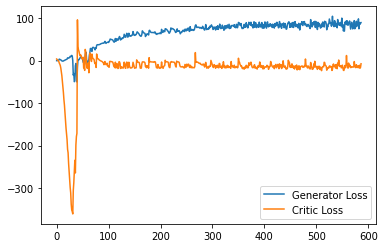

Step 11800: Generator loss: 80.06699996948242, critic loss: -12.408839495182038


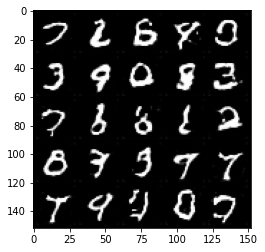

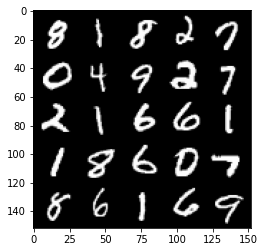

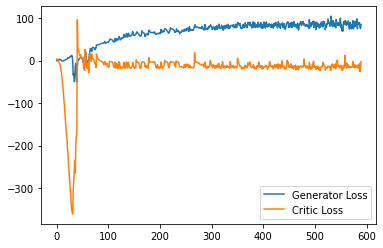

Step 11850: Generator loss: 88.61417007446289, critic loss: -10.902473865985868


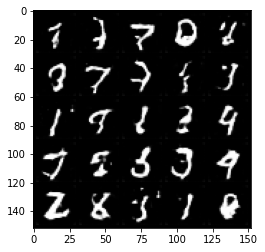

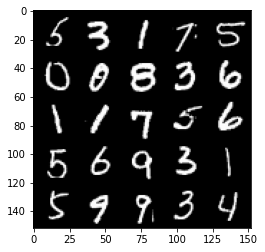

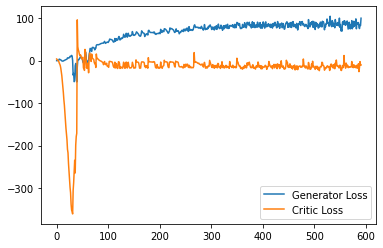

Step 11900: Generator loss: 90.02214584350585, critic loss: -15.824195418357851


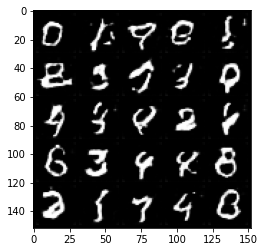

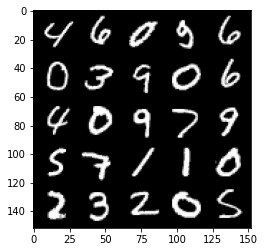

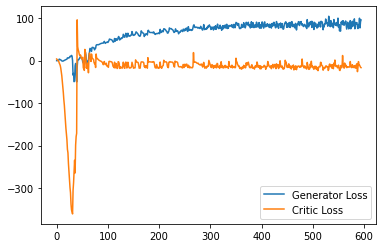

Step 11950: Generator loss: 78.69205589294434, critic loss: -12.203300402641299


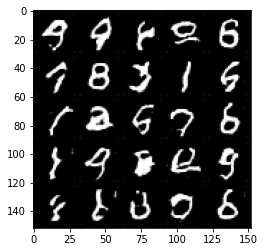

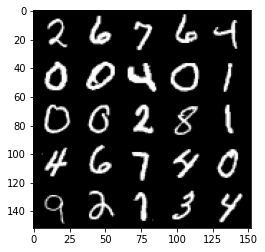

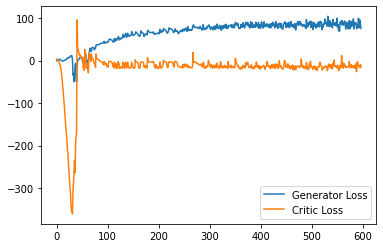

Step 12000: Generator loss: 87.44772216796875, critic loss: -15.542888013362887


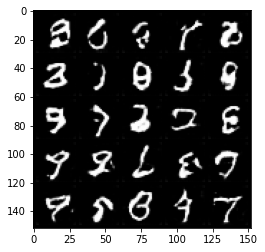

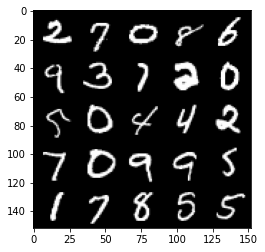

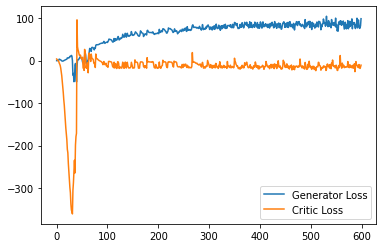

Step 12050: Generator loss: 83.79507820129395, critic loss: -15.063384902000433


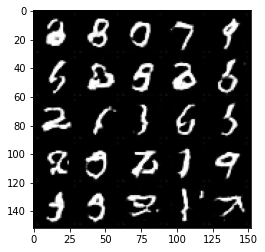

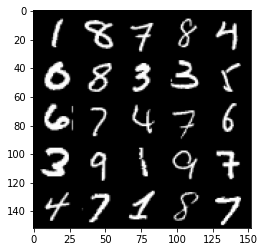

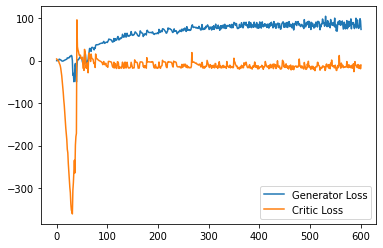

Step 12100: Generator loss: 88.3798843383789, critic loss: -14.013237155914306


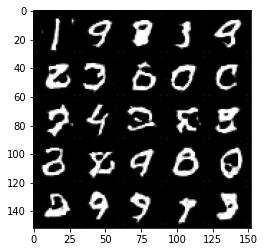

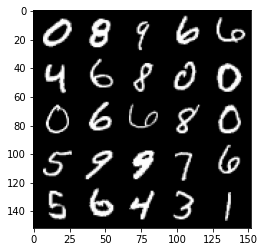

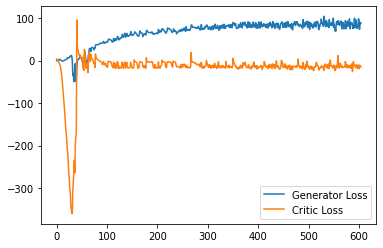

Step 12150: Generator loss: 89.56930633544921, critic loss: -10.269757680177689


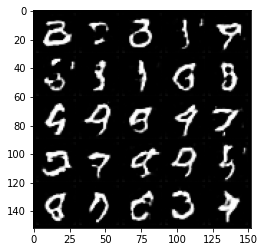

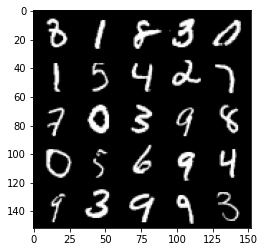

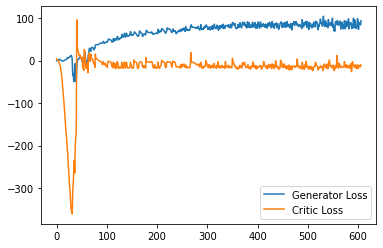

  0%|          | 0/469 [00:00<?, ?it/s]

Step 12200: Generator loss: 82.85491874694824, critic loss: -12.736257312297822


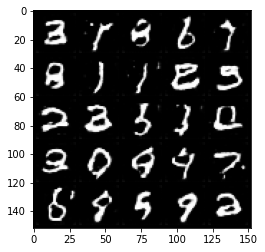

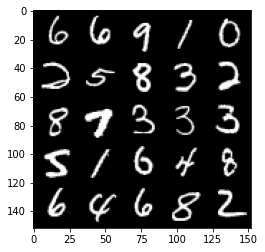

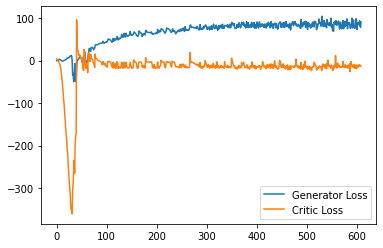

Step 12250: Generator loss: 79.77763320922851, critic loss: -13.598156771421435


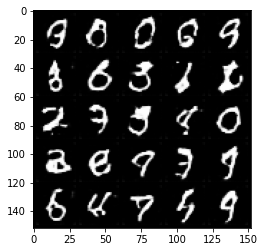

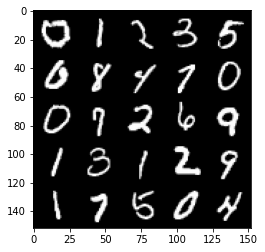

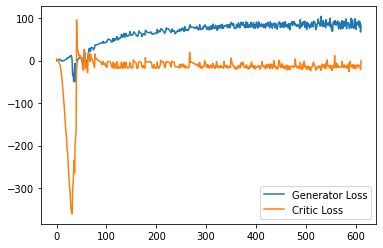

Step 12300: Generator loss: 86.31208770751954, critic loss: -9.05758197569847


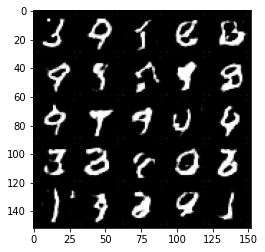

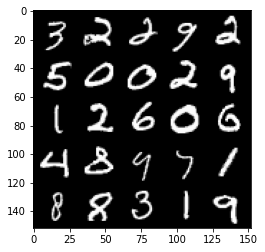

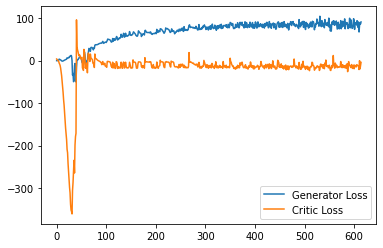

Step 12350: Generator loss: 83.1009072113037, critic loss: -15.026300167083741


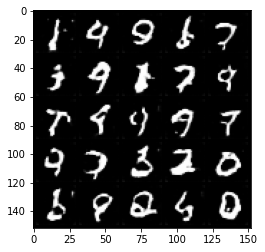

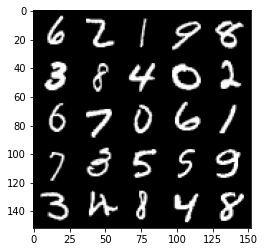

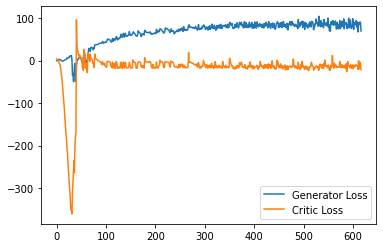

Step 12400: Generator loss: 89.01880012512207, critic loss: -11.02860705399513


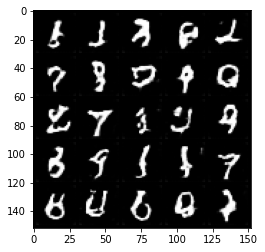

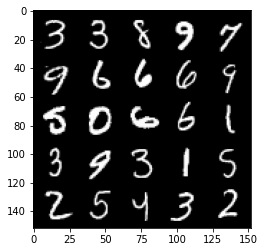

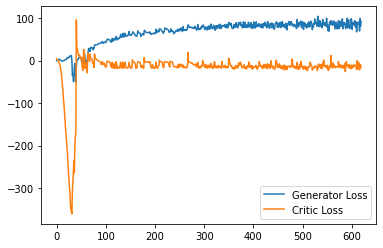

Step 12450: Generator loss: 89.22548667907715, critic loss: -14.847042794942855


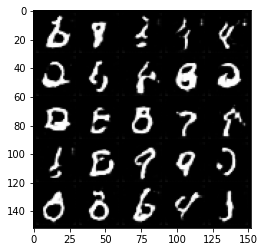

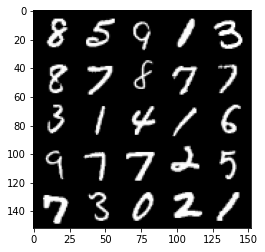

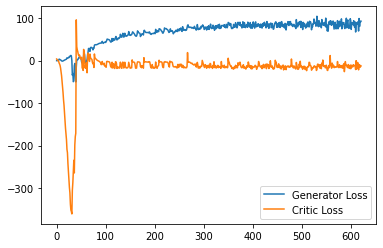

Step 12500: Generator loss: 95.49037216186524, critic loss: -7.0424798445701615


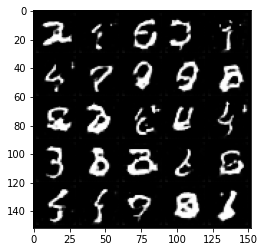

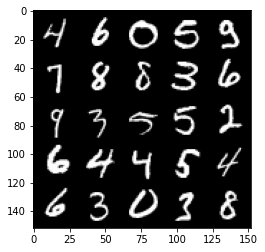

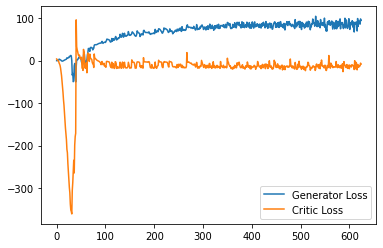

Step 12550: Generator loss: 82.69294593811036, critic loss: -13.958195254087443


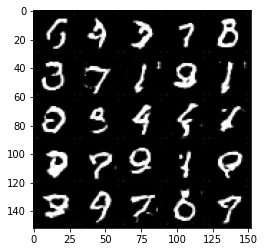

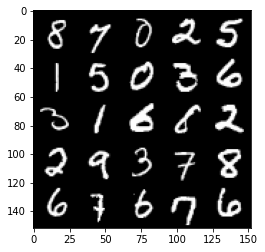

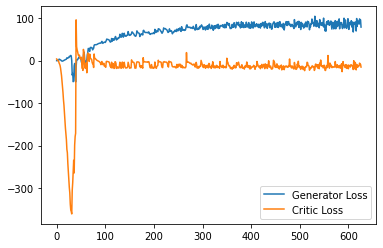

Step 12600: Generator loss: 87.60064483642579, critic loss: -10.753229521274568


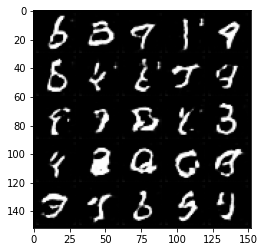

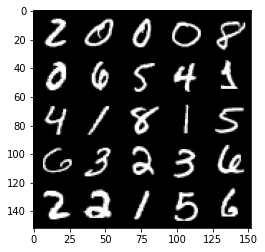

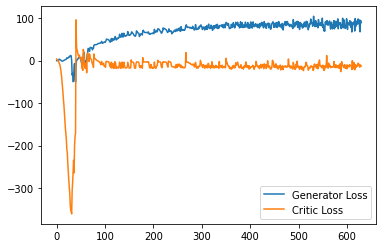

Step 12650: Generator loss: 89.69404151916504, critic loss: -18.535820476531978


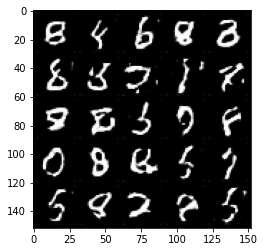

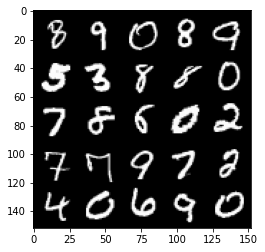

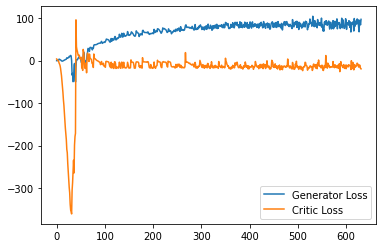

  0%|          | 0/469 [00:00<?, ?it/s]

Step 12700: Generator loss: 95.42404792785645, critic loss: -14.029962106227874


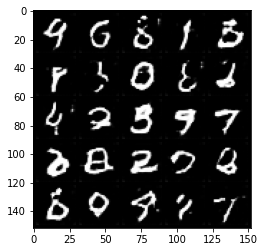

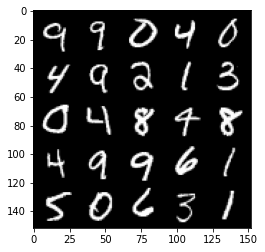

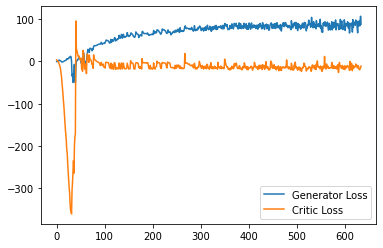

Step 12750: Generator loss: 92.08150207519532, critic loss: -11.509972231626517


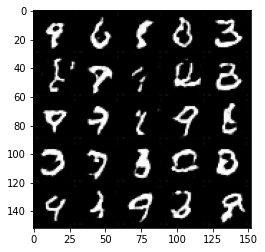

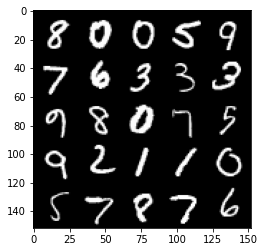

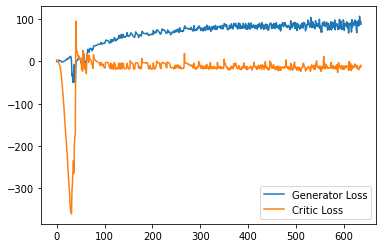

Step 12800: Generator loss: 89.15471496582032, critic loss: -2.040001352310179


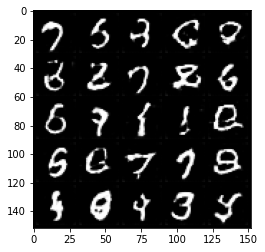

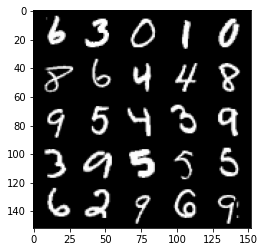

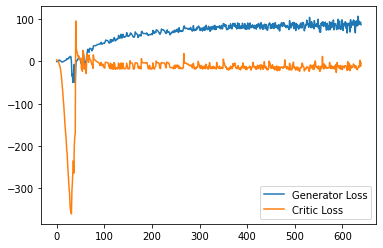

Step 12850: Generator loss: 82.83742752075196, critic loss: -14.341248466968537


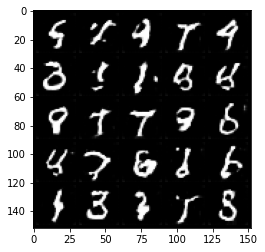

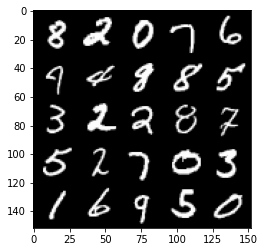

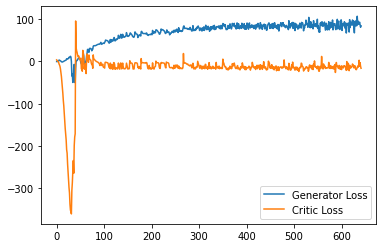

Step 12900: Generator loss: 90.3144995880127, critic loss: -8.524562123775482


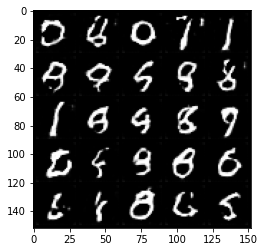

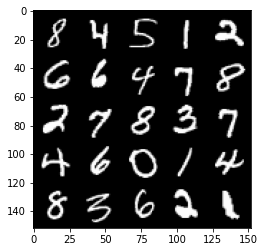

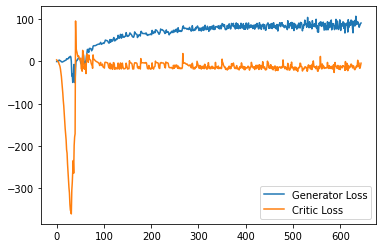

Step 12950: Generator loss: 86.58150772094727, critic loss: -13.72497734665871


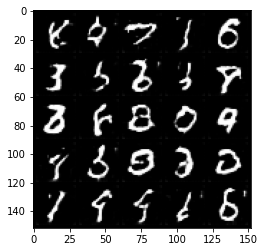

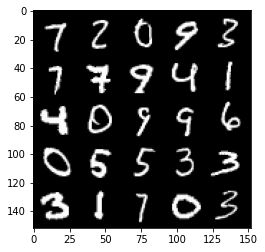

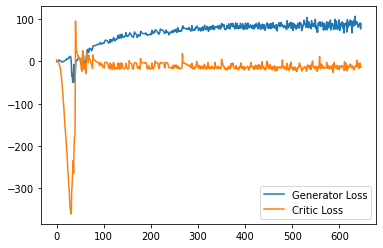

Step 13000: Generator loss: 90.99531295776367, critic loss: -5.508046809911729


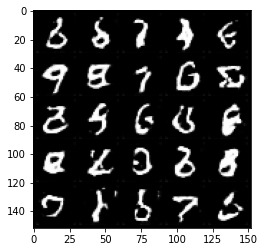

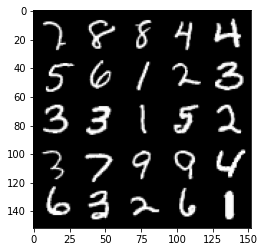

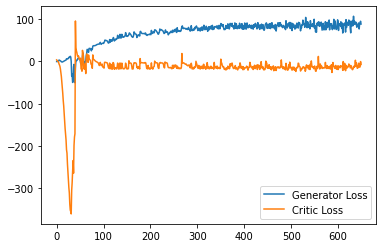

Step 13050: Generator loss: 87.16790214538574, critic loss: -11.178451088428496


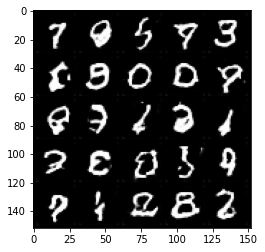

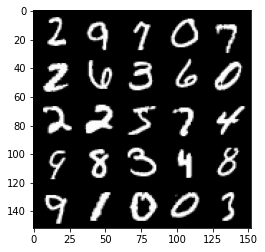

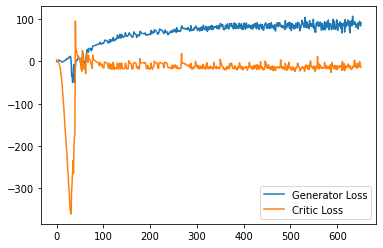

Step 13100: Generator loss: 89.44782852172851, critic loss: -11.129768971920013


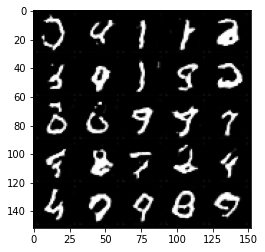

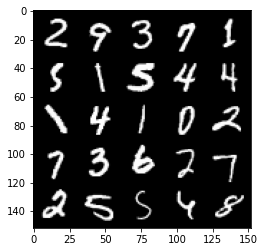

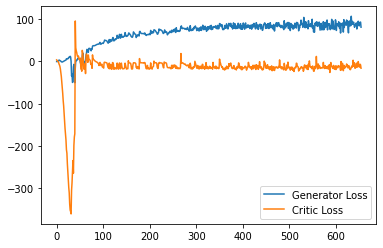

  0%|          | 0/469 [00:00<?, ?it/s]

Step 13150: Generator loss: 89.41227600097656, critic loss: -9.287983919620512


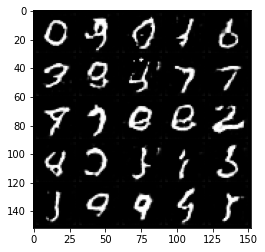

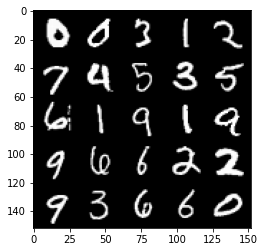

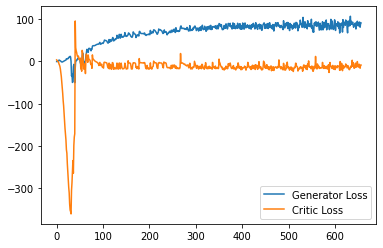

Step 13200: Generator loss: 89.91045852661132, critic loss: -11.641506355047232


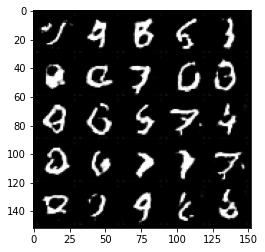

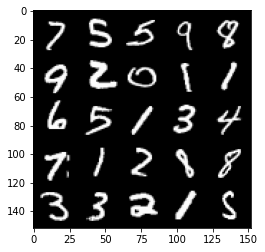

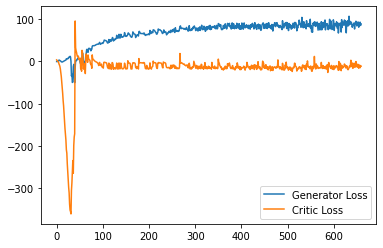

Step 13250: Generator loss: 93.44951843261718, critic loss: -13.21058392715454


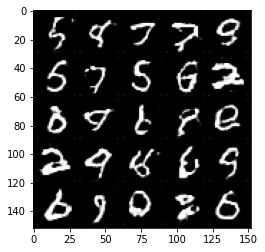

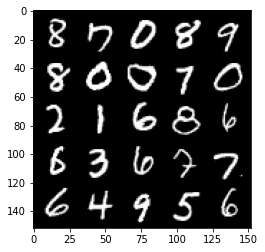

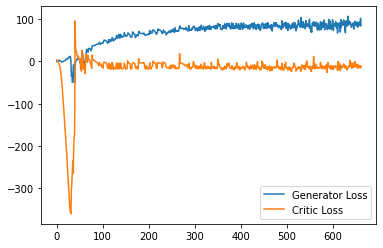

Step 13300: Generator loss: 91.30303466796875, critic loss: -10.652514332890512


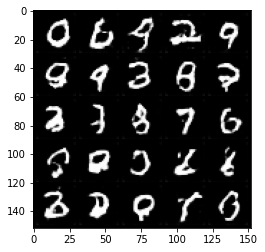

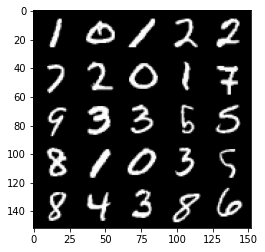

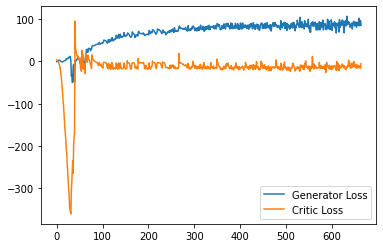

Step 13350: Generator loss: 93.14185440063477, critic loss: -11.017122244358061


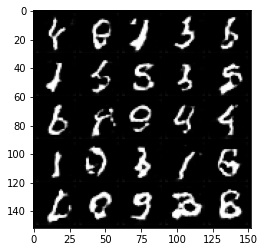

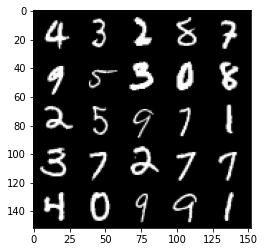

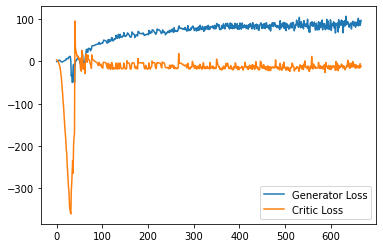

Step 13400: Generator loss: 90.49141258239746, critic loss: -11.307170595169069


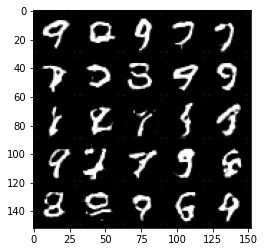

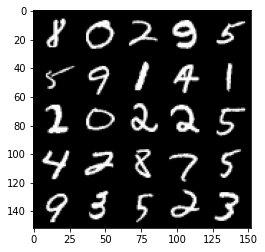

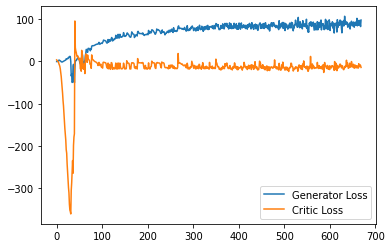

Step 13450: Generator loss: 81.88716995239258, critic loss: -13.003086663603783


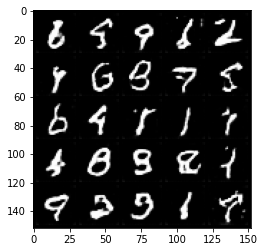

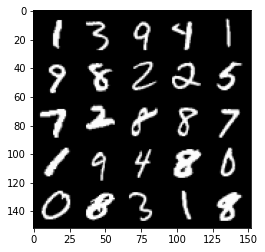

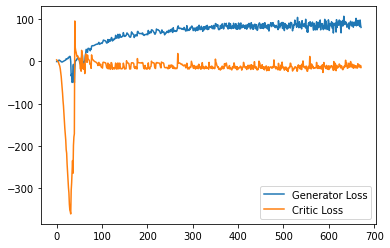

Step 13500: Generator loss: 89.48359786987305, critic loss: -20.081453415393828


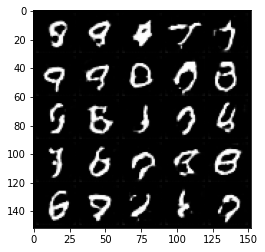

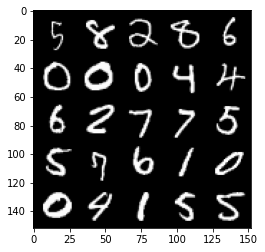

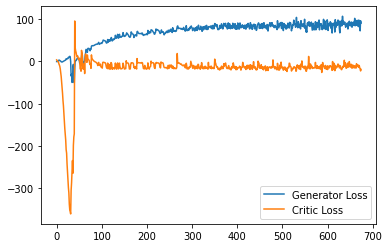

Step 13550: Generator loss: 85.39321197509766, critic loss: -12.233147905111315


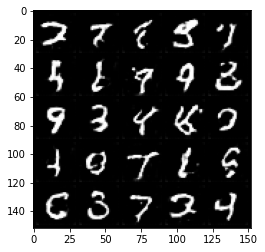

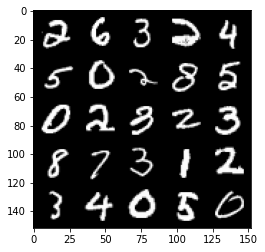

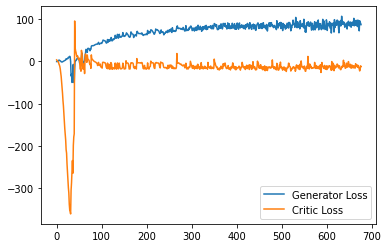

Step 13600: Generator loss: 92.69627883911133, critic loss: -10.843401635169984


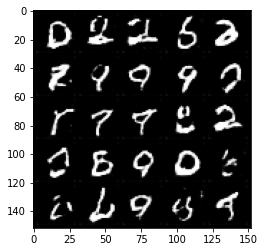

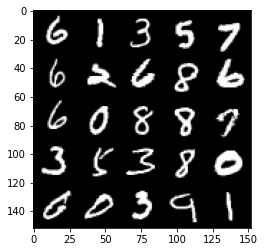

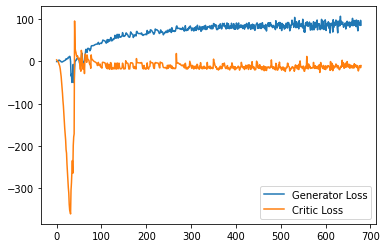

  0%|          | 0/469 [00:00<?, ?it/s]

Step 13650: Generator loss: 93.25920372009277, critic loss: -8.317259340763092


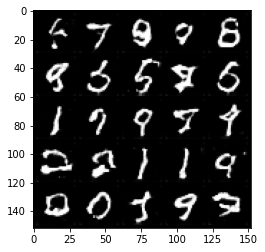

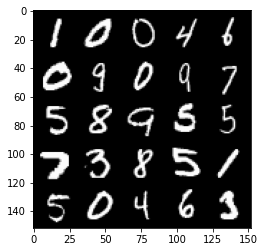

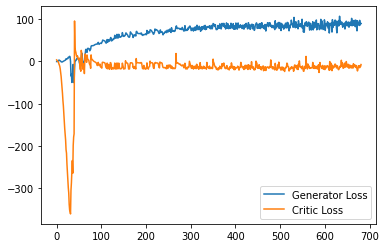

Step 13700: Generator loss: 86.07391174316406, critic loss: -8.149739094257354


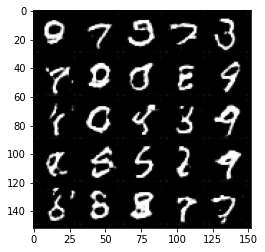

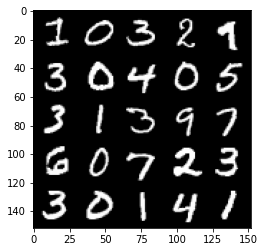

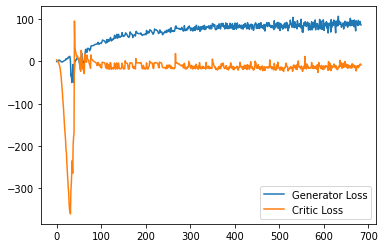

Step 13750: Generator loss: 89.25748268127441, critic loss: -7.943724397420883


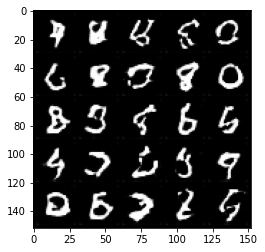

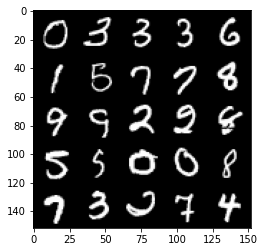

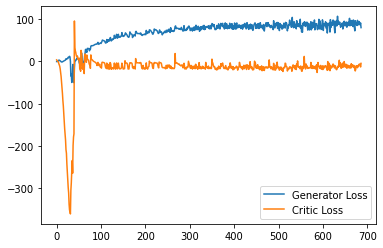

Step 13800: Generator loss: 93.01503219604493, critic loss: -4.842974652528764


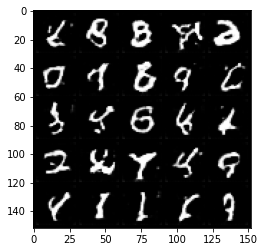

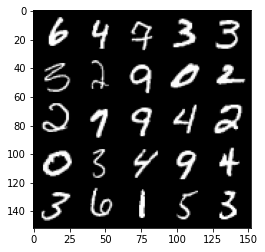

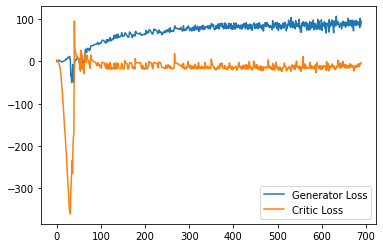

Step 13850: Generator loss: 89.25304649353028, critic loss: -12.573334138393403


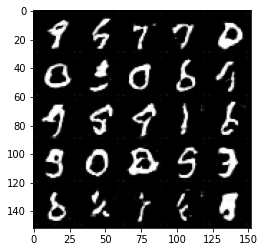

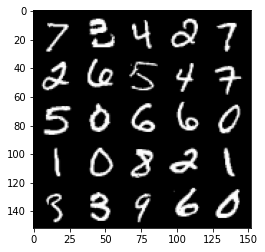

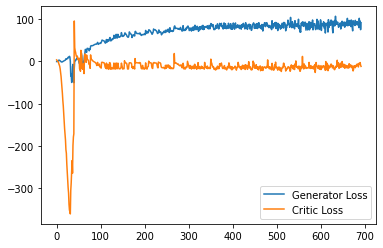

Step 13900: Generator loss: 77.2741567993164, critic loss: -18.20856638622284


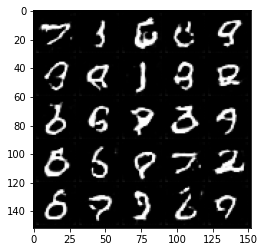

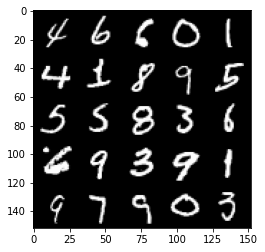

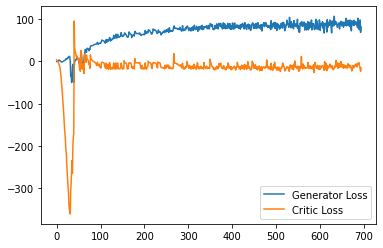

Step 13950: Generator loss: 88.82631927490235, critic loss: -14.782191829681397


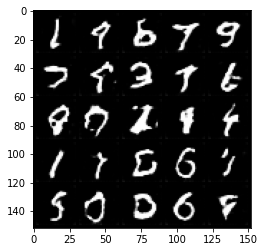

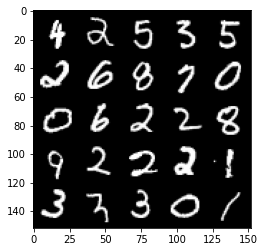

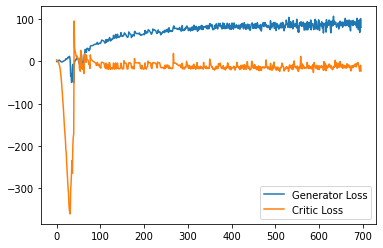

Step 14000: Generator loss: 84.20595832824706, critic loss: -14.072226797580724


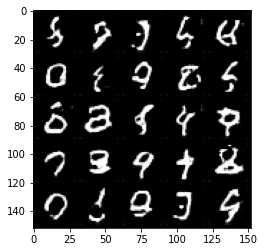

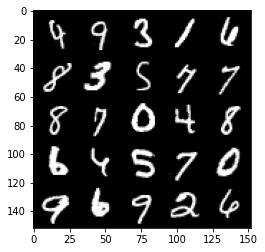

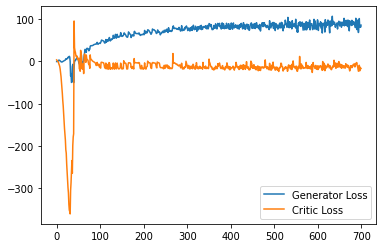

Step 14050: Generator loss: 88.26226837158202, critic loss: -15.16188637256622


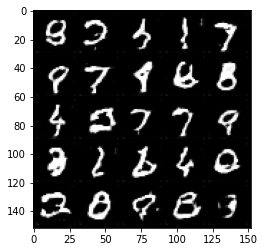

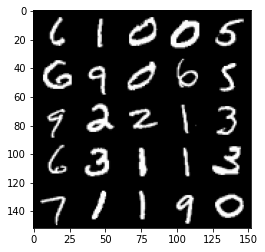

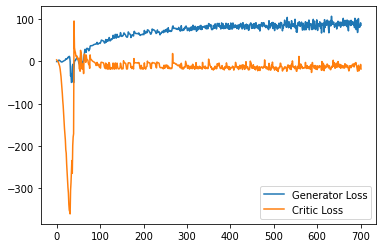

  0%|          | 0/469 [00:00<?, ?it/s]

Step 14100: Generator loss: 94.47134658813476, critic loss: -14.424767032146454


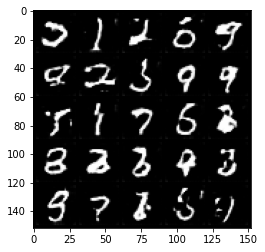

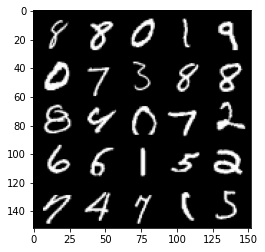

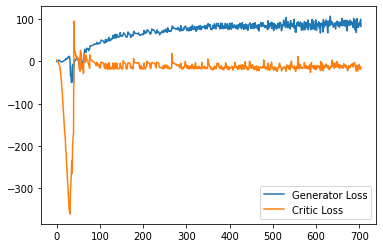

Step 14150: Generator loss: 89.80505264282226, critic loss: -17.680970388174057


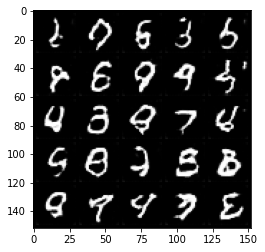

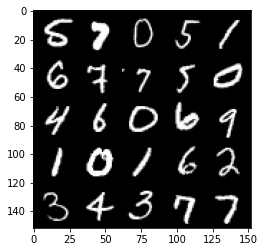

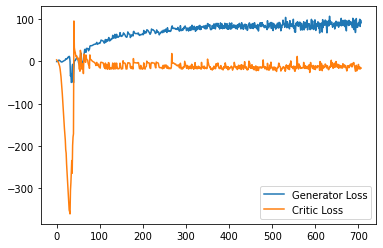

Step 14200: Generator loss: 89.80811279296876, critic loss: -17.47506046676636


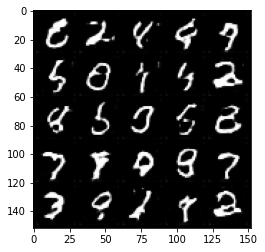

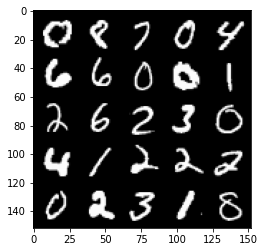

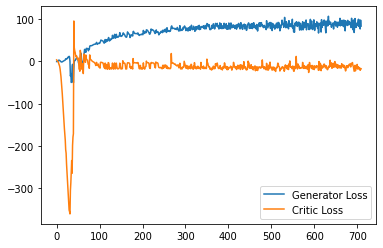

Step 14250: Generator loss: 89.12006233215332, critic loss: -16.635894669055933


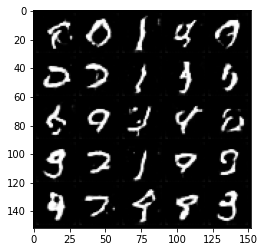

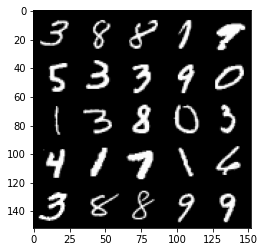

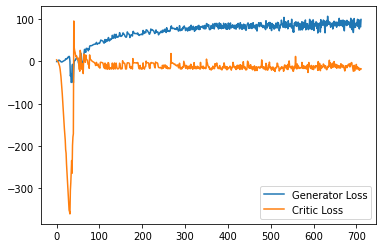

Step 14300: Generator loss: 91.96999099731445, critic loss: -11.409202656030654


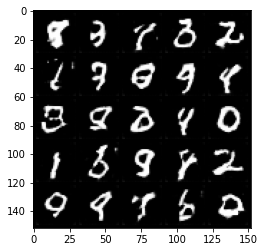

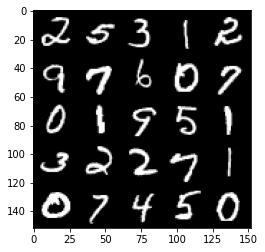

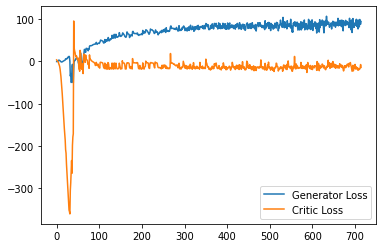

Step 14350: Generator loss: 90.5366438293457, critic loss: -12.727308180689816


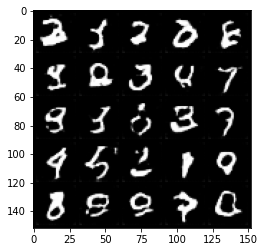

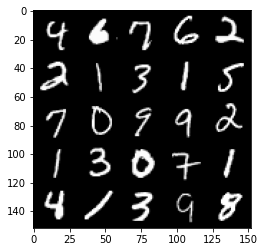

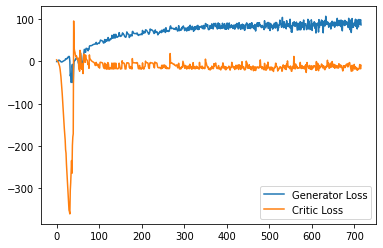

Step 14400: Generator loss: 87.55646598815918, critic loss: -14.718601577520374


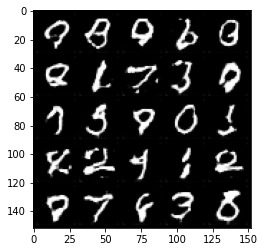

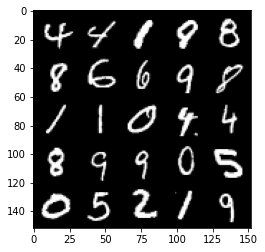

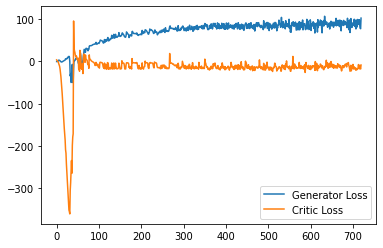

Step 14450: Generator loss: 84.89022743225098, critic loss: -25.466737639904025


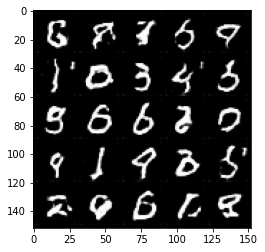

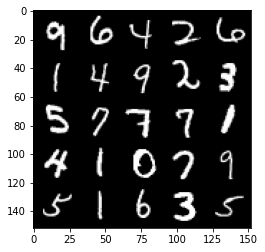

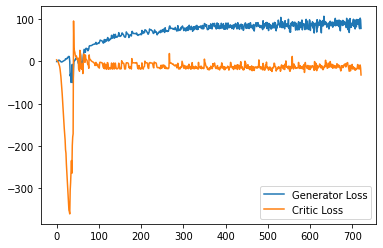

Step 14500: Generator loss: 96.29458618164062, critic loss: -12.553423159599303


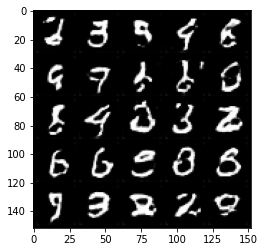

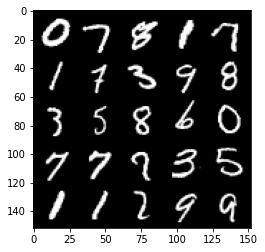

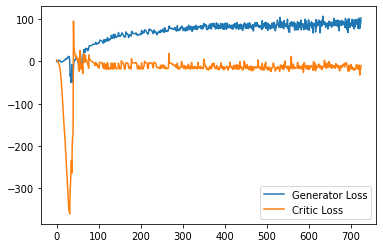

  0%|          | 0/469 [00:00<?, ?it/s]

Step 14550: Generator loss: 86.92205177307129, critic loss: -11.021694899082183


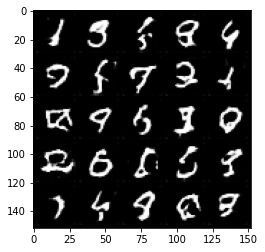

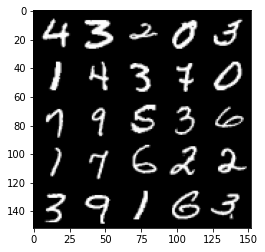

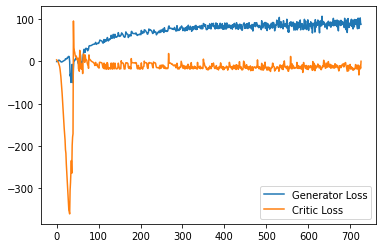

Step 14600: Generator loss: 93.13222381591797, critic loss: -9.861424293279647


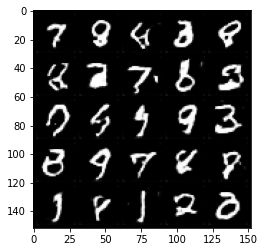

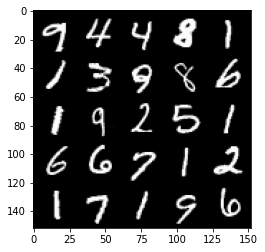

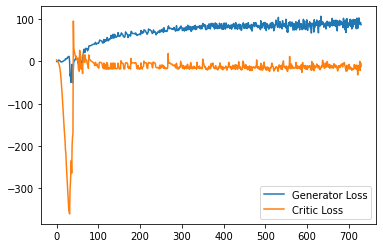

Step 14650: Generator loss: 97.33942169189453, critic loss: -11.513097171545024


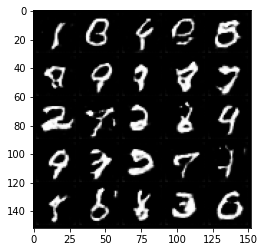

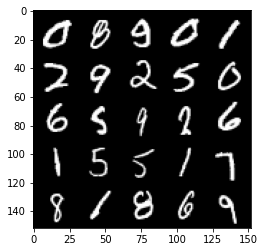

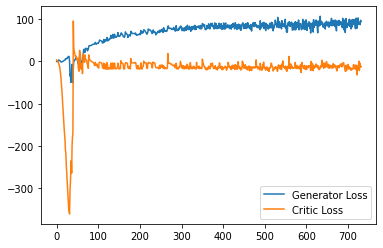

Step 14700: Generator loss: 92.63069122314454, critic loss: -12.623494658470152


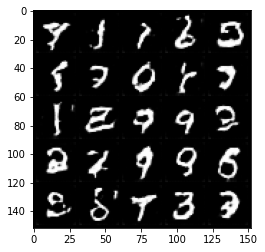

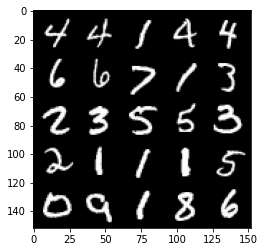

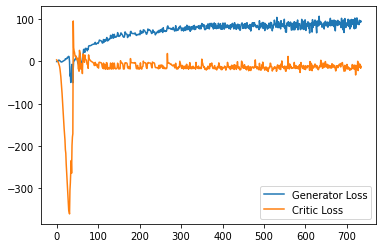

Step 14750: Generator loss: 90.43866485595703, critic loss: -12.594065835475924


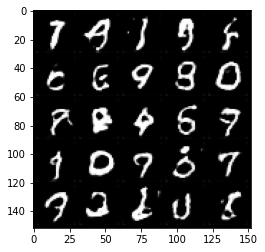

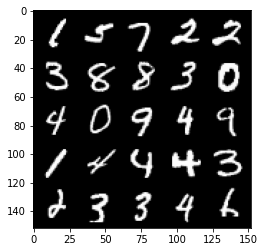

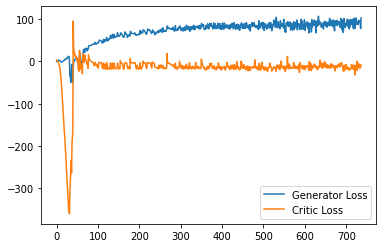

Step 14800: Generator loss: 94.5769204711914, critic loss: -8.757238482713701


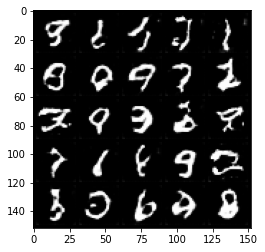

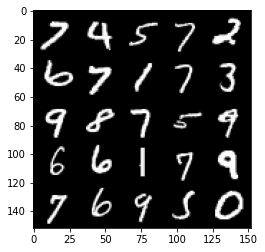

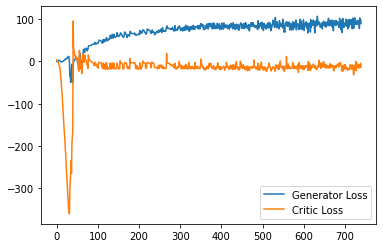

Step 14850: Generator loss: 93.88714332580567, critic loss: -16.77643575143814


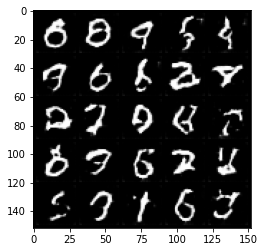

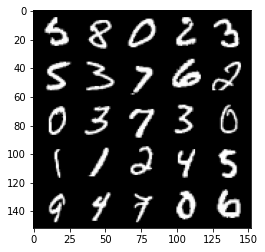

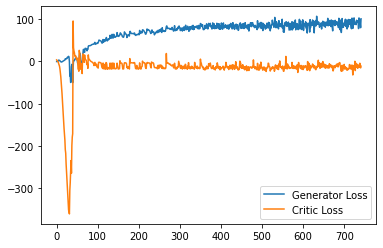

Step 14900: Generator loss: 87.700263671875, critic loss: -10.722657155990603


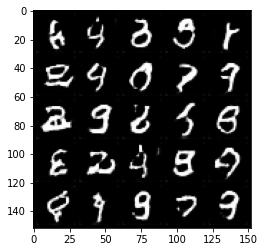

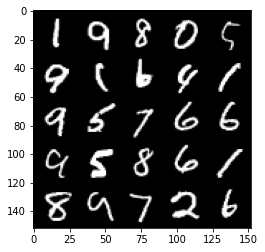

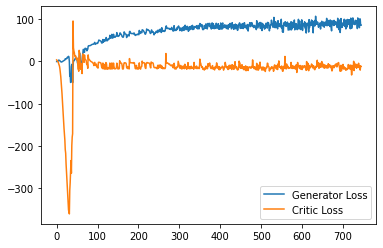

Step 14950: Generator loss: 91.05068367004395, critic loss: -11.605783188104626


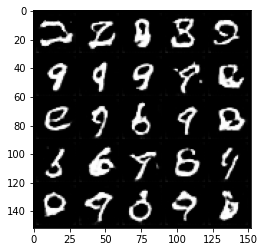

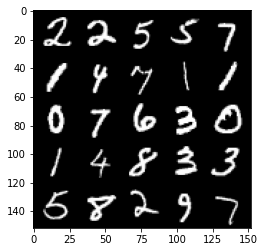

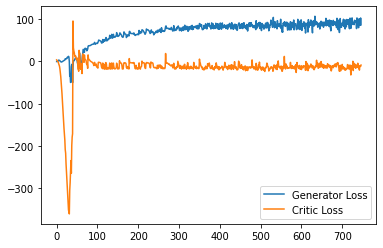

Step 15000: Generator loss: 75.75496376037597, critic loss: -21.879910609960557


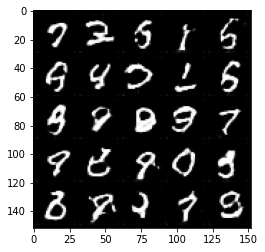

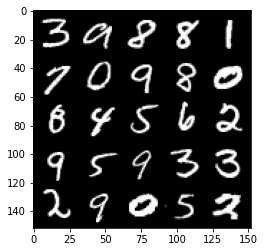

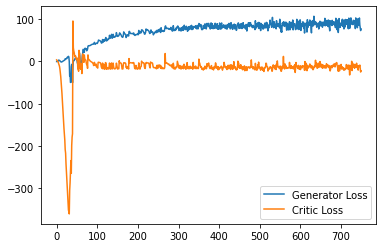

  0%|          | 0/469 [00:00<?, ?it/s]

Step 15050: Generator loss: 95.58296485900878, critic loss: -16.249869791746136


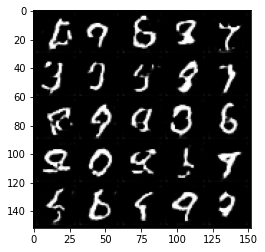

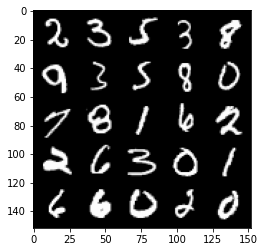

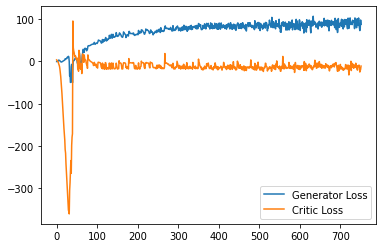

Step 15100: Generator loss: 77.31303260803223, critic loss: -16.777440078496934


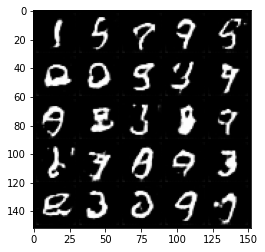

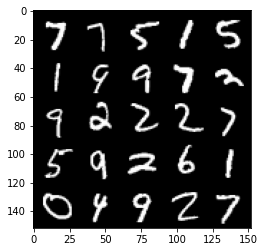

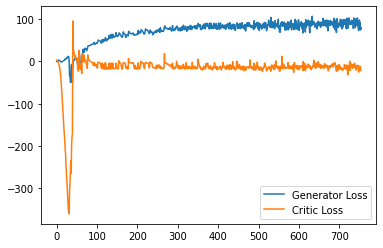

Step 15150: Generator loss: 83.98996551513672, critic loss: -18.497279873847962


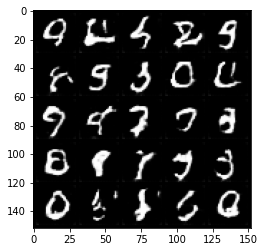

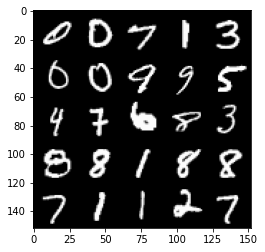

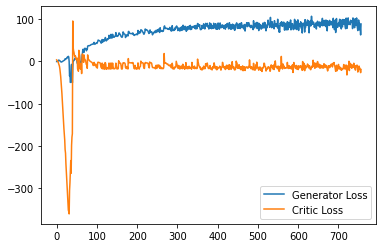

Step 15200: Generator loss: 88.79397491455079, critic loss: -14.03128625059128


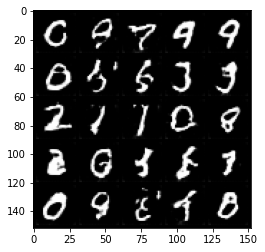

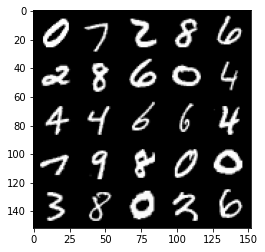

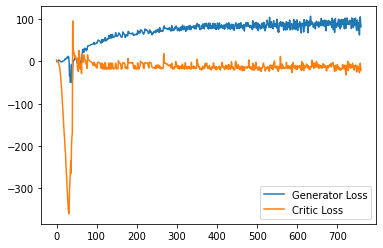

Step 15250: Generator loss: 91.46838912963867, critic loss: -18.693592229366303


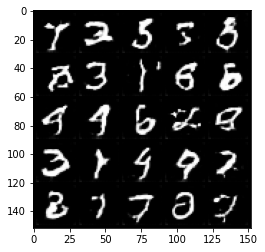

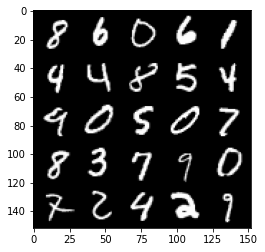

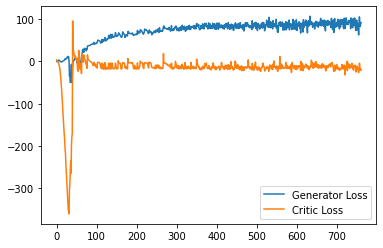

In [ ]:
.m.......import matplotlib.pyplot as plt

cur_step = 0
generator_losses = []
critic_losses = []
for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        mean_iteration_critic_loss = 0
        for _ in range(crit_repeats):
            ### Update critic ###
            crit_opt.zero_grad()
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            crit_fake_pred = crit(fake.detach())
            crit_real_pred = crit(real)

            epsilon = torch.rand(len(real), 1, 1, 1, device=device, requires_grad=True)
            gradient = get_gradient(crit, real, fake.detach(), epsilon)
            gp = gradient_penalty(gradient)
            crit_loss = get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda)

            # Keep track of the average critic loss in this batch
            mean_iteration_critic_loss += crit_loss.item() / crit_repeats
            # Update gradients
            crit_loss.backward(retain_graph=True)
            # Update optimizer
            crit_opt.step()
        critic_losses += [mean_iteration_critic_loss]

        ### Update generator ###
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        crit_fake_pred = crit(fake_2)
        
        gen_loss = get_gen_loss(crit_fake_pred)
        gen_loss.backward()

        # Update the weights
        gen_opt.step()

        # Keep track of the average generator loss
        generator_losses += [gen_loss.item()]

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            crit_mean = sum(critic_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(critic_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Critic Loss"
            )
            plt.legend()
            plt.show()

        cur_step += 1